In [1]:
(
    1 + 0
)  # Utility cell. Sometimes "Jupyter" skipps the first cell when running all cells. Especially after a restart.

1

In [2]:
(
    1 + 1
)  # Utility cell. Sometimes "Jupyter" skipps the first cell when running all cells. Especially after a restart.

2

In [3]:
print(f"N{1+2} utility cell running...")

N3 utility cell running...


# Target: Correlation of GDP with full embeddings (Rigde regression)

In [4]:
# Resolve the path to the 'src' folder with helper functions
import config_notebooks

PYTHONPATH: C:\Users\Admin\Documents\Univer\MASTER THESIS IDEAS\Flavio Pinehro\11_MasterProject\src;C:\Users\Admin\Documents\Univer\MASTER THESIS IDEAS\Flavio Pinehro\11_MasterProject\src\imports


In [ ]:
from n15_import import *

os.getcwd():
c:\Users\Admin\Documents\Univer\MASTER THESIS IDEAS\Flavio Pinehro\11_MasterProject\notebooks
input_file_location:
..\data\07_sindices_processed
output_file_location:
..\data\14_SAGE_gold
vectordb_location:
..\data\10_chromadb
optuna_study_location:
..\data\11_optuna_studies


In [ ]:
# Resolve the path to the 'src' folder with helper functions
import config_notebooks
from importlib import reload

# Import the module and reload it
import n15_import_reload

reload(n15_import_reload)

# Re-import the functions from the reloaded module
from n15_import_reload import *

os.getcwd():
c:\Users\Admin\Documents\Univer\MASTER THESIS IDEAS\Flavio Pinehro\11_MasterProject\notebooks
input_file_location:
..\data\07_sindices_processed
output_file_location:
..\data\14_SAGE_gold
vectordb_location:
..\data\10_chromadb
os.getcwd():
c:\Users\Admin\Documents\Univer\MASTER THESIS IDEAS\Flavio Pinehro\11_MasterProject\notebooks
input_file_location:
..\data\07_sindices_processed
output_file_location:
..\data\14_SAGE_gold
vectordb_location:
..\data\10_chromadb


# Impoting ingested socio-economic indices

In [7]:
input_file_name = "sindices.parquet"
# columns = []
# categorical_columns = ["country_code"]
# default_dtype = "str"
sindices_df = read_hs92_parquet_data(
    file_location=input_file_location,
    file_name=input_file_name,
    # columns=columns,
    # categorical_columns=categorical_columns,
    f_convert_dtype=False,
    # default_dtype=default_dtype,
)

In [8]:
df_stats(sindices_df, "sindices_df")

['sindices_df', <class 'pandas.core.frame.DataFrame'>]
shape:
(1152, 15)
data types:
country_id              int16
country_code           object
country_name           object
year                    int16
log_gdp_per_capita    float64
ECI_18                float64
log_population        float64
gini                  float64
gini_disp             float64
hci                   float64
hdi                   float64
le                    float64
eys                   float64
mys                   float64
gnipc                 float64
dtype: object
columns:
['country_id', 'country_code', 'country_name', 'year', 'log_gdp_per_capita', 'ECI_18', 'log_population', 'gini', 'gini_disp', 'hci', 'hdi', 'le', 'eys', 'mys', 'gnipc']
       country_id     year  log_gdp_per_capita    ECI_18  log_population  \
count    1,152.00 1,152.00            1,152.00  1,152.00        1,152.00   
mean       440.19 2,015.50                8.62  0.000000           16.52   
std        250.36     2.29                1.4

# Importing ingested export data

At this stage we expect the x_cp data set to have data for 144 countries.
<br>We can verify this by subsetting to the "clean_countries_ids" collection, which is available in the dumped_data.

In [9]:
initial_input_location = input_file_location

input_file_location = os.path.join("..", "data", "03_preprocessed")
input_file_name = "X_cp.parquet"
x_cp = read_hs92_parquet_data(
    input_file_location, input_file_name, f_convert_dtype=False
)

input_file_location = initial_input_location

In [10]:
df_stats(x_cp, "x_cp")

['x_cp', <class 'pandas.core.frame.DataFrame'>]
shape:
(1398528, 4)
data types:
country_id                int16
product_id                int16
year                      int16
average_export_value    float64
dtype: object
columns:
['country_id', 'product_id', 'year', 'average_export_value']
        country_id   product_id         year  average_export_value
count 1,398,528.00 1,398,528.00 1,398,528.00          1,398,528.00
mean        440.19     1,270.10     2,015.50         93,049,051.28
std         250.26       358.53         2.29      1,433,348,437.14
min           8.00       650.00     2,012.00                  0.00
25%         221.00       961.00     2,013.75                  0.00
50%         427.00     1,270.50     2,015.50            136,205.50
75%         655.00     1,585.00     2,017.25          4,705,561.92
max         894.00     1,892.00     2,019.00    359,983,930,717.33
Total memory usage: 19579524 bytes


In [11]:
x_cp.sample(5)

,country_id,product_id,year,average_export_value
1161890,724,1436,2014,"128,945,459.67"
1363233,858,1102,2013,"3,998,188.00"
548604,364,1254,2016,"38,350.33"
618623,398,1511,2019,"328,646.33"
1084559,694,1481,2019,"27,381.00"


In [12]:
initial_input_location = input_file_location

input_file_location = os.path.join("..", "data", "02_ingested")
input_file_name = "product_hierarchy.parquet"
product_df = read_hs92_parquet_data(
    input_file_location, input_file_name, f_convert_dtype=False
)

input_file_location = initial_input_location

In [13]:
product_df.sample(10)

,product_id,product_code,product_name,product_level,top_parent_id,product_id_hierarchy
5026,8676,820412,"Wrenches, hand-operated, adjustable",6,5,5.180.1596.8676
1953,5603,200600,"Fruits, nuts, peels, in sugar",6,2,2.119.820.5603
3792,7442,551312,"Woven twill <85% polyester&cotton, <170g/m2 un...",6,1,1.154.1289.7442
1857,5507,151912,Oleic acid,6,2,2.114.791.5507
1527,5177,050100,Human hair,6,2,2.104.683.5177
5278,8928,842860,"Teleferiques, chair-lifts, ski-lifts",6,8,8.182.1646.8928
3855,7505,560122,"Wadding, manmade fibres, not sanitary",6,1,1.155.1293.7505
5008,8658,820120,Forks,6,5,5.180.1593.8658
1962,5612,200850,"Apricots, otherwise preserved",6,2,2.119.822.5612
314,857,2507,Kaolin,4,4,4.124.857


In [14]:
df_stats(product_df, "product_df")

['product_df', <class 'pandas.core.frame.DataFrame'>]
shape:
(6390, 6)
data types:
product_id               int16
product_code            object
product_name            object
product_level            int64
top_parent_id            int16
product_id_hierarchy    object
dtype: object
columns:
['product_id', 'product_code', 'product_name', 'product_level', 'top_parent_id', 'product_id_hierarchy']
       product_id  product_level  top_parent_id
count    6,390.00       6,390.00       6,390.00
mean     6,180.37           5.54           4.49
std      2,900.14       0.922409           2.67
min      1.000000       1.000000       1.000000
25%      5,247.25           6.00           2.00
50%      6,844.50           6.00           5.00
75%      8,441.75           6.00           6.00
max     10,039.00           6.00          10.00
Total memory usage: 1459759 bytes


In [15]:
prod_hierarchy_df = product_df[
    [
        "product_id",
        "product_code",
        "product_level",
        "top_parent_id",
        "product_id_hierarchy",
    ]
]

In [16]:
x_cp = x_cp.merge(prod_hierarchy_df, on="product_id", how="left")

In [17]:
df_stats(x_cp, "x_cp")

['x_cp', <class 'pandas.core.frame.DataFrame'>]
shape:
(1398528, 8)
data types:
country_id                int16
product_id                int16
year                      int16
average_export_value    float64
product_code             object
product_level             int64
top_parent_id             int16
product_id_hierarchy     object
dtype: object
columns:
['country_id', 'product_id', 'year', 'average_export_value', 'product_code', 'product_level', 'top_parent_id', 'product_id_hierarchy']
        country_id   product_id         year  average_export_value  \
count 1,398,528.00 1,398,528.00 1,398,528.00          1,398,528.00   
mean        440.19     1,270.10     2,015.50         93,049,051.28   
std         250.26       358.53         2.29      1,433,348,437.14   
min           8.00       650.00     2,012.00                  0.00   
25%         221.00       961.00     2,013.75                  0.00   
50%         427.00     1,270.50     2,015.50            136,205.50   
75%         655.

# Implementing single-year (MoR style) approach for training GraphSAGE model

## Running initial tuning-training-evaluation loop

### Using following topological features for the model:<br>"nd" - normalized degrees (in-degree, out-degree);<br>"cd" - centrality degree ((in + out degree) / num_nodes);<br>"ht" - HITS scores (hits, hub, authority);<br>"pr" - PageRank scores.
### Using following dimensional features for the model:<br>"ph" - product hierarchy.

While running the initial hyperparameter tuning loop, we expect some countries embeddings to be considered as outliers and thus we will remove them from the training set. But removing countries from the dataset will require to repeat this step of tuning hyperparameters for the new set of countries.

In [18]:
dumped_data = restore_cache(input_file_location=input_file_location)
num_countries = dumped_data["num_countries"]
location_df = dumped_data["location_df"]
correlations_df = dumped_data["target_correlations_df"]
rolling_exports_years = dumped_data["rolling_exports_years"]
rolling_exports_years = [*rolling_exports_years]
rolling_exports_years.sort()

data restored:['rolling_exports_years', 'clean_countries_ids', 'target_correlations_df', 'location_df', 'num_countries']


In [19]:
correlations_df

,year,eci_18__log_gdp_pcap
0,2012,0.741711
1,2013,0.732153
2,2014,0.738466
3,2015,0.745452
4,2016,0.777236
5,2017,0.789686
6,2018,0.785940
7,2019,0.797133


In [20]:
rolling_exports_years

[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019]

In the following one cell, I am just checking how the model name will look like with features encoded in the model name.

In [21]:
prefix = "sage-mor"
# Define topological features
top_features = ["nd", "cd", "ht", "pr", "ph"]
# Define target score
target_score = "corr_sye_u_loss"
year = rolling_exports_years[0]  # For current step we use only one year
year = 2019
f_init = True
# fixed_epochs = 8

study_name = get_optuna_study_name(
    prefix=prefix,
    top_features=top_features,
    target_score=target_score,
    year=year,
    f_init=f_init,
    # fixed_epochs=fixed_epochs,
)
study_name

'sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2019-init'

At this step I consider that previous file "n14_GraphSAGE_mor_training_nd-cd-ht-pr_features+dims.ipynb" has been executed.
If so - it is not strictly necessary to run tuning steps again, only if there is an interest and intention to try to improve slightly the results.
In general the model of current file and the one mentioned previously as "previous" is the same.

In [22]:
prefix

'sage-mor'

In [23]:
dump_file_name = (
    f"{prefix}-{'-'.join(top_features)}-t_{target_score}-staged_kwargs.pickle"
)
print(dump_file_name)

sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-staged_kwargs.pickle


In [24]:
# dump_file_name = f"{''.join([prefix, '-fe_', str(fixed_epochs)])}-{'-'.join(top_features)}-t_{target_score}-staged_kwargs.pickle"
init_dumped = dumped_data
dumped_data = restore_cache(
    input_file_location=output_file_location,
    input_file_name=dump_file_name,
)
if dumped_data is None:
    dump_file_name = (
        f"{prefix}-{'-'.join(top_features)}-t_{target_score}-staged_kwargs.pickle"
    )
    dumped_data = restore_cache(
        input_file_location=output_file_location,
        input_file_name=dump_file_name,
    )
    if dumped_data is None:
        dumped_data = init_dumped
    else:
        dumped_data.pop("init_studies_by_year", None)
    print(dumped_data.keys())

data restored:['x_cp', 'sindices_df', 'target_correlations_df', 'location_df', 'num_countries', 'rolling_exports_years', 'clean_countries_ids', 'init_studies_by_year', 'reg_scores_df', 'full_correlations_df', 'umap_projections_df']


In [25]:
# dumped_data.pop("init_studies_by_year", None)

In [26]:
print(dump_file_name)

sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-staged_kwargs.pickle


In [27]:
f_continue_tuning = False
init_studies_by_year = dumped_data.get("init_studies_by_year", None)
if init_studies_by_year is None:
    f_continue_tuning = True
else:
    display(get_study_trials_df(init_studies_by_year[2012], f_verbose=True))

Study name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2012-init
Best trial Number: 5. Value: 0.08127. Duration: 0:00:13.161359 seconds


,value,duration
5,0.081274,0 days 00:00:13.161359
7,0.070637,0 days 00:00:26.104129
3,0.028795,0 days 00:00:23.501197
4,0.006968,0 days 00:00:20.524003
6,0.005443,0 days 00:00:20.375425
0,NaN,0 days 00:00:08.150096
1,NaN,0 days 00:00:07.631276
2,NaN,0 days 00:00:07.302527


### Now fetching the previous study result into study_hyperparameters

For arbitrary or forceful running tuning trials set the 'f_continue_tuning' to True

In [28]:
f_continue_tuning = True

In [29]:
if f_continue_tuning:
    study_hyperparameters = None
    storage_uri = get_optuna_storage_uri(
        study_name=study_name,
        os_path=os.path,
        optuna_study_location=optuna_study_location,
    )
    try:
        study = optuna.load_study(study_name=study_name, storage=storage_uri)

        study_hyperparameters = study.best_params
    except Exception as e:
        print(f"Study '{study_name}' not found\n")

    print("study_hyperparameters:", study_hyperparameters)
    pass

Optuna db name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2019-init.db
Optuna storage location:
	sqlite:///c:/Users/Admin/Documents/Univer/MASTER THESIS IDEAS/Flavio Pinehro/11_MasterProject/data/11_optuna_studies/sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2019-init.db
study_hyperparameters: {'num_epochs': 47, 'lr': 0.0015696396388661157, 'lambda_temporal': 0.9218742350231168, 'retain_graph': False, 'hidden_feats': 23, 'out_feats': 18, 'dropout': 0.194338644844741, 'num_layers': 2, 'agg_layer_0': 'mean', 'agg_layer_1': 'gcn', 'gru_num_layers': 1, 'use_relu': False, 'use_random_noise': True, 'node_type_encoding': 'none'}


In [30]:
# if f_continue_tuning:
#     if study_hyperparameters is None:
#         previous_model_study_name = get_optuna_study_name(
#             prefix=prefix,
#             top_features=["nd", "cd", "ht", "pr"],
#             target_score=target_score,
#             year=year,
#             f_init=f_init,
#         )
#         print(previous_model_study_name)
#         previous_storage_uri = get_optuna_storage_uri(
#             study_name=previous_model_study_name,
#             os_path=os.path,
#             optuna_study_location=optuna_study_location,
#         )

#         try:
#             previous_model_study = optuna.load_study(
#                 study_name=previous_model_study_name, storage=previous_storage_uri
#             )

#             study_hyperparameters = previous_model_study.best_params
#         except Exception as e:
#             print(f"Study '{previous_model_study_name}' not found\n")

#         print("study_hyperparameters:", study_hyperparameters)

In [31]:
x_cp["product_level"].unique()

array([4], dtype=int64)

### Estimating the graph statistics

In [32]:
top_features = ["nd", "cd", "pr"]
use_random_noise = False
f_debug = False
n_years = None

graph_statistics_all_years = get_graph_statistics(
    rolling_exports_years=rolling_exports_years,
    n_years=n_years,
    x_cp=x_cp,
    num_countries=num_countries,
    f_debug=f_debug,
    use_random_noise=use_random_noise,
    top_features=top_features,
)

In [33]:
df_stats(graph_statistics_all_years, "graph_statistics_all_years")

['graph_statistics_all_years', <class 'pandas.core.frame.DataFrame'>]
shape:
(1152, 8)
data types:
nd_in          float32
nd_out         float32
nd_in_norm     float32
nd_out_norm    float32
cd             float32
pr             float32
country_id       int16
year             int64
dtype: object
columns:
['nd_in', 'nd_out', 'nd_in_norm', 'nd_out_norm', 'cd', 'pr', 'country_id', 'year']
         nd_in   nd_out  nd_in_norm  nd_out_norm       cd       pr  \
count 1,152.00 1,152.00    1,152.00     1,152.00 1,152.00 1,152.00   
mean      1.42     7.10    0.250000     1.000000 0.972768 0.000726   
std       2.45     0.00    0.433201         0.00 0.094374 0.000063   
min       0.00     7.10        0.00     1.000000 0.918306 0.000689   
25%       0.00     7.10        0.00     1.000000 0.918306 0.000689   
50%       0.00     7.10        0.00     1.000000 0.918306 0.000689   
75%       1.42     7.10    0.250000     1.000000 0.972769 0.000726   
max       5.67     7.10    1.000000     1.000000   

In [34]:
df_stats(sindices_df, "sindices_df")

['sindices_df', <class 'pandas.core.frame.DataFrame'>]
shape:
(1152, 15)
data types:
country_id              int16
country_code           object
country_name           object
year                    int16
log_gdp_per_capita    float64
ECI_18                float64
log_population        float64
gini                  float64
gini_disp             float64
hci                   float64
hdi                   float64
le                    float64
eys                   float64
mys                   float64
gnipc                 float64
dtype: object
columns:
['country_id', 'country_code', 'country_name', 'year', 'log_gdp_per_capita', 'ECI_18', 'log_population', 'gini', 'gini_disp', 'hci', 'hdi', 'le', 'eys', 'mys', 'gnipc']
       country_id     year  log_gdp_per_capita    ECI_18  log_population  \
count    1,152.00 1,152.00            1,152.00  1,152.00        1,152.00   
mean       440.19 2,015.50                8.62  0.000000           16.52   
std        250.36     2.29                1.4

In [37]:
df_stats(correlations_df, "correlations_df")

['correlations_df', <class 'pandas.core.frame.DataFrame'>]
shape:
(8, 2)
data types:
year                      int16
eci_18__log_gdp_pcap    float64
dtype: object
columns:
['year', 'eci_18__log_gdp_pcap']
          year  eci_18__log_gdp_pcap
count     8.00                  8.00
mean  2,015.50              0.763472
std       2.45              0.026509
min   2,012.00              0.732153
25%   2,013.75              0.740900
50%   2,015.50              0.761344
75%   2,017.25              0.786876
max   2,019.00              0.797133
Total memory usage: 212 bytes


In [38]:
correlations_df

,year,eci_18__log_gdp_pcap
0,2012,0.741711
1,2013,0.732153
2,2014,0.738466
3,2015,0.745452
4,2016,0.777236
5,2017,0.789686
6,2018,0.785940
7,2019,0.797133


In [42]:
graph_statistics_all_years[
    graph_statistics_all_years["year"] == 2012
]["nd_in"][100:110]

100   0.00
101   0.00
102   0.00
103   0.00
104   0.00
105   0.00
106   0.00
107   0.00
108   5.67
109   5.67
Name: nd_in, dtype: float32

In [ ]:
graph_statistics_all_years[
    graph_statistics_all_years["year"] == 2012
].head(10)

,nd_in,nd_out,nd_in_norm,nd_out_norm,cd,pr,country_id,year
0,0.00,7.10,0.00,1.000000,0.918306,0.000689,8,2012
1,0.00,7.10,0.00,1.000000,0.918306,0.000689,12,2012
2,0.00,7.10,0.00,1.000000,0.918306,0.000689,24,2012
3,0.00,7.10,0.00,1.000000,0.918306,0.000689,31,2012
4,0.00,7.10,0.00,1.000000,0.918306,0.000689,32,2012
5,0.00,7.10,0.00,1.000000,0.918306,0.000689,36,2012
6,0.00,7.10,0.00,1.000000,0.918306,0.000689,40,2012
7,0.00,7.10,0.00,1.000000,0.918306,0.000689,50,2012
8,0.00,7.10,0.00,1.000000,0.918306,0.000689,51,2012
9,0.00,7.10,0.00,1.000000,0.918306,0.000689,56,2012


In [35]:
graph_statistics_all_years[
    graph_statistics_all_years["year"] == 2012
].tail(10)

,nd_in,nd_out,nd_in_norm,nd_out_norm,cd,pr,country_id,year
134,5.67,7.10,1.000000,1.000000,1.14,0.000835,807,2012
135,5.67,7.10,1.000000,1.000000,1.14,0.000835,818,2012
136,5.67,7.10,1.000000,1.000000,1.14,0.000835,826,2012
137,5.67,7.10,1.000000,1.000000,1.14,0.000835,834,2012
138,5.67,7.10,1.000000,1.000000,1.14,0.000835,840,2012
139,5.67,7.10,1.000000,1.000000,1.14,0.000835,854,2012
140,5.67,7.10,1.000000,1.000000,1.14,0.000835,858,2012
141,5.67,7.10,1.000000,1.000000,1.14,0.000835,860,2012
142,5.67,7.10,1.000000,1.000000,1.14,0.000835,887,2012
143,5.67,7.10,1.000000,1.000000,1.14,0.000835,894,2012


In [47]:
graph_statistics_all_years[
    graph_statistics_all_years["year"] == 2012
].nunique()

cd              2
pr              2
country_id    144
year            1
dtype: int64

In [54]:
graph_statistics_all_years[
    graph_statistics_all_years["year"] == 2019
].nunique()

cd              2
pr              2
country_id    144
year            1
dtype: int64

In [63]:
graph_statistics_all_years[
    graph_statistics_all_years["year"] == 2012
]["cd"].unique()

array([0.9183056, 1.1361574], dtype=float32)

In [61]:
graph_statistics_all_years[
    graph_statistics_all_years["year"] == 2019
]["pr"].unique()

array([0.00068935, 0.00083545], dtype=float32)

In [39]:
def get_graph_statistics_correlations(
    sindices_df: pd.DataFrame,
    graph_statistics_all_years: pd.DataFrame,
    rolling_exports_years=None,
    n_years=None,
    top_features=None,
):
    """
    Get graph statistics correlations.
    """
    # merged_df = sindices_df.merge(graph_statistics_all_years, on=["year", "country_id"])
    records = []
    for year in rolling_exports_years[:n_years]:
        # Prepare target values
        sindices_single_year = sindices_df[
            sindices_df["year"] == year
        ].copy()
        sindices_single_year = sindices_single_year.sort_values(
            "country_id"
        ).reset_index(drop=True)
        
        # Prepare graph statistics
        graph_statistics_single_year = graph_statistics_all_years[
            graph_statistics_all_years["year"] == year
        ].copy()
        graph_statistics_single_year = graph_statistics_single_year.sort_values(
            "country_id"
        ).reset_index(drop=True)

        row = {"year": year}
        for col in top_features:
            r, p = pearsonr(sindices_df["ECI_18"], graph_statistics_all_years[col])
            row[f"ECI_18__{col}_r"] = r
        
        records.append(row)

    df_result = pd.DataFrame(records)

    return df_result

In [41]:
graph_statistics_corr_df = get_graph_statistics_correlations(
    sindices_df=sindices_df,
    graph_statistics_all_years=graph_statistics_all_years,
    rolling_exports_years=rolling_exports_years,
    top_features=top_features,
)

In [42]:
graph_statistics_corr_df

,year,ECI_18__cd_r,ECI_18__pr_r
0,2012,0.060657,0.060657
1,2013,0.060657,0.060657
2,2014,0.060657,0.060657
3,2015,0.060657,0.060657
4,2016,0.060657,0.060657
5,2017,0.060657,0.060657
6,2018,0.060657,0.060657
7,2019,0.060657,0.060657


In [36]:
# Merge with ECI dataframe
merged_df = sindices_df.merge(graph_statistics_all_years, on=["year", "country_id"])

# Correlate ECI with topological features across all years
for col in ["cd", "pr"]:
    r, p = pearsonr(merged_df["ECI_18"], merged_df[col])
    print(f"Correlation(ECI, {col}) = {r:.4f}, p = {p:.4g}")

Correlation(ECI, cd) = 0.0607, p = 0.03955
Correlation(ECI, pr) = 0.0607, p = 0.03955


### Tuning the hyperparameters of the initial model

In [32]:
if f_continue_tuning:
    prefix = "sage-mor"
    # Define topological features [
    #   "nd" - normalized degrees (in-degree, out-degree),
    #   "cd" - centrality degree ((in + out degree) / num_nodes),
    #   "ht" - HITS scores (hits, hub, authority),
    #   "pr" - PageRank scores]
    # Define dimensional features [
    # # Ideally would be to have a separate dim_features argument for dimensional features
    #   "ph" - product hierarchy]
    top_features = ["nd", "cd", "ht", "pr", "ph"]
    # Define target score
    target_score = "corr_sye_u_loss"
    year = rolling_exports_years[-1]  # For current step we use only one year
    f_init = True

    study_name = get_optuna_study_name(
        prefix=prefix,
        top_features=top_features,
        target_score=target_score,
        year=year,
        f_init=f_init,
        # fixed_epochs=fixed_epochs,
    )
    print("Study name:", study_name)

    random_seed = 42
    n_warmup_steps = 4
    direction = "maximize"
    n_trials = 5
    # n_years = 1 if f_init else None
    n_years = None
    study_expected_best_value = 0.0
    f_enqueue_hyperparams = True
    f_debug = False
    study_hyperparameters = None
    f_use_initial_hyperparams = False
    f_iter_top_features = False
    trial_name = "Initial trial"
    # fixed_epochs = 8

    init_studies_by_year = run_tuning_steps(
        random_seed=random_seed,
        n_warmup_steps=n_warmup_steps,
        direction=direction,
        n_trials=n_trials,
        study_expected_best_value=study_expected_best_value,
        f_enqueue_hyperparams=f_enqueue_hyperparams,
        f_debug=f_debug,
        study_hyperparameters=study_hyperparameters,
        f_use_initial_hyperparams=f_use_initial_hyperparams,
        study_name=study_name,
        f_init=f_init,
        os_path=os.path,
        optuna_study_location=optuna_study_location,
        rolling_exports_years=rolling_exports_years,
        n_years=n_years,
        x_cp=x_cp,
        gdp_df=sindices_df,
        num_countries=num_countries,
        target_score=target_score,
        f_iter_top_features=f_iter_top_features,
        top_features=top_features,
        trial_name=trial_name,
        prefix=prefix,
        # fixed_epochs=fixed_epochs,
    )

Study name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2019-init
study initial hyperparameters: None

Running GNN-MoR for year 2012...
Study name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2012-init
Optuna db name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2012-init.db
Optuna storage location:
	sqlite:///c:/Users/Admin/Documents/Univer/MASTER THESIS IDEAS/Flavio Pinehro/11_MasterProject/data/11_optuna_studies/sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2012-init.db
Study 'sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2012-init' loaded successfully.

Will be used 'objective_corr_sye' objective function with updated loss-calculation
Starting optimization...
Trial 3 Hyperparameters:
num_epochs: 40
lr: 0.0018374929579751424
lambda_temporal: 0.1116872795953433
use_retain_graph: True
hidden_feats: 30
out_feats: 35
dropout: 0.03860616439431369
num_layers: 2
agg_list: ['mean', 'pool']
gru_num_layers: 1
use_relu: True
use_random_noise: True
node_type_encoding: onehot
node_type_dim: 0

Embeddings type:

[I 2025-06-29 19:22:22,375] Trial 3 finished with value: 0.02879514633535331 and parameters: {'num_epochs': 40, 'lr': 0.0018374929579751424, 'lambda_temporal': 0.1116872795953433, 'retain_graph': True, 'hidden_feats': 30, 'out_feats': 35, 'dropout': 0.03860616439431369, 'num_layers': 2, 'agg_layer_0': 'mean', 'agg_layer_1': 'pool', 'gru_num_layers': 1, 'use_relu': True, 'use_random_noise': True, 'node_type_encoding': 'onehot'}. Best is trial 3 with value: 0.02879514633535331.


Trial 4 Hyperparameters:
num_epochs: 32
lr: 0.0004568714748654804
lambda_temporal: 0.09806000131099313
use_retain_graph: False
hidden_feats: 62
out_feats: 23
dropout: 0.3757607466215326
num_layers: 4
agg_list: ['mean', 'gcn', 'pool', 'mean']
gru_num_layers: 2
use_relu: True
use_random_noise: True
node_type_encoding: onehot
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 4] Epoch 1/32, Loss: 999.6063232421875, best loss: 999.6063232421875
Embeddings type: <class 'torch.Tensor'>
[Initial trial 4] Epoch 2/32, Loss: 988.965576171875, best loss: 988.965576171875
[Initial trial 4] Epoch 3/32, Loss: 1007.1054077148438, best loss: 988.965576171875
Embeddings type: <class 'torch.Tensor'>
[Initial trial 4] Epoch 4/32, Loss: 924.2291870117188, best loss: 924.2291870117188
Embeddings type: <class 'torch.Tensor'>
[Initial trial 4] Epoch 5/32, Loss: 885.2235717773438, best loss: 885.2235717773438
[Initial trial 4] Epoch 6/32, Loss: 991.730712890625, best loss: 885.2235717773

[I 2025-06-29 19:22:42,924] Trial 4 finished with value: 0.006967865673570099 and parameters: {'num_epochs': 32, 'lr': 0.0004568714748654804, 'lambda_temporal': 0.09806000131099313, 'retain_graph': False, 'hidden_feats': 62, 'out_feats': 23, 'dropout': 0.3757607466215326, 'num_layers': 4, 'agg_layer_0': 'mean', 'agg_layer_1': 'gcn', 'agg_layer_2': 'pool', 'agg_layer_3': 'mean', 'gru_num_layers': 2, 'use_relu': True, 'use_random_noise': True, 'node_type_encoding': 'onehot'}. Best is trial 3 with value: 0.02879514633535331.


Trial 5 Hyperparameters:
num_epochs: 15
lr: 0.00021275122628793995
lambda_temporal: 0.09081720774094393
use_retain_graph: True
hidden_feats: 101
out_feats: 30
dropout: 0.3614975346558613
num_layers: 2
agg_list: ['pool', 'gcn']
gru_num_layers: 1
use_relu: False
use_random_noise: True
node_type_encoding: onehot
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 5] Epoch 1/15, Loss: 185.330810546875, best loss: 185.330810546875
Embeddings type: <class 'torch.Tensor'>
[Initial trial 5] Epoch 2/15, Loss: 181.31846618652344, best loss: 181.31846618652344
Embeddings type: <class 'torch.Tensor'>
[Initial trial 5] Epoch 3/15, Loss: 170.78298950195312, best loss: 170.78298950195312
[Initial trial 5] Epoch 4/15, Loss: 191.20677185058594, best loss: 170.78298950195312
[Initial trial 5] Epoch 5/15, Loss: 181.8245391845703, best loss: 170.78298950195312
[Initial trial 5] Epoch 6/15, Loss: 184.91444396972656, best loss: 170.78298950195312
[Initial trial 5] Epoch 7/15, Loss: 180.

[I 2025-06-29 19:22:56,126] Trial 5 finished with value: 0.08127421546035088 and parameters: {'num_epochs': 15, 'lr': 0.00021275122628793995, 'lambda_temporal': 0.09081720774094393, 'retain_graph': True, 'hidden_feats': 101, 'out_feats': 30, 'dropout': 0.3614975346558613, 'num_layers': 2, 'agg_layer_0': 'pool', 'agg_layer_1': 'gcn', 'gru_num_layers': 1, 'use_relu': False, 'use_random_noise': True, 'node_type_encoding': 'onehot'}. Best is trial 5 with value: 0.08127421546035088.


Trial 6 Hyperparameters:
num_epochs: 34
lr: 0.00023935513157130207
lambda_temporal: 0.039376238796883234
use_retain_graph: False
hidden_feats: 72
out_feats: 22
dropout: 0.22575552572514002
num_layers: 4
agg_list: ['mean', 'pool', 'gcn', 'mean']
gru_num_layers: 3
use_relu: False
use_random_noise: False
node_type_encoding: none
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 6] Epoch 1/34, Loss: 1045.91748046875, best loss: 1045.91748046875
Embeddings type: <class 'torch.Tensor'>
[Initial trial 6] Epoch 2/34, Loss: 1030.5206298828125, best loss: 1030.5206298828125
[Initial trial 6] Epoch 3/34, Loss: 1086.5264892578125, best loss: 1030.5206298828125
[Initial trial 6] Epoch 4/34, Loss: 1086.304443359375, best loss: 1030.5206298828125
[Initial trial 6] Epoch 5/34, Loss: 1135.188232421875, best loss: 1030.5206298828125
[Initial trial 6] Epoch 6/34, Loss: 1187.393798828125, best loss: 1030.5206298828125
Embeddings type: <class 'torch.Tensor'>
[Initial trial 6] Epoch 7

[I 2025-06-29 19:23:16,531] Trial 6 finished with value: 0.005443324096730078 and parameters: {'num_epochs': 34, 'lr': 0.00023935513157130207, 'lambda_temporal': 0.039376238796883234, 'retain_graph': False, 'hidden_feats': 72, 'out_feats': 22, 'dropout': 0.22575552572514002, 'num_layers': 4, 'agg_layer_0': 'mean', 'agg_layer_1': 'pool', 'agg_layer_2': 'gcn', 'agg_layer_3': 'mean', 'gru_num_layers': 3, 'use_relu': False, 'use_random_noise': False, 'node_type_encoding': 'none'}. Best is trial 5 with value: 0.08127421546035088.


Trial 7 Hyperparameters:
num_epochs: 49
lr: 0.0001995393102579114
lambda_temporal: 0.7451215766612311
use_retain_graph: False
hidden_feats: 42
out_feats: 20
dropout: 0.4125352614072771
num_layers: 4
agg_list: ['pool', 'gcn', 'pool', 'mean']
gru_num_layers: 3
use_relu: False
use_random_noise: False
node_type_encoding: onehot
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 7] Epoch 1/49, Loss: 9847.796875, best loss: 9847.796875
Embeddings type: <class 'torch.Tensor'>
[Initial trial 7] Epoch 2/49, Loss: 6991.90478515625, best loss: 6991.90478515625
[Initial trial 7] Epoch 3/49, Loss: 7297.10400390625, best loss: 6991.90478515625
[Initial trial 7] Epoch 4/49, Loss: 8621.7138671875, best loss: 6991.90478515625
[Initial trial 7] Epoch 5/49, Loss: 7896.04833984375, best loss: 6991.90478515625
[Initial trial 7] Epoch 6/49, Loss: 7836.46337890625, best loss: 6991.90478515625
[Initial trial 7] Epoch 7/49, Loss: 8185.021484375, best loss: 6991.90478515625
[Initial trial 

[I 2025-06-29 19:23:42,677] Trial 7 finished with value: 0.07063652296812149 and parameters: {'num_epochs': 49, 'lr': 0.0001995393102579114, 'lambda_temporal': 0.7451215766612311, 'retain_graph': False, 'hidden_feats': 42, 'out_feats': 20, 'dropout': 0.4125352614072771, 'num_layers': 4, 'agg_layer_0': 'pool', 'agg_layer_1': 'gcn', 'agg_layer_2': 'pool', 'agg_layer_3': 'mean', 'gru_num_layers': 3, 'use_relu': False, 'use_random_noise': False, 'node_type_encoding': 'onehot'}. Best is trial 5 with value: 0.08127421546035088.



Best trial: FrozenTrial(number=5, state=1, values=[0.08127421546035088], datetime_start=datetime.datetime(2025, 6, 29, 19, 22, 42, 941526), datetime_complete=datetime.datetime(2025, 6, 29, 19, 22, 56, 102885), params={'num_epochs': 15, 'lr': 0.00021275122628793995, 'lambda_temporal': 0.09081720774094393, 'retain_graph': True, 'hidden_feats': 101, 'out_feats': 30, 'dropout': 0.3614975346558613, 'num_layers': 2, 'agg_layer_0': 'pool', 'agg_layer_1': 'gcn', 'gru_num_layers': 1, 'use_relu': False, 'use_random_noise': True, 'node_type_encoding': 'onehot'}, user_attrs={}, system_attrs={}, intermediate_values={0: 0.08127421546035088}, distributions={'num_epochs': IntDistribution(high=50, log=False, low=15, step=1), 'lr': FloatDistribution(high=0.01, log=True, low=0.0001, step=None), 'lambda_temporal': FloatDistribution(high=1.0, log=False, low=0.0, step=None), 'retain_graph': CategoricalDistribution(choices=(True, False)), 'hidden_feats': IntDistribution(high=176, log=False, low=16, step=1),

[I 2025-06-29 19:23:42,989] A new study created in RDB with name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2013-init


Study 'sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2013-init' not found, because:
==>> 'Record does not exist.'.

Creating a new study 'sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2013-init'...

Will be used 'objective_corr_sye' objective function with updated loss-calculation
Starting optimization...
Trial 0 Hyperparameters:
num_epochs: 15
lr: 0.00021275122628793995
lambda_temporal: 0.09081720774094393
use_retain_graph: True
hidden_feats: 101
out_feats: 30
dropout: 0.3614975346558613
num_layers: 2
agg_list: ['pool', 'gcn']
gru_num_layers: 1
use_relu: False
use_random_noise: True
node_type_encoding: onehot
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 0] Epoch 1/15, Loss: 167.6658935546875, best loss: 167.6658935546875
[Initial trial 0] Epoch 2/15, Loss: 170.13751220703125, best loss: 167.6658935546875
[Initial trial 0] Epoch 3/15, Loss: 182.54269409179688, best loss: 167.6658935546875
[Initial trial 0] Epoch 4/15, Loss: 186.1374969482422, best loss: 167.66589355

[I 2025-06-29 19:23:56,321] Trial 0 finished with value: 0.023818712939146808 and parameters: {'num_epochs': 15, 'lr': 0.00021275122628793995, 'lambda_temporal': 0.09081720774094393, 'retain_graph': True, 'hidden_feats': 101, 'out_feats': 30, 'dropout': 0.3614975346558613, 'num_layers': 2, 'agg_layer_0': 'pool', 'agg_layer_1': 'gcn', 'gru_num_layers': 1, 'use_relu': False, 'use_random_noise': True, 'node_type_encoding': 'onehot'}. Best is trial 0 with value: 0.023818712939146808.


Trial 1 Hyperparameters:
num_epochs: 28
lr: 0.007969454818643935
lambda_temporal: 0.7319939418114051
use_retain_graph: True
hidden_feats: 41
out_feats: 9
dropout: 0.4330880728874676
num_layers: 3
agg_list: ['gcn', 'mean', 'gcn']
gru_num_layers: 2
use_relu: True
use_random_noise: False
node_type_encoding: onehot
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 1] Epoch 1/28, Loss: 20.320608139038086, best loss: 20.320608139038086
Embeddings type: <class 'torch.Tensor'>
[Initial trial 1] Epoch 2/28, Loss: 19.488313674926758, best loss: 19.488313674926758
Embeddings type: <class 'torch.Tensor'>
[Initial trial 1] Epoch 3/28, Loss: 16.94740104675293, best loss: 16.94740104675293
[Initial trial 1] Epoch 4/28, Loss: 22.215885162353516, best loss: 16.94740104675293
[Initial trial 1] Epoch 5/28, Loss: 21.87124252319336, best loss: 16.94740104675293
[Initial trial 1] Epoch 6/28, Loss: 20.85195541381836, best loss: 16.94740104675293
[Initial trial 1] Epoch 7/28, Loss: 20.5

[I 2025-06-29 19:24:13,657] Trial 1 finished with value: 0.017744621647312525 and parameters: {'num_epochs': 28, 'lr': 0.007969454818643935, 'lambda_temporal': 0.7319939418114051, 'retain_graph': True, 'hidden_feats': 41, 'out_feats': 9, 'dropout': 0.4330880728874676, 'num_layers': 3, 'agg_layer_0': 'gcn', 'agg_layer_1': 'mean', 'agg_layer_2': 'gcn', 'gru_num_layers': 2, 'use_relu': True, 'use_random_noise': False, 'node_type_encoding': 'onehot'}. Best is trial 0 with value: 0.023818712939146808.


Trial 2 Hyperparameters:
num_epochs: 43
lr: 0.00025081156860452336
lambda_temporal: 0.5142344384136116
use_retain_graph: True
hidden_feats: 113
out_feats: 13
dropout: 0.03252579649263976
num_layers: 4
agg_list: ['mean', 'pool', 'pool', 'mean']
gru_num_layers: 1
use_relu: True
use_random_noise: False
node_type_encoding: onehot
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 2] Epoch 1/43, Loss: 108.28873443603516, best loss: 108.28873443603516
[Initial trial 2] Epoch 2/43, Loss: 116.19123077392578, best loss: 108.28873443603516
[Initial trial 2] Epoch 3/43, Loss: 133.56700134277344, best loss: 108.28873443603516
[Initial trial 2] Epoch 4/43, Loss: 127.22309112548828, best loss: 108.28873443603516
[Initial trial 2] Epoch 5/43, Loss: 125.76011657714844, best loss: 108.28873443603516
Embeddings type: <class 'torch.Tensor'>
[Initial trial 2] Epoch 6/43, Loss: 107.6248550415039, best loss: 107.6248550415039
[Initial trial 2] Epoch 7/43, Loss: 128.7150421142578, best 

[I 2025-06-29 19:24:38,744] Trial 2 finished with value: 0.00925364573125746 and parameters: {'num_epochs': 43, 'lr': 0.00025081156860452336, 'lambda_temporal': 0.5142344384136116, 'retain_graph': True, 'hidden_feats': 113, 'out_feats': 13, 'dropout': 0.03252579649263976, 'num_layers': 4, 'agg_layer_0': 'mean', 'agg_layer_1': 'pool', 'agg_layer_2': 'pool', 'agg_layer_3': 'mean', 'gru_num_layers': 1, 'use_relu': True, 'use_random_noise': False, 'node_type_encoding': 'onehot'}. Best is trial 0 with value: 0.023818712939146808.


Trial 3 Hyperparameters:
num_epochs: 47
lr: 0.0015696396388661157
lambda_temporal: 0.9218742350231168
use_retain_graph: False
hidden_feats: 23
out_feats: 18
dropout: 0.194338644844741
num_layers: 2
agg_list: ['mean', 'gcn']
gru_num_layers: 1
use_relu: False
use_random_noise: True
node_type_encoding: none
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 3] Epoch 1/47, Loss: 117.89859008789062, best loss: 117.89859008789062
[Initial trial 3] Epoch 2/47, Loss: 119.80056762695312, best loss: 117.89859008789062
[Initial trial 3] Epoch 3/47, Loss: 133.23265075683594, best loss: 117.89859008789062
Embeddings type: <class 'torch.Tensor'>
[Initial trial 3] Epoch 4/47, Loss: 117.75858306884766, best loss: 117.75858306884766
[Initial trial 3] Epoch 5/47, Loss: 131.20584106445312, best loss: 117.75858306884766
[Initial trial 3] Epoch 6/47, Loss: 120.21271514892578, best loss: 117.75858306884766
[Initial trial 3] Epoch 7/47, Loss: 124.61132049560547, best loss: 117.758583068

[I 2025-06-29 19:25:02,717] Trial 3 finished with value: 0.0063559459408167405 and parameters: {'num_epochs': 47, 'lr': 0.0015696396388661157, 'lambda_temporal': 0.9218742350231168, 'retain_graph': False, 'hidden_feats': 23, 'out_feats': 18, 'dropout': 0.194338644844741, 'num_layers': 2, 'agg_layer_0': 'mean', 'agg_layer_1': 'gcn', 'gru_num_layers': 1, 'use_relu': False, 'use_random_noise': True, 'node_type_encoding': 'none'}. Best is trial 0 with value: 0.023818712939146808.


Trial 4 Hyperparameters:
num_epochs: 41
lr: 0.0034877126245459306
lambda_temporal: 0.07404465173409036
use_retain_graph: True
hidden_feats: 154
out_feats: 28
dropout: 0.1654490124263246
num_layers: 2
agg_list: ['gcn', 'pool']
gru_num_layers: 1
use_relu: True
use_random_noise: False
node_type_encoding: onehot
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 4] Epoch 1/41, Loss: 87.49720001220703, best loss: 87.49720001220703
Embeddings type: <class 'torch.Tensor'>
[Initial trial 4] Epoch 2/41, Loss: 82.39454650878906, best loss: 82.39454650878906
[Initial trial 4] Epoch 3/41, Loss: 90.66752624511719, best loss: 82.39454650878906
[Initial trial 4] Epoch 4/41, Loss: 90.4804916381836, best loss: 82.39454650878906
[Initial trial 4] Epoch 5/41, Loss: 91.36160278320312, best loss: 82.39454650878906
[Initial trial 4] Epoch 6/41, Loss: 86.77295684814453, best loss: 82.39454650878906
[Initial trial 4] Epoch 7/41, Loss: 83.232177734375, best loss: 82.39454650878906
[Initia

[I 2025-06-29 19:25:27,167] Trial 4 finished with value: 0.020351854261222768 and parameters: {'num_epochs': 41, 'lr': 0.0034877126245459306, 'lambda_temporal': 0.07404465173409036, 'retain_graph': True, 'hidden_feats': 154, 'out_feats': 28, 'dropout': 0.1654490124263246, 'num_layers': 2, 'agg_layer_0': 'gcn', 'agg_layer_1': 'pool', 'gru_num_layers': 1, 'use_relu': True, 'use_random_noise': False, 'node_type_encoding': 'onehot'}. Best is trial 0 with value: 0.023818712939146808.



Best trial: FrozenTrial(number=0, state=1, values=[0.023818712939146808], datetime_start=datetime.datetime(2025, 6, 29, 19, 23, 43, 29685), datetime_complete=datetime.datetime(2025, 6, 29, 19, 23, 56, 297159), params={'num_epochs': 15, 'lr': 0.00021275122628793995, 'lambda_temporal': 0.09081720774094393, 'retain_graph': True, 'hidden_feats': 101, 'out_feats': 30, 'dropout': 0.3614975346558613, 'num_layers': 2, 'agg_layer_0': 'pool', 'agg_layer_1': 'gcn', 'gru_num_layers': 1, 'use_relu': False, 'use_random_noise': True, 'node_type_encoding': 'onehot'}, user_attrs={}, system_attrs={'fixed_params': {'num_epochs': 15, 'lr': 0.00021275122628793995, 'lambda_temporal': 0.09081720774094393, 'retain_graph': True, 'hidden_feats': 101, 'out_feats': 30, 'dropout': 0.3614975346558613, 'num_layers': 2, 'agg_layer_0': 'pool', 'agg_layer_1': 'gcn', 'gru_num_layers': 1, 'use_relu': False, 'use_random_noise': True, 'node_type_encoding': 'onehot'}}, intermediate_values={0: 0.023818712939146808}, distrib

[I 2025-06-29 19:25:27,462] A new study created in RDB with name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2014-init


Study 'sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2014-init' not found, because:
==>> 'Record does not exist.'.

Creating a new study 'sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2014-init'...

Will be used 'objective_corr_sye' objective function with updated loss-calculation
Starting optimization...
Trial 0 Hyperparameters:
num_epochs: 15
lr: 0.00021275122628793995
lambda_temporal: 0.09081720774094393
use_retain_graph: True
hidden_feats: 101
out_feats: 30
dropout: 0.3614975346558613
num_layers: 2
agg_list: ['pool', 'gcn']
gru_num_layers: 1
use_relu: False
use_random_noise: True
node_type_encoding: onehot
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 0] Epoch 1/15, Loss: 167.6658935546875, best loss: 167.6658935546875
[Initial trial 0] Epoch 2/15, Loss: 170.13751220703125, best loss: 167.6658935546875
[Initial trial 0] Epoch 3/15, Loss: 182.54269409179688, best loss: 167.6658935546875
[Initial trial 0] Epoch 4/15, Loss: 186.1374969482422, best loss: 167.66589355

[I 2025-06-29 19:25:42,080] Trial 0 finished with value: 0.024888185443596555 and parameters: {'num_epochs': 15, 'lr': 0.00021275122628793995, 'lambda_temporal': 0.09081720774094393, 'retain_graph': True, 'hidden_feats': 101, 'out_feats': 30, 'dropout': 0.3614975346558613, 'num_layers': 2, 'agg_layer_0': 'pool', 'agg_layer_1': 'gcn', 'gru_num_layers': 1, 'use_relu': False, 'use_random_noise': True, 'node_type_encoding': 'onehot'}. Best is trial 0 with value: 0.024888185443596555.


Trial 1 Hyperparameters:
num_epochs: 28
lr: 0.007969454818643935
lambda_temporal: 0.7319939418114051
use_retain_graph: True
hidden_feats: 41
out_feats: 9
dropout: 0.4330880728874676
num_layers: 3
agg_list: ['gcn', 'mean', 'gcn']
gru_num_layers: 2
use_relu: True
use_random_noise: False
node_type_encoding: onehot
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 1] Epoch 1/28, Loss: 20.320608139038086, best loss: 20.320608139038086
Embeddings type: <class 'torch.Tensor'>
[Initial trial 1] Epoch 2/28, Loss: 19.488313674926758, best loss: 19.488313674926758
Embeddings type: <class 'torch.Tensor'>
[Initial trial 1] Epoch 3/28, Loss: 16.94740104675293, best loss: 16.94740104675293
[Initial trial 1] Epoch 4/28, Loss: 22.215885162353516, best loss: 16.94740104675293
[Initial trial 1] Epoch 5/28, Loss: 21.87124252319336, best loss: 16.94740104675293
[Initial trial 1] Epoch 6/28, Loss: 20.85195541381836, best loss: 16.94740104675293
[Initial trial 1] Epoch 7/28, Loss: 20.5

[I 2025-06-29 19:25:59,986] Trial 1 finished with value: 0.017746346289021046 and parameters: {'num_epochs': 28, 'lr': 0.007969454818643935, 'lambda_temporal': 0.7319939418114051, 'retain_graph': True, 'hidden_feats': 41, 'out_feats': 9, 'dropout': 0.4330880728874676, 'num_layers': 3, 'agg_layer_0': 'gcn', 'agg_layer_1': 'mean', 'agg_layer_2': 'gcn', 'gru_num_layers': 2, 'use_relu': True, 'use_random_noise': False, 'node_type_encoding': 'onehot'}. Best is trial 0 with value: 0.024888185443596555.


Trial 2 Hyperparameters:
num_epochs: 43
lr: 0.00025081156860452336
lambda_temporal: 0.5142344384136116
use_retain_graph: True
hidden_feats: 113
out_feats: 13
dropout: 0.03252579649263976
num_layers: 4
agg_list: ['mean', 'pool', 'pool', 'mean']
gru_num_layers: 1
use_relu: True
use_random_noise: False
node_type_encoding: onehot
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 2] Epoch 1/43, Loss: 108.28873443603516, best loss: 108.28873443603516
[Initial trial 2] Epoch 2/43, Loss: 116.19123077392578, best loss: 108.28873443603516
[Initial trial 2] Epoch 3/43, Loss: 133.56700134277344, best loss: 108.28873443603516
[Initial trial 2] Epoch 4/43, Loss: 127.22309112548828, best loss: 108.28873443603516
[Initial trial 2] Epoch 5/43, Loss: 125.76011657714844, best loss: 108.28873443603516
Embeddings type: <class 'torch.Tensor'>
[Initial trial 2] Epoch 6/43, Loss: 107.6248550415039, best loss: 107.6248550415039
[Initial trial 2] Epoch 7/43, Loss: 128.7150421142578, best 

[I 2025-06-29 19:26:26,113] Trial 2 finished with value: 0.009064671660677764 and parameters: {'num_epochs': 43, 'lr': 0.00025081156860452336, 'lambda_temporal': 0.5142344384136116, 'retain_graph': True, 'hidden_feats': 113, 'out_feats': 13, 'dropout': 0.03252579649263976, 'num_layers': 4, 'agg_layer_0': 'mean', 'agg_layer_1': 'pool', 'agg_layer_2': 'pool', 'agg_layer_3': 'mean', 'gru_num_layers': 1, 'use_relu': True, 'use_random_noise': False, 'node_type_encoding': 'onehot'}. Best is trial 0 with value: 0.024888185443596555.


Trial 3 Hyperparameters:
num_epochs: 47
lr: 0.0015696396388661157
lambda_temporal: 0.9218742350231168
use_retain_graph: False
hidden_feats: 23
out_feats: 18
dropout: 0.194338644844741
num_layers: 2
agg_list: ['mean', 'gcn']
gru_num_layers: 1
use_relu: False
use_random_noise: True
node_type_encoding: none
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 3] Epoch 1/47, Loss: 117.89859008789062, best loss: 117.89859008789062
[Initial trial 3] Epoch 2/47, Loss: 119.80056762695312, best loss: 117.89859008789062
[Initial trial 3] Epoch 3/47, Loss: 133.23265075683594, best loss: 117.89859008789062
Embeddings type: <class 'torch.Tensor'>
[Initial trial 3] Epoch 4/47, Loss: 117.75858306884766, best loss: 117.75858306884766
[Initial trial 3] Epoch 5/47, Loss: 131.20584106445312, best loss: 117.75858306884766
[Initial trial 3] Epoch 6/47, Loss: 120.21271514892578, best loss: 117.75858306884766
[Initial trial 3] Epoch 7/47, Loss: 124.61132049560547, best loss: 117.758583068

[I 2025-06-29 19:26:50,936] Trial 3 finished with value: 0.0074081536193422 and parameters: {'num_epochs': 47, 'lr': 0.0015696396388661157, 'lambda_temporal': 0.9218742350231168, 'retain_graph': False, 'hidden_feats': 23, 'out_feats': 18, 'dropout': 0.194338644844741, 'num_layers': 2, 'agg_layer_0': 'mean', 'agg_layer_1': 'gcn', 'gru_num_layers': 1, 'use_relu': False, 'use_random_noise': True, 'node_type_encoding': 'none'}. Best is trial 0 with value: 0.024888185443596555.


Trial 4 Hyperparameters:
num_epochs: 41
lr: 0.0034877126245459306
lambda_temporal: 0.07404465173409036
use_retain_graph: True
hidden_feats: 154
out_feats: 28
dropout: 0.1654490124263246
num_layers: 2
agg_list: ['gcn', 'pool']
gru_num_layers: 1
use_relu: True
use_random_noise: False
node_type_encoding: onehot
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 4] Epoch 1/41, Loss: 87.49720001220703, best loss: 87.49720001220703
Embeddings type: <class 'torch.Tensor'>
[Initial trial 4] Epoch 2/41, Loss: 82.39454650878906, best loss: 82.39454650878906
[Initial trial 4] Epoch 3/41, Loss: 90.66752624511719, best loss: 82.39454650878906
[Initial trial 4] Epoch 4/41, Loss: 90.4804916381836, best loss: 82.39454650878906
[Initial trial 4] Epoch 5/41, Loss: 91.36160278320312, best loss: 82.39454650878906
[Initial trial 4] Epoch 6/41, Loss: 86.77295684814453, best loss: 82.39454650878906
[Initial trial 4] Epoch 7/41, Loss: 83.232177734375, best loss: 82.39454650878906
[Initia

[I 2025-06-29 19:27:17,507] Trial 4 finished with value: 0.019918461988547395 and parameters: {'num_epochs': 41, 'lr': 0.0034877126245459306, 'lambda_temporal': 0.07404465173409036, 'retain_graph': True, 'hidden_feats': 154, 'out_feats': 28, 'dropout': 0.1654490124263246, 'num_layers': 2, 'agg_layer_0': 'gcn', 'agg_layer_1': 'pool', 'gru_num_layers': 1, 'use_relu': True, 'use_random_noise': False, 'node_type_encoding': 'onehot'}. Best is trial 0 with value: 0.024888185443596555.



Best trial: FrozenTrial(number=0, state=1, values=[0.024888185443596555], datetime_start=datetime.datetime(2025, 6, 29, 19, 25, 27, 504501), datetime_complete=datetime.datetime(2025, 6, 29, 19, 25, 42, 54334), params={'num_epochs': 15, 'lr': 0.00021275122628793995, 'lambda_temporal': 0.09081720774094393, 'retain_graph': True, 'hidden_feats': 101, 'out_feats': 30, 'dropout': 0.3614975346558613, 'num_layers': 2, 'agg_layer_0': 'pool', 'agg_layer_1': 'gcn', 'gru_num_layers': 1, 'use_relu': False, 'use_random_noise': True, 'node_type_encoding': 'onehot'}, user_attrs={}, system_attrs={'fixed_params': {'num_epochs': 15, 'lr': 0.00021275122628793995, 'lambda_temporal': 0.09081720774094393, 'retain_graph': True, 'hidden_feats': 101, 'out_feats': 30, 'dropout': 0.3614975346558613, 'num_layers': 2, 'agg_layer_0': 'pool', 'agg_layer_1': 'gcn', 'gru_num_layers': 1, 'use_relu': False, 'use_random_noise': True, 'node_type_encoding': 'onehot'}}, intermediate_values={0: 0.024888185443596555}, distrib

[I 2025-06-29 19:27:17,891] A new study created in RDB with name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2015-init


Study 'sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2015-init' not found, because:
==>> 'Record does not exist.'.

Creating a new study 'sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2015-init'...

Will be used 'objective_corr_sye' objective function with updated loss-calculation
Starting optimization...
Trial 0 Hyperparameters:
num_epochs: 15
lr: 0.00021275122628793995
lambda_temporal: 0.09081720774094393
use_retain_graph: True
hidden_feats: 101
out_feats: 30
dropout: 0.3614975346558613
num_layers: 2
agg_list: ['pool', 'gcn']
gru_num_layers: 1
use_relu: False
use_random_noise: True
node_type_encoding: onehot
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 0] Epoch 1/15, Loss: 167.6658935546875, best loss: 167.6658935546875
[Initial trial 0] Epoch 2/15, Loss: 170.13751220703125, best loss: 167.6658935546875
[Initial trial 0] Epoch 3/15, Loss: 182.54269409179688, best loss: 167.6658935546875
[Initial trial 0] Epoch 4/15, Loss: 186.1374969482422, best loss: 167.66589355

[I 2025-06-29 19:27:34,200] Trial 0 finished with value: 0.023910722445200497 and parameters: {'num_epochs': 15, 'lr': 0.00021275122628793995, 'lambda_temporal': 0.09081720774094393, 'retain_graph': True, 'hidden_feats': 101, 'out_feats': 30, 'dropout': 0.3614975346558613, 'num_layers': 2, 'agg_layer_0': 'pool', 'agg_layer_1': 'gcn', 'gru_num_layers': 1, 'use_relu': False, 'use_random_noise': True, 'node_type_encoding': 'onehot'}. Best is trial 0 with value: 0.023910722445200497.


Trial 1 Hyperparameters:
num_epochs: 28
lr: 0.007969454818643935
lambda_temporal: 0.7319939418114051
use_retain_graph: True
hidden_feats: 41
out_feats: 9
dropout: 0.4330880728874676
num_layers: 3
agg_list: ['gcn', 'mean', 'gcn']
gru_num_layers: 2
use_relu: True
use_random_noise: False
node_type_encoding: onehot
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 1] Epoch 1/28, Loss: 20.320608139038086, best loss: 20.320608139038086
Embeddings type: <class 'torch.Tensor'>
[Initial trial 1] Epoch 2/28, Loss: 19.488313674926758, best loss: 19.488313674926758
Embeddings type: <class 'torch.Tensor'>
[Initial trial 1] Epoch 3/28, Loss: 16.94740104675293, best loss: 16.94740104675293
[Initial trial 1] Epoch 4/28, Loss: 22.215885162353516, best loss: 16.94740104675293
[Initial trial 1] Epoch 5/28, Loss: 21.87124252319336, best loss: 16.94740104675293
[Initial trial 1] Epoch 6/28, Loss: 20.85195541381836, best loss: 16.94740104675293
[Initial trial 1] Epoch 7/28, Loss: 20.5

[I 2025-06-29 19:27:52,155] Trial 1 finished with value: 0.00628758979067881 and parameters: {'num_epochs': 28, 'lr': 0.007969454818643935, 'lambda_temporal': 0.7319939418114051, 'retain_graph': True, 'hidden_feats': 41, 'out_feats': 9, 'dropout': 0.4330880728874676, 'num_layers': 3, 'agg_layer_0': 'gcn', 'agg_layer_1': 'mean', 'agg_layer_2': 'gcn', 'gru_num_layers': 2, 'use_relu': True, 'use_random_noise': False, 'node_type_encoding': 'onehot'}. Best is trial 0 with value: 0.023910722445200497.


Trial 2 Hyperparameters:
num_epochs: 43
lr: 0.00025081156860452336
lambda_temporal: 0.5142344384136116
use_retain_graph: True
hidden_feats: 113
out_feats: 13
dropout: 0.03252579649263976
num_layers: 4
agg_list: ['mean', 'pool', 'pool', 'mean']
gru_num_layers: 1
use_relu: True
use_random_noise: False
node_type_encoding: onehot
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 2] Epoch 1/43, Loss: 108.28873443603516, best loss: 108.28873443603516
[Initial trial 2] Epoch 2/43, Loss: 116.19123077392578, best loss: 108.28873443603516
[Initial trial 2] Epoch 3/43, Loss: 133.56700134277344, best loss: 108.28873443603516
[Initial trial 2] Epoch 4/43, Loss: 127.22309112548828, best loss: 108.28873443603516
[Initial trial 2] Epoch 5/43, Loss: 125.76011657714844, best loss: 108.28873443603516
Embeddings type: <class 'torch.Tensor'>
[Initial trial 2] Epoch 6/43, Loss: 107.6248550415039, best loss: 107.6248550415039
[Initial trial 2] Epoch 7/43, Loss: 128.7150421142578, best 

[I 2025-06-29 19:28:17,607] Trial 2 finished with value: 0.005884255067402207 and parameters: {'num_epochs': 43, 'lr': 0.00025081156860452336, 'lambda_temporal': 0.5142344384136116, 'retain_graph': True, 'hidden_feats': 113, 'out_feats': 13, 'dropout': 0.03252579649263976, 'num_layers': 4, 'agg_layer_0': 'mean', 'agg_layer_1': 'pool', 'agg_layer_2': 'pool', 'agg_layer_3': 'mean', 'gru_num_layers': 1, 'use_relu': True, 'use_random_noise': False, 'node_type_encoding': 'onehot'}. Best is trial 0 with value: 0.023910722445200497.


Trial 3 Hyperparameters:
num_epochs: 47
lr: 0.0015696396388661157
lambda_temporal: 0.9218742350231168
use_retain_graph: False
hidden_feats: 23
out_feats: 18
dropout: 0.194338644844741
num_layers: 2
agg_list: ['mean', 'gcn']
gru_num_layers: 1
use_relu: False
use_random_noise: True
node_type_encoding: none
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 3] Epoch 1/47, Loss: 117.89859008789062, best loss: 117.89859008789062
[Initial trial 3] Epoch 2/47, Loss: 119.80056762695312, best loss: 117.89859008789062
[Initial trial 3] Epoch 3/47, Loss: 133.23265075683594, best loss: 117.89859008789062
Embeddings type: <class 'torch.Tensor'>
[Initial trial 3] Epoch 4/47, Loss: 117.75858306884766, best loss: 117.75858306884766
[Initial trial 3] Epoch 5/47, Loss: 131.20584106445312, best loss: 117.75858306884766
[Initial trial 3] Epoch 6/47, Loss: 120.21271514892578, best loss: 117.75858306884766
[Initial trial 3] Epoch 7/47, Loss: 124.61132049560547, best loss: 117.758583068

[I 2025-06-29 19:28:42,460] Trial 3 finished with value: 0.00031215748176921694 and parameters: {'num_epochs': 47, 'lr': 0.0015696396388661157, 'lambda_temporal': 0.9218742350231168, 'retain_graph': False, 'hidden_feats': 23, 'out_feats': 18, 'dropout': 0.194338644844741, 'num_layers': 2, 'agg_layer_0': 'mean', 'agg_layer_1': 'gcn', 'gru_num_layers': 1, 'use_relu': False, 'use_random_noise': True, 'node_type_encoding': 'none'}. Best is trial 0 with value: 0.023910722445200497.


Trial 4 Hyperparameters:
num_epochs: 41
lr: 0.0034877126245459306
lambda_temporal: 0.07404465173409036
use_retain_graph: True
hidden_feats: 154
out_feats: 28
dropout: 0.1654490124263246
num_layers: 2
agg_list: ['gcn', 'pool']
gru_num_layers: 1
use_relu: True
use_random_noise: False
node_type_encoding: onehot
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 4] Epoch 1/41, Loss: 87.49720001220703, best loss: 87.49720001220703
Embeddings type: <class 'torch.Tensor'>
[Initial trial 4] Epoch 2/41, Loss: 82.39454650878906, best loss: 82.39454650878906
[Initial trial 4] Epoch 3/41, Loss: 90.66752624511719, best loss: 82.39454650878906
[Initial trial 4] Epoch 4/41, Loss: 90.4804916381836, best loss: 82.39454650878906
[Initial trial 4] Epoch 5/41, Loss: 91.36160278320312, best loss: 82.39454650878906
[Initial trial 4] Epoch 6/41, Loss: 86.77295684814453, best loss: 82.39454650878906
[Initial trial 4] Epoch 7/41, Loss: 83.232177734375, best loss: 82.39454650878906
[Initia

[I 2025-06-29 19:29:07,680] Trial 4 finished with value: 0.02266234025766602 and parameters: {'num_epochs': 41, 'lr': 0.0034877126245459306, 'lambda_temporal': 0.07404465173409036, 'retain_graph': True, 'hidden_feats': 154, 'out_feats': 28, 'dropout': 0.1654490124263246, 'num_layers': 2, 'agg_layer_0': 'gcn', 'agg_layer_1': 'pool', 'gru_num_layers': 1, 'use_relu': True, 'use_random_noise': False, 'node_type_encoding': 'onehot'}. Best is trial 0 with value: 0.023910722445200497.



Best trial: FrozenTrial(number=0, state=1, values=[0.023910722445200497], datetime_start=datetime.datetime(2025, 6, 29, 19, 27, 17, 958773), datetime_complete=datetime.datetime(2025, 6, 29, 19, 27, 34, 162061), params={'num_epochs': 15, 'lr': 0.00021275122628793995, 'lambda_temporal': 0.09081720774094393, 'retain_graph': True, 'hidden_feats': 101, 'out_feats': 30, 'dropout': 0.3614975346558613, 'num_layers': 2, 'agg_layer_0': 'pool', 'agg_layer_1': 'gcn', 'gru_num_layers': 1, 'use_relu': False, 'use_random_noise': True, 'node_type_encoding': 'onehot'}, user_attrs={}, system_attrs={'fixed_params': {'num_epochs': 15, 'lr': 0.00021275122628793995, 'lambda_temporal': 0.09081720774094393, 'retain_graph': True, 'hidden_feats': 101, 'out_feats': 30, 'dropout': 0.3614975346558613, 'num_layers': 2, 'agg_layer_0': 'pool', 'agg_layer_1': 'gcn', 'gru_num_layers': 1, 'use_relu': False, 'use_random_noise': True, 'node_type_encoding': 'onehot'}}, intermediate_values={0: 0.023910722445200497}, distri

[I 2025-06-29 19:29:08,006] A new study created in RDB with name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2016-init


Study 'sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2016-init' not found, because:
==>> 'Record does not exist.'.

Creating a new study 'sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2016-init'...

Will be used 'objective_corr_sye' objective function with updated loss-calculation
Starting optimization...
Trial 0 Hyperparameters:
num_epochs: 15
lr: 0.00021275122628793995
lambda_temporal: 0.09081720774094393
use_retain_graph: True
hidden_feats: 101
out_feats: 30
dropout: 0.3614975346558613
num_layers: 2
agg_list: ['pool', 'gcn']
gru_num_layers: 1
use_relu: False
use_random_noise: True
node_type_encoding: onehot
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 0] Epoch 1/15, Loss: 167.6658935546875, best loss: 167.6658935546875
[Initial trial 0] Epoch 2/15, Loss: 170.13751220703125, best loss: 167.6658935546875
[Initial trial 0] Epoch 3/15, Loss: 182.54269409179688, best loss: 167.6658935546875
[Initial trial 0] Epoch 4/15, Loss: 186.1374969482422, best loss: 167.66589355

[I 2025-06-29 19:29:22,106] Trial 0 finished with value: 0.02588184592238285 and parameters: {'num_epochs': 15, 'lr': 0.00021275122628793995, 'lambda_temporal': 0.09081720774094393, 'retain_graph': True, 'hidden_feats': 101, 'out_feats': 30, 'dropout': 0.3614975346558613, 'num_layers': 2, 'agg_layer_0': 'pool', 'agg_layer_1': 'gcn', 'gru_num_layers': 1, 'use_relu': False, 'use_random_noise': True, 'node_type_encoding': 'onehot'}. Best is trial 0 with value: 0.02588184592238285.


Trial 1 Hyperparameters:
num_epochs: 28
lr: 0.007969454818643935
lambda_temporal: 0.7319939418114051
use_retain_graph: True
hidden_feats: 41
out_feats: 9
dropout: 0.4330880728874676
num_layers: 3
agg_list: ['gcn', 'mean', 'gcn']
gru_num_layers: 2
use_relu: True
use_random_noise: False
node_type_encoding: onehot
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 1] Epoch 1/28, Loss: 20.320608139038086, best loss: 20.320608139038086
Embeddings type: <class 'torch.Tensor'>
[Initial trial 1] Epoch 2/28, Loss: 19.488313674926758, best loss: 19.488313674926758
Embeddings type: <class 'torch.Tensor'>
[Initial trial 1] Epoch 3/28, Loss: 16.94740104675293, best loss: 16.94740104675293
[Initial trial 1] Epoch 4/28, Loss: 22.215885162353516, best loss: 16.94740104675293
[Initial trial 1] Epoch 5/28, Loss: 21.87124252319336, best loss: 16.94740104675293
[Initial trial 1] Epoch 6/28, Loss: 20.85195541381836, best loss: 16.94740104675293
[Initial trial 1] Epoch 7/28, Loss: 20.5

[I 2025-06-29 19:29:40,098] Trial 1 finished with value: 0.004594139446060075 and parameters: {'num_epochs': 28, 'lr': 0.007969454818643935, 'lambda_temporal': 0.7319939418114051, 'retain_graph': True, 'hidden_feats': 41, 'out_feats': 9, 'dropout': 0.4330880728874676, 'num_layers': 3, 'agg_layer_0': 'gcn', 'agg_layer_1': 'mean', 'agg_layer_2': 'gcn', 'gru_num_layers': 2, 'use_relu': True, 'use_random_noise': False, 'node_type_encoding': 'onehot'}. Best is trial 0 with value: 0.02588184592238285.


Trial 2 Hyperparameters:
num_epochs: 43
lr: 0.00025081156860452336
lambda_temporal: 0.5142344384136116
use_retain_graph: True
hidden_feats: 113
out_feats: 13
dropout: 0.03252579649263976
num_layers: 4
agg_list: ['mean', 'pool', 'pool', 'mean']
gru_num_layers: 1
use_relu: True
use_random_noise: False
node_type_encoding: onehot
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 2] Epoch 1/43, Loss: 108.28873443603516, best loss: 108.28873443603516
[Initial trial 2] Epoch 2/43, Loss: 116.19123077392578, best loss: 108.28873443603516
[Initial trial 2] Epoch 3/43, Loss: 133.56700134277344, best loss: 108.28873443603516
[Initial trial 2] Epoch 4/43, Loss: 127.22309112548828, best loss: 108.28873443603516
[Initial trial 2] Epoch 5/43, Loss: 125.76011657714844, best loss: 108.28873443603516
Embeddings type: <class 'torch.Tensor'>
[Initial trial 2] Epoch 6/43, Loss: 107.6248550415039, best loss: 107.6248550415039
[Initial trial 2] Epoch 7/43, Loss: 128.7150421142578, best 

[I 2025-06-29 19:30:06,513] Trial 2 finished with value: 0.003464341670202726 and parameters: {'num_epochs': 43, 'lr': 0.00025081156860452336, 'lambda_temporal': 0.5142344384136116, 'retain_graph': True, 'hidden_feats': 113, 'out_feats': 13, 'dropout': 0.03252579649263976, 'num_layers': 4, 'agg_layer_0': 'mean', 'agg_layer_1': 'pool', 'agg_layer_2': 'pool', 'agg_layer_3': 'mean', 'gru_num_layers': 1, 'use_relu': True, 'use_random_noise': False, 'node_type_encoding': 'onehot'}. Best is trial 0 with value: 0.02588184592238285.


Trial 3 Hyperparameters:
num_epochs: 47
lr: 0.0015696396388661157
lambda_temporal: 0.9218742350231168
use_retain_graph: False
hidden_feats: 23
out_feats: 18
dropout: 0.194338644844741
num_layers: 2
agg_list: ['mean', 'gcn']
gru_num_layers: 1
use_relu: False
use_random_noise: True
node_type_encoding: none
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 3] Epoch 1/47, Loss: 117.89859008789062, best loss: 117.89859008789062
[Initial trial 3] Epoch 2/47, Loss: 119.80056762695312, best loss: 117.89859008789062
[Initial trial 3] Epoch 3/47, Loss: 133.23265075683594, best loss: 117.89859008789062
Embeddings type: <class 'torch.Tensor'>
[Initial trial 3] Epoch 4/47, Loss: 117.75858306884766, best loss: 117.75858306884766
[Initial trial 3] Epoch 5/47, Loss: 131.20584106445312, best loss: 117.75858306884766
[Initial trial 3] Epoch 6/47, Loss: 120.21271514892578, best loss: 117.75858306884766
[Initial trial 3] Epoch 7/47, Loss: 124.61132049560547, best loss: 117.758583068

[I 2025-06-29 19:30:32,763] Trial 3 finished with value: 0.011697674385089073 and parameters: {'num_epochs': 47, 'lr': 0.0015696396388661157, 'lambda_temporal': 0.9218742350231168, 'retain_graph': False, 'hidden_feats': 23, 'out_feats': 18, 'dropout': 0.194338644844741, 'num_layers': 2, 'agg_layer_0': 'mean', 'agg_layer_1': 'gcn', 'gru_num_layers': 1, 'use_relu': False, 'use_random_noise': True, 'node_type_encoding': 'none'}. Best is trial 0 with value: 0.02588184592238285.


Trial 4 Hyperparameters:
num_epochs: 41
lr: 0.0034877126245459306
lambda_temporal: 0.07404465173409036
use_retain_graph: True
hidden_feats: 154
out_feats: 28
dropout: 0.1654490124263246
num_layers: 2
agg_list: ['gcn', 'pool']
gru_num_layers: 1
use_relu: True
use_random_noise: False
node_type_encoding: onehot
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 4] Epoch 1/41, Loss: 87.49720001220703, best loss: 87.49720001220703
Embeddings type: <class 'torch.Tensor'>
[Initial trial 4] Epoch 2/41, Loss: 82.39454650878906, best loss: 82.39454650878906
[Initial trial 4] Epoch 3/41, Loss: 90.66752624511719, best loss: 82.39454650878906
[Initial trial 4] Epoch 4/41, Loss: 90.4804916381836, best loss: 82.39454650878906
[Initial trial 4] Epoch 5/41, Loss: 91.36160278320312, best loss: 82.39454650878906
[Initial trial 4] Epoch 6/41, Loss: 86.77295684814453, best loss: 82.39454650878906
[Initial trial 4] Epoch 7/41, Loss: 83.232177734375, best loss: 82.39454650878906
[Initia

[I 2025-06-29 19:30:58,239] Trial 4 finished with value: 0.028783711586614222 and parameters: {'num_epochs': 41, 'lr': 0.0034877126245459306, 'lambda_temporal': 0.07404465173409036, 'retain_graph': True, 'hidden_feats': 154, 'out_feats': 28, 'dropout': 0.1654490124263246, 'num_layers': 2, 'agg_layer_0': 'gcn', 'agg_layer_1': 'pool', 'gru_num_layers': 1, 'use_relu': True, 'use_random_noise': False, 'node_type_encoding': 'onehot'}. Best is trial 4 with value: 0.028783711586614222.



Best trial: FrozenTrial(number=4, state=1, values=[0.028783711586614222], datetime_start=datetime.datetime(2025, 6, 29, 19, 30, 32, 777528), datetime_complete=datetime.datetime(2025, 6, 29, 19, 30, 58, 196378), params={'num_epochs': 41, 'lr': 0.0034877126245459306, 'lambda_temporal': 0.07404465173409036, 'retain_graph': True, 'hidden_feats': 154, 'out_feats': 28, 'dropout': 0.1654490124263246, 'num_layers': 2, 'agg_layer_0': 'gcn', 'agg_layer_1': 'pool', 'gru_num_layers': 1, 'use_relu': True, 'use_random_noise': False, 'node_type_encoding': 'onehot'}, user_attrs={}, system_attrs={}, intermediate_values={0: 0.028783711586614222}, distributions={'num_epochs': IntDistribution(high=50, log=False, low=15, step=1), 'lr': FloatDistribution(high=0.01, log=True, low=0.0001, step=None), 'lambda_temporal': FloatDistribution(high=1.0, log=False, low=0.0, step=None), 'retain_graph': CategoricalDistribution(choices=(True, False)), 'hidden_feats': IntDistribution(high=176, log=False, low=16, step=1)

[I 2025-06-29 19:30:58,573] A new study created in RDB with name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2017-init


Study 'sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2017-init' not found, because:
==>> 'Record does not exist.'.

Creating a new study 'sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2017-init'...

Will be used 'objective_corr_sye' objective function with updated loss-calculation
Starting optimization...
Trial 0 Hyperparameters:
num_epochs: 41
lr: 0.0034877126245459306
lambda_temporal: 0.07404465173409036
use_retain_graph: True
hidden_feats: 154
out_feats: 28
dropout: 0.1654490124263246
num_layers: 2
agg_list: ['gcn', 'pool']
gru_num_layers: 1
use_relu: True
use_random_noise: False
node_type_encoding: onehot
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 0] Epoch 1/41, Loss: 83.47288513183594, best loss: 83.47288513183594
[Initial trial 0] Epoch 2/41, Loss: 85.77218627929688, best loss: 83.47288513183594
[Initial trial 0] Epoch 3/41, Loss: 83.99969482421875, best loss: 83.47288513183594
[Initial trial 0] Epoch 4/41, Loss: 86.93859100341797, best loss: 83.472885131835

[I 2025-06-29 19:31:24,252] Trial 0 finished with value: 0.04198105810819778 and parameters: {'num_epochs': 41, 'lr': 0.0034877126245459306, 'lambda_temporal': 0.07404465173409036, 'retain_graph': True, 'hidden_feats': 154, 'out_feats': 28, 'dropout': 0.1654490124263246, 'num_layers': 2, 'agg_layer_0': 'gcn', 'agg_layer_1': 'pool', 'gru_num_layers': 1, 'use_relu': True, 'use_random_noise': False, 'node_type_encoding': 'onehot'}. Best is trial 0 with value: 0.04198105810819778.


Trial 1 Hyperparameters:
num_epochs: 28
lr: 0.007969454818643935
lambda_temporal: 0.7319939418114051
use_retain_graph: True
hidden_feats: 41
out_feats: 9
dropout: 0.4330880728874676
num_layers: 3
agg_list: ['gcn', 'mean', 'gcn']
gru_num_layers: 2
use_relu: True
use_random_noise: False
node_type_encoding: onehot
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 1] Epoch 1/28, Loss: 43.13157653808594, best loss: 43.13157653808594
Embeddings type: <class 'torch.Tensor'>
[Initial trial 1] Epoch 2/28, Loss: 39.38631057739258, best loss: 39.38631057739258
Embeddings type: <class 'torch.Tensor'>
[Initial trial 1] Epoch 3/28, Loss: 32.84043502807617, best loss: 32.84043502807617
[Initial trial 1] Epoch 4/28, Loss: 42.7657585144043, best loss: 32.84043502807617
[Initial trial 1] Epoch 5/28, Loss: 35.86381149291992, best loss: 32.84043502807617
[Initial trial 1] Epoch 6/28, Loss: 33.12019348144531, best loss: 32.84043502807617
[Initial trial 1] Epoch 7/28, Loss: 41.2200584

[I 2025-06-29 19:31:42,605] Trial 1 finished with value: 0.011022792726331452 and parameters: {'num_epochs': 28, 'lr': 0.007969454818643935, 'lambda_temporal': 0.7319939418114051, 'retain_graph': True, 'hidden_feats': 41, 'out_feats': 9, 'dropout': 0.4330880728874676, 'num_layers': 3, 'agg_layer_0': 'gcn', 'agg_layer_1': 'mean', 'agg_layer_2': 'gcn', 'gru_num_layers': 2, 'use_relu': True, 'use_random_noise': False, 'node_type_encoding': 'onehot'}. Best is trial 0 with value: 0.04198105810819778.


Trial 2 Hyperparameters:
num_epochs: 43
lr: 0.00025081156860452336
lambda_temporal: 0.5142344384136116
use_retain_graph: True
hidden_feats: 113
out_feats: 13
dropout: 0.03252579649263976
num_layers: 4
agg_list: ['mean', 'pool', 'pool', 'mean']
gru_num_layers: 1
use_relu: True
use_random_noise: False
node_type_encoding: onehot
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 2] Epoch 1/43, Loss: 146.36436462402344, best loss: 146.36436462402344
[Initial trial 2] Epoch 2/43, Loss: 164.64505004882812, best loss: 146.36436462402344
[Initial trial 2] Epoch 3/43, Loss: 165.35289001464844, best loss: 146.36436462402344
[Initial trial 2] Epoch 4/43, Loss: 151.77191162109375, best loss: 146.36436462402344
[Initial trial 2] Epoch 5/43, Loss: 161.84677124023438, best loss: 146.36436462402344
[Initial trial 2] Epoch 6/43, Loss: 161.70814514160156, best loss: 146.36436462402344
[Initial trial 2] Epoch 7/43, Loss: 150.71865844726562, best loss: 146.36436462402344
[Initial tri

[I 2025-06-29 19:32:08,930] Trial 2 finished with value: 0.02972426934180367 and parameters: {'num_epochs': 43, 'lr': 0.00025081156860452336, 'lambda_temporal': 0.5142344384136116, 'retain_graph': True, 'hidden_feats': 113, 'out_feats': 13, 'dropout': 0.03252579649263976, 'num_layers': 4, 'agg_layer_0': 'mean', 'agg_layer_1': 'pool', 'agg_layer_2': 'pool', 'agg_layer_3': 'mean', 'gru_num_layers': 1, 'use_relu': True, 'use_random_noise': False, 'node_type_encoding': 'onehot'}. Best is trial 0 with value: 0.04198105810819778.


Trial 3 Hyperparameters:
num_epochs: 47
lr: 0.0015696396388661157
lambda_temporal: 0.9218742350231168
use_retain_graph: False
hidden_feats: 23
out_feats: 18
dropout: 0.194338644844741
num_layers: 2
agg_list: ['mean', 'gcn']
gru_num_layers: 1
use_relu: False
use_random_noise: True
node_type_encoding: none
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 3] Epoch 1/47, Loss: 104.42063903808594, best loss: 104.42063903808594
[Initial trial 3] Epoch 2/47, Loss: 113.68975067138672, best loss: 104.42063903808594
[Initial trial 3] Epoch 3/47, Loss: 111.82551574707031, best loss: 104.42063903808594
Embeddings type: <class 'torch.Tensor'>
[Initial trial 3] Epoch 4/47, Loss: 103.7432632446289, best loss: 103.7432632446289
[Initial trial 3] Epoch 5/47, Loss: 112.891357421875, best loss: 103.7432632446289
[Initial trial 3] Epoch 6/47, Loss: 105.28976440429688, best loss: 103.7432632446289
Embeddings type: <class 'torch.Tensor'>
[Initial trial 3] Epoch 7/47, Loss: 101.902091

[I 2025-06-29 19:32:34,612] Trial 3 finished with value: 0.11859194130999998 and parameters: {'num_epochs': 47, 'lr': 0.0015696396388661157, 'lambda_temporal': 0.9218742350231168, 'retain_graph': False, 'hidden_feats': 23, 'out_feats': 18, 'dropout': 0.194338644844741, 'num_layers': 2, 'agg_layer_0': 'mean', 'agg_layer_1': 'gcn', 'gru_num_layers': 1, 'use_relu': False, 'use_random_noise': True, 'node_type_encoding': 'none'}. Best is trial 3 with value: 0.11859194130999998.


Trial 4 Hyperparameters:
num_epochs: 41
lr: 0.0034877126245459306
lambda_temporal: 0.07404465173409036
use_retain_graph: True
hidden_feats: 154
out_feats: 28
dropout: 0.1654490124263246
num_layers: 2
agg_list: ['gcn', 'pool']
gru_num_layers: 1
use_relu: True
use_random_noise: False
node_type_encoding: onehot
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 4] Epoch 1/41, Loss: 36.3837776184082, best loss: 36.3837776184082
[Initial trial 4] Epoch 2/41, Loss: 39.769630432128906, best loss: 36.3837776184082
Embeddings type: <class 'torch.Tensor'>
[Initial trial 4] Epoch 3/41, Loss: 36.29231262207031, best loss: 36.29231262207031
[Initial trial 4] Epoch 4/41, Loss: 37.424922943115234, best loss: 36.29231262207031
Embeddings type: <class 'torch.Tensor'>
[Initial trial 4] Epoch 5/41, Loss: 36.03544235229492, best loss: 36.03544235229492
[Initial trial 4] Epoch 6/41, Loss: 38.64689636230469, best loss: 36.03544235229492
[Initial trial 4] Epoch 7/41, Loss: 37.2073593139

[I 2025-06-29 19:33:00,282] Trial 4 finished with value: 0.02328273222121612 and parameters: {'num_epochs': 41, 'lr': 0.0034877126245459306, 'lambda_temporal': 0.07404465173409036, 'retain_graph': True, 'hidden_feats': 154, 'out_feats': 28, 'dropout': 0.1654490124263246, 'num_layers': 2, 'agg_layer_0': 'gcn', 'agg_layer_1': 'pool', 'gru_num_layers': 1, 'use_relu': True, 'use_random_noise': False, 'node_type_encoding': 'onehot'}. Best is trial 3 with value: 0.11859194130999998.



Best trial: FrozenTrial(number=3, state=1, values=[0.11859194130999998], datetime_start=datetime.datetime(2025, 6, 29, 19, 32, 8, 946744), datetime_complete=datetime.datetime(2025, 6, 29, 19, 32, 34, 586014), params={'num_epochs': 47, 'lr': 0.0015696396388661157, 'lambda_temporal': 0.9218742350231168, 'retain_graph': False, 'hidden_feats': 23, 'out_feats': 18, 'dropout': 0.194338644844741, 'num_layers': 2, 'agg_layer_0': 'mean', 'agg_layer_1': 'gcn', 'gru_num_layers': 1, 'use_relu': False, 'use_random_noise': True, 'node_type_encoding': 'none'}, user_attrs={}, system_attrs={}, intermediate_values={0: 0.11859194130999998}, distributions={'num_epochs': IntDistribution(high=50, log=False, low=15, step=1), 'lr': FloatDistribution(high=0.01, log=True, low=0.0001, step=None), 'lambda_temporal': FloatDistribution(high=1.0, log=False, low=0.0, step=None), 'retain_graph': CategoricalDistribution(choices=(True, False)), 'hidden_feats': IntDistribution(high=176, log=False, low=16, step=1), 'out_

[I 2025-06-29 19:33:00,614] A new study created in RDB with name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2018-init


Study 'sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2018-init' not found, because:
==>> 'Record does not exist.'.

Creating a new study 'sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2018-init'...

Will be used 'objective_corr_sye' objective function with updated loss-calculation
Starting optimization...
Trial 0 Hyperparameters:
num_epochs: 47
lr: 0.0015696396388661157
lambda_temporal: 0.9218742350231168
use_retain_graph: False
hidden_feats: 23
out_feats: 18
dropout: 0.194338644844741
num_layers: 2
agg_list: ['mean', 'gcn']
gru_num_layers: 1
use_relu: False
use_random_noise: True
node_type_encoding: none
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 0] Epoch 1/47, Loss: 172.85279846191406, best loss: 172.85279846191406
Embeddings type: <class 'torch.Tensor'>
[Initial trial 0] Epoch 2/47, Loss: 165.90232849121094, best loss: 165.90232849121094
[Initial trial 0] Epoch 3/47, Loss: 183.2425537109375, best loss: 165.90232849121094
Embeddings type: <class 'torch.Tensor'>


[I 2025-06-29 19:33:26,639] Trial 0 finished with value: 0.0021932273302433733 and parameters: {'num_epochs': 47, 'lr': 0.0015696396388661157, 'lambda_temporal': 0.9218742350231168, 'retain_graph': False, 'hidden_feats': 23, 'out_feats': 18, 'dropout': 0.194338644844741, 'num_layers': 2, 'agg_layer_0': 'mean', 'agg_layer_1': 'gcn', 'gru_num_layers': 1, 'use_relu': False, 'use_random_noise': True, 'node_type_encoding': 'none'}. Best is trial 0 with value: 0.0021932273302433733.


Trial 1 Hyperparameters:
num_epochs: 28
lr: 0.007969454818643935
lambda_temporal: 0.7319939418114051
use_retain_graph: True
hidden_feats: 41
out_feats: 9
dropout: 0.4330880728874676
num_layers: 3
agg_list: ['gcn', 'mean', 'gcn']
gru_num_layers: 2
use_relu: True
use_random_noise: False
node_type_encoding: onehot
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 1] Epoch 1/28, Loss: 38.85559844970703, best loss: 38.85559844970703
[Initial trial 1] Epoch 2/28, Loss: 43.23545837402344, best loss: 38.85559844970703
[Initial trial 1] Epoch 3/28, Loss: 42.04544448852539, best loss: 38.85559844970703
[Initial trial 1] Epoch 4/28, Loss: 39.547386169433594, best loss: 38.85559844970703
[Initial trial 1] Epoch 5/28, Loss: 47.588985443115234, best loss: 38.85559844970703
[Initial trial 1] Epoch 6/28, Loss: 49.80242156982422, best loss: 38.85559844970703
Embeddings type: <class 'torch.Tensor'>
[Initial trial 1] Epoch 7/28, Loss: 37.55632019042969, best loss: 37.55632019042969

[I 2025-06-29 19:33:45,022] Trial 1 finished with value: 0.04188337279481606 and parameters: {'num_epochs': 28, 'lr': 0.007969454818643935, 'lambda_temporal': 0.7319939418114051, 'retain_graph': True, 'hidden_feats': 41, 'out_feats': 9, 'dropout': 0.4330880728874676, 'num_layers': 3, 'agg_layer_0': 'gcn', 'agg_layer_1': 'mean', 'agg_layer_2': 'gcn', 'gru_num_layers': 2, 'use_relu': True, 'use_random_noise': False, 'node_type_encoding': 'onehot'}. Best is trial 1 with value: 0.04188337279481606.


Trial 2 Hyperparameters:
num_epochs: 43
lr: 0.00025081156860452336
lambda_temporal: 0.5142344384136116
use_retain_graph: True
hidden_feats: 113
out_feats: 13
dropout: 0.03252579649263976
num_layers: 4
agg_list: ['mean', 'pool', 'pool', 'mean']
gru_num_layers: 1
use_relu: True
use_random_noise: False
node_type_encoding: onehot
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 2] Epoch 1/43, Loss: 273.9744567871094, best loss: 273.9744567871094
Embeddings type: <class 'torch.Tensor'>
[Initial trial 2] Epoch 2/43, Loss: 244.68807983398438, best loss: 244.68807983398438
[Initial trial 2] Epoch 3/43, Loss: 266.0231628417969, best loss: 244.68807983398438
[Initial trial 2] Epoch 4/43, Loss: 256.96551513671875, best loss: 244.68807983398438
[Initial trial 2] Epoch 5/43, Loss: 275.3147277832031, best loss: 244.68807983398438
[Initial trial 2] Epoch 6/43, Loss: 265.7156677246094, best loss: 244.68807983398438
[Initial trial 2] Epoch 7/43, Loss: 253.6802520751953, best los

[I 2025-06-29 19:34:11,346] Trial 2 finished with value: 0.03449354977638153 and parameters: {'num_epochs': 43, 'lr': 0.00025081156860452336, 'lambda_temporal': 0.5142344384136116, 'retain_graph': True, 'hidden_feats': 113, 'out_feats': 13, 'dropout': 0.03252579649263976, 'num_layers': 4, 'agg_layer_0': 'mean', 'agg_layer_1': 'pool', 'agg_layer_2': 'pool', 'agg_layer_3': 'mean', 'gru_num_layers': 1, 'use_relu': True, 'use_random_noise': False, 'node_type_encoding': 'onehot'}. Best is trial 1 with value: 0.04188337279481606.


Trial 3 Hyperparameters:
num_epochs: 47
lr: 0.0015696396388661157
lambda_temporal: 0.9218742350231168
use_retain_graph: False
hidden_feats: 23
out_feats: 18
dropout: 0.194338644844741
num_layers: 2
agg_list: ['mean', 'gcn']
gru_num_layers: 1
use_relu: False
use_random_noise: True
node_type_encoding: none
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 3] Epoch 1/47, Loss: 212.65399169921875, best loss: 212.65399169921875
[Initial trial 3] Epoch 2/47, Loss: 226.85691833496094, best loss: 212.65399169921875
Embeddings type: <class 'torch.Tensor'>
[Initial trial 3] Epoch 3/47, Loss: 198.32508850097656, best loss: 198.32508850097656
Embeddings type: <class 'torch.Tensor'>
[Initial trial 3] Epoch 4/47, Loss: 193.645751953125, best loss: 193.645751953125
[Initial trial 3] Epoch 5/47, Loss: 214.75027465820312, best loss: 193.645751953125
[Initial trial 3] Epoch 6/47, Loss: 210.81663513183594, best loss: 193.645751953125
[Initial trial 3] Epoch 7/47, Loss: 197.65815734

[I 2025-06-29 19:34:39,901] Trial 3 finished with value: 0.0943427794085753 and parameters: {'num_epochs': 47, 'lr': 0.0015696396388661157, 'lambda_temporal': 0.9218742350231168, 'retain_graph': False, 'hidden_feats': 23, 'out_feats': 18, 'dropout': 0.194338644844741, 'num_layers': 2, 'agg_layer_0': 'mean', 'agg_layer_1': 'gcn', 'gru_num_layers': 1, 'use_relu': False, 'use_random_noise': True, 'node_type_encoding': 'none'}. Best is trial 3 with value: 0.0943427794085753.


Trial 4 Hyperparameters:
num_epochs: 41
lr: 0.0034877126245459306
lambda_temporal: 0.07404465173409036
use_retain_graph: True
hidden_feats: 154
out_feats: 28
dropout: 0.1654490124263246
num_layers: 2
agg_list: ['gcn', 'pool']
gru_num_layers: 1
use_relu: True
use_random_noise: False
node_type_encoding: onehot
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 4] Epoch 1/41, Loss: 48.34799575805664, best loss: 48.34799575805664
[Initial trial 4] Epoch 2/41, Loss: 52.212554931640625, best loss: 48.34799575805664
[Initial trial 4] Epoch 3/41, Loss: 53.411781311035156, best loss: 48.34799575805664
[Initial trial 4] Epoch 4/41, Loss: 52.130401611328125, best loss: 48.34799575805664
[Initial trial 4] Epoch 5/41, Loss: 59.647308349609375, best loss: 48.34799575805664
[Initial trial 4] Epoch 6/41, Loss: 53.538387298583984, best loss: 48.34799575805664
[Initial trial 4] Epoch 7/41, Loss: 53.87474822998047, best loss: 48.34799575805664
[Initial trial 4] Epoch 8/41, Loss: 50.

[I 2025-06-29 19:35:07,053] Trial 4 finished with value: 0.054422637253346305 and parameters: {'num_epochs': 41, 'lr': 0.0034877126245459306, 'lambda_temporal': 0.07404465173409036, 'retain_graph': True, 'hidden_feats': 154, 'out_feats': 28, 'dropout': 0.1654490124263246, 'num_layers': 2, 'agg_layer_0': 'gcn', 'agg_layer_1': 'pool', 'gru_num_layers': 1, 'use_relu': True, 'use_random_noise': False, 'node_type_encoding': 'onehot'}. Best is trial 3 with value: 0.0943427794085753.



Best trial: FrozenTrial(number=3, state=1, values=[0.0943427794085753], datetime_start=datetime.datetime(2025, 6, 29, 19, 34, 11, 360239), datetime_complete=datetime.datetime(2025, 6, 29, 19, 34, 39, 864567), params={'num_epochs': 47, 'lr': 0.0015696396388661157, 'lambda_temporal': 0.9218742350231168, 'retain_graph': False, 'hidden_feats': 23, 'out_feats': 18, 'dropout': 0.194338644844741, 'num_layers': 2, 'agg_layer_0': 'mean', 'agg_layer_1': 'gcn', 'gru_num_layers': 1, 'use_relu': False, 'use_random_noise': True, 'node_type_encoding': 'none'}, user_attrs={}, system_attrs={}, intermediate_values={0: 0.0943427794085753}, distributions={'num_epochs': IntDistribution(high=50, log=False, low=15, step=1), 'lr': FloatDistribution(high=0.01, log=True, low=0.0001, step=None), 'lambda_temporal': FloatDistribution(high=1.0, log=False, low=0.0, step=None), 'retain_graph': CategoricalDistribution(choices=(True, False)), 'hidden_feats': IntDistribution(high=176, log=False, low=16, step=1), 'out_f

[I 2025-06-29 19:35:07,289] A new study created in RDB with name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2019-init


Will be used 'objective_corr_sye' objective function with updated loss-calculation
Starting optimization...
Trial 0 Hyperparameters:
num_epochs: 47
lr: 0.0015696396388661157
lambda_temporal: 0.9218742350231168
use_retain_graph: False
hidden_feats: 23
out_feats: 18
dropout: 0.194338644844741
num_layers: 2
agg_list: ['mean', 'gcn']
gru_num_layers: 1
use_relu: False
use_random_noise: True
node_type_encoding: none
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 0] Epoch 1/47, Loss: 172.85279846191406, best loss: 172.85279846191406
Embeddings type: <class 'torch.Tensor'>
[Initial trial 0] Epoch 2/47, Loss: 165.90232849121094, best loss: 165.90232849121094
[Initial trial 0] Epoch 3/47, Loss: 183.2425537109375, best loss: 165.90232849121094
Embeddings type: <class 'torch.Tensor'>
[Initial trial 0] Epoch 4/47, Loss: 162.77078247070312, best loss: 162.77078247070312
Embeddings type: <class 'torch.Tensor'>
[Initial trial 0] Epoch 5/47, Loss: 152.98231506347656, best loss

[I 2025-06-29 19:35:34,568] Trial 0 finished with value: 7.032301003373487e-05 and parameters: {'num_epochs': 47, 'lr': 0.0015696396388661157, 'lambda_temporal': 0.9218742350231168, 'retain_graph': False, 'hidden_feats': 23, 'out_feats': 18, 'dropout': 0.194338644844741, 'num_layers': 2, 'agg_layer_0': 'mean', 'agg_layer_1': 'gcn', 'gru_num_layers': 1, 'use_relu': False, 'use_random_noise': True, 'node_type_encoding': 'none'}. Best is trial 0 with value: 7.032301003373487e-05.


Trial 1 Hyperparameters:
num_epochs: 28
lr: 0.007969454818643935
lambda_temporal: 0.7319939418114051
use_retain_graph: True
hidden_feats: 41
out_feats: 9
dropout: 0.4330880728874676
num_layers: 3
agg_list: ['gcn', 'mean', 'gcn']
gru_num_layers: 2
use_relu: True
use_random_noise: False
node_type_encoding: onehot
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 1] Epoch 1/28, Loss: 38.85559844970703, best loss: 38.85559844970703
[Initial trial 1] Epoch 2/28, Loss: 43.23545837402344, best loss: 38.85559844970703
[Initial trial 1] Epoch 3/28, Loss: 42.04544448852539, best loss: 38.85559844970703
[Initial trial 1] Epoch 4/28, Loss: 39.547386169433594, best loss: 38.85559844970703
[Initial trial 1] Epoch 5/28, Loss: 47.588985443115234, best loss: 38.85559844970703
[Initial trial 1] Epoch 6/28, Loss: 49.80242156982422, best loss: 38.85559844970703
Embeddings type: <class 'torch.Tensor'>
[Initial trial 1] Epoch 7/28, Loss: 37.55632019042969, best loss: 37.55632019042969

[I 2025-06-29 19:35:54,140] Trial 1 finished with value: 0.041666170594200004 and parameters: {'num_epochs': 28, 'lr': 0.007969454818643935, 'lambda_temporal': 0.7319939418114051, 'retain_graph': True, 'hidden_feats': 41, 'out_feats': 9, 'dropout': 0.4330880728874676, 'num_layers': 3, 'agg_layer_0': 'gcn', 'agg_layer_1': 'mean', 'agg_layer_2': 'gcn', 'gru_num_layers': 2, 'use_relu': True, 'use_random_noise': False, 'node_type_encoding': 'onehot'}. Best is trial 1 with value: 0.041666170594200004.


Trial 2 Hyperparameters:
num_epochs: 43
lr: 0.00025081156860452336
lambda_temporal: 0.5142344384136116
use_retain_graph: True
hidden_feats: 113
out_feats: 13
dropout: 0.03252579649263976
num_layers: 4
agg_list: ['mean', 'pool', 'pool', 'mean']
gru_num_layers: 1
use_relu: True
use_random_noise: False
node_type_encoding: onehot
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 2] Epoch 1/43, Loss: 273.9744567871094, best loss: 273.9744567871094
Embeddings type: <class 'torch.Tensor'>
[Initial trial 2] Epoch 2/43, Loss: 244.68807983398438, best loss: 244.68807983398438
[Initial trial 2] Epoch 3/43, Loss: 266.0231628417969, best loss: 244.68807983398438
[Initial trial 2] Epoch 4/43, Loss: 256.96551513671875, best loss: 244.68807983398438
[Initial trial 2] Epoch 5/43, Loss: 275.3147277832031, best loss: 244.68807983398438
[Initial trial 2] Epoch 6/43, Loss: 265.7156677246094, best loss: 244.68807983398438
[Initial trial 2] Epoch 7/43, Loss: 253.6802520751953, best los

[I 2025-06-29 19:36:22,259] Trial 2 finished with value: 0.03361391956810249 and parameters: {'num_epochs': 43, 'lr': 0.00025081156860452336, 'lambda_temporal': 0.5142344384136116, 'retain_graph': True, 'hidden_feats': 113, 'out_feats': 13, 'dropout': 0.03252579649263976, 'num_layers': 4, 'agg_layer_0': 'mean', 'agg_layer_1': 'pool', 'agg_layer_2': 'pool', 'agg_layer_3': 'mean', 'gru_num_layers': 1, 'use_relu': True, 'use_random_noise': False, 'node_type_encoding': 'onehot'}. Best is trial 1 with value: 0.041666170594200004.


Trial 3 Hyperparameters:
num_epochs: 47
lr: 0.0015696396388661157
lambda_temporal: 0.9218742350231168
use_retain_graph: False
hidden_feats: 23
out_feats: 18
dropout: 0.194338644844741
num_layers: 2
agg_list: ['mean', 'gcn']
gru_num_layers: 1
use_relu: False
use_random_noise: True
node_type_encoding: none
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 3] Epoch 1/47, Loss: 212.65399169921875, best loss: 212.65399169921875
[Initial trial 3] Epoch 2/47, Loss: 226.85691833496094, best loss: 212.65399169921875
Embeddings type: <class 'torch.Tensor'>
[Initial trial 3] Epoch 3/47, Loss: 198.32508850097656, best loss: 198.32508850097656
Embeddings type: <class 'torch.Tensor'>
[Initial trial 3] Epoch 4/47, Loss: 193.645751953125, best loss: 193.645751953125
[Initial trial 3] Epoch 5/47, Loss: 214.75027465820312, best loss: 193.645751953125
[Initial trial 3] Epoch 6/47, Loss: 210.81663513183594, best loss: 193.645751953125
[Initial trial 3] Epoch 7/47, Loss: 197.65815734

[I 2025-06-29 19:36:48,882] Trial 3 finished with value: 0.0997473964681035 and parameters: {'num_epochs': 47, 'lr': 0.0015696396388661157, 'lambda_temporal': 0.9218742350231168, 'retain_graph': False, 'hidden_feats': 23, 'out_feats': 18, 'dropout': 0.194338644844741, 'num_layers': 2, 'agg_layer_0': 'mean', 'agg_layer_1': 'gcn', 'gru_num_layers': 1, 'use_relu': False, 'use_random_noise': True, 'node_type_encoding': 'none'}. Best is trial 3 with value: 0.0997473964681035.


Trial 4 Hyperparameters:
num_epochs: 41
lr: 0.0034877126245459306
lambda_temporal: 0.07404465173409036
use_retain_graph: True
hidden_feats: 154
out_feats: 28
dropout: 0.1654490124263246
num_layers: 2
agg_list: ['gcn', 'pool']
gru_num_layers: 1
use_relu: True
use_random_noise: False
node_type_encoding: onehot
node_type_dim: 0

Embeddings type: <class 'torch.Tensor'>
[Initial trial 4] Epoch 1/41, Loss: 48.34799575805664, best loss: 48.34799575805664
[Initial trial 4] Epoch 2/41, Loss: 52.212554931640625, best loss: 48.34799575805664
[Initial trial 4] Epoch 3/41, Loss: 53.411781311035156, best loss: 48.34799575805664
[Initial trial 4] Epoch 4/41, Loss: 52.130401611328125, best loss: 48.34799575805664
[Initial trial 4] Epoch 5/41, Loss: 59.647308349609375, best loss: 48.34799575805664
[Initial trial 4] Epoch 6/41, Loss: 53.538387298583984, best loss: 48.34799575805664
[Initial trial 4] Epoch 7/41, Loss: 53.87474822998047, best loss: 48.34799575805664
[Initial trial 4] Epoch 8/41, Loss: 50.

[I 2025-06-29 19:37:16,581] Trial 4 finished with value: 0.052041784910987425 and parameters: {'num_epochs': 41, 'lr': 0.0034877126245459306, 'lambda_temporal': 0.07404465173409036, 'retain_graph': True, 'hidden_feats': 154, 'out_feats': 28, 'dropout': 0.1654490124263246, 'num_layers': 2, 'agg_layer_0': 'gcn', 'agg_layer_1': 'pool', 'gru_num_layers': 1, 'use_relu': True, 'use_random_noise': False, 'node_type_encoding': 'onehot'}. Best is trial 3 with value: 0.0997473964681035.



Best trial: FrozenTrial(number=3, state=1, values=[0.0997473964681035], datetime_start=datetime.datetime(2025, 6, 29, 19, 36, 22, 273147), datetime_complete=datetime.datetime(2025, 6, 29, 19, 36, 48, 849333), params={'num_epochs': 47, 'lr': 0.0015696396388661157, 'lambda_temporal': 0.9218742350231168, 'retain_graph': False, 'hidden_feats': 23, 'out_feats': 18, 'dropout': 0.194338644844741, 'num_layers': 2, 'agg_layer_0': 'mean', 'agg_layer_1': 'gcn', 'gru_num_layers': 1, 'use_relu': False, 'use_random_noise': True, 'node_type_encoding': 'none'}, user_attrs={}, system_attrs={}, intermediate_values={0: 0.0997473964681035}, distributions={'num_epochs': IntDistribution(high=50, log=False, low=15, step=1), 'lr': FloatDistribution(high=0.01, log=True, low=0.0001, step=None), 'lambda_temporal': FloatDistribution(high=1.0, log=False, low=0.0, step=None), 'retain_graph': CategoricalDistribution(choices=(True, False)), 'hidden_feats': IntDistribution(high=176, log=False, low=16, step=1), 'out_f

In [33]:
for year, study in init_studies_by_year.items():
    print(f"Year: {year} Study: {study.study_name}")
    print(f"Best trial params:\n{study.best_params}")
    print(
        f"\tBest trial Number: {study.best_trial.number}. Value: {study.best_value:.5f}. Duration: {study.best_trial.duration} seconds\n"
    )
    print("=" * 60)

Year: 2012 Study: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2012-init
Best trial params:
{'num_epochs': 15, 'lr': 0.00021275122628793995, 'lambda_temporal': 0.09081720774094393, 'retain_graph': True, 'hidden_feats': 101, 'out_feats': 30, 'dropout': 0.3614975346558613, 'num_layers': 2, 'agg_layer_0': 'pool', 'agg_layer_1': 'gcn', 'gru_num_layers': 1, 'use_relu': False, 'use_random_noise': True, 'node_type_encoding': 'onehot'}
	Best trial Number: 5. Value: 0.08127. Duration: 0:00:13.161359 seconds

Year: 2013 Study: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2013-init
Best trial params:
{'num_epochs': 15, 'lr': 0.00021275122628793995, 'lambda_temporal': 0.09081720774094393, 'retain_graph': True, 'hidden_feats': 101, 'out_feats': 30, 'dropout': 0.3614975346558613, 'num_layers': 2, 'agg_layer_0': 'pool', 'agg_layer_1': 'gcn', 'gru_num_layers': 1, 'use_relu': False, 'use_random_noise': True, 'node_type_encoding': 'onehot'}
	Best trial Number: 0. Value: 0.02382. Duration: 0:00:13.267474 secon

In [34]:
init_studies_by_year[2019].best_params

{'num_epochs': 47,
 'lr': 0.0015696396388661157,
 'lambda_temporal': 0.9218742350231168,
 'retain_graph': False,
 'hidden_feats': 23,
 'out_feats': 18,
 'dropout': 0.194338644844741,
 'num_layers': 2,
 'agg_layer_0': 'mean',
 'agg_layer_1': 'gcn',
 'gru_num_layers': 1,
 'use_relu': False,
 'use_random_noise': True,
 'node_type_encoding': 'none'}

In [35]:
get_study_trials_df(init_studies_by_year[2019], f_verbose=True)

Study name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2019-init
Best trial Number: 3. Value: 0.09975. Duration: 0:00:26.576186 seconds


,value,duration
3,0.099747,0 days 00:00:26.576186
4,0.052042,0 days 00:00:27.662572
1,0.041666,0 days 00:00:19.532396
2,0.033614,0 days 00:00:28.058352
0,0.000070,0 days 00:00:27.181762


In [36]:
get_study_trials_df(init_studies_by_year[2012], f_verbose=True)

Study name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2012-init
Best trial Number: 5. Value: 0.08127. Duration: 0:00:13.161359 seconds


,value,duration
5,0.081274,0 days 00:00:13.161359
7,0.070637,0 days 00:00:26.104129
3,0.028795,0 days 00:00:23.501197
4,0.006968,0 days 00:00:20.524003
6,0.005443,0 days 00:00:20.375425
0,NaN,0 days 00:00:08.150096
1,NaN,0 days 00:00:07.631276
2,NaN,0 days 00:00:07.302527


In [37]:
dumped_data["x_cp"] = x_cp
dumped_data["init_studies_by_year"] = init_studies_by_year
dumped_data["sindices_df"] = sindices_df
dumped_data["target_correlations_df"] = correlations_df
dumped_data["num_countries"] = num_countries
keys_for_staging = [
    "x_cp",
    "sindices_df",
    "target_correlations_df",
    "location_df",
    "num_countries",
    "rolling_exports_years",
    "clean_countries_ids",
    "init_studies_by_year",
]
# dump_file_name = f"{''.join([prefix, '-fe_', str(fixed_epochs)])}-{'-'.join(top_features)}-t_{target_score}-staged_kwargs.pickle"
dump_file_name = f"{prefix}-{'-'.join(top_features)}-t_{target_score}-staged_kwargs.pickle"
staging_cache(
    f_quiet=True,
    output_file_location=output_file_location,
    output_file_name=dump_file_name,
    **{key: dumped_data.get(key) for key in keys_for_staging if key in dumped_data},
)

data staged:['x_cp', 'sindices_df', 'target_correlations_df', 'location_df', 'num_countries', 'rolling_exports_years', 'clean_countries_ids', 'init_studies_by_year']


In [38]:
assert False, "End of code"

AssertionError: End of code

### Training initial model using best hyperparameters from optuna

In [ ]:
# Resolve the path to the 'src' folder with helper functions
import config_notebooks
from importlib import reload

# Import the module and reload it
import n15_import_reload

reload(n15_import_reload)

# Re-import the functions from the reloaded module
from n15_import_reload import *

os.getcwd():
c:\Users\Admin\Documents\Univer\MASTER THESIS IDEAS\Flavio Pinehro\11_MasterProject\notebooks
input_file_location:
..\data\07_sindices_processed
output_file_location:
..\data\14_SAGE_gold
vectordb_location:
..\data\10_chromadb


In [40]:
prefix = "sage-mor"
# Define topological features [
#   "nd" - normalized degrees (in-degree, out-degree),
#   "cd" - centrality degree ((in + out degree) / num_nodes),
#   "ht" - HITS scores (hits, hub, authority),
#   "pr" - PageRank scores (pr, pagerank)]
# Define dimensional features [
# # Ideally would be to have a separate dim_features argument for dimensional features
#   "ph" - product hierarchy]
top_features = ["nd", "cd", "ht", "pr", "ph"]
# Define target score
target_score = "corr_sye_u_loss"
# fixed_epochs = 8
# dump_file_name = f"{''.join([prefix, '-fe_', str(fixed_epochs)])}-{'-'.join(top_features)}-t_{target_score}-staged_kwargs.pickle"
dump_file_name = f"{prefix}-{'-'.join(top_features)}-t_{target_score}-staged_kwargs.pickle"
dumped_data = restore_cache(
    input_file_location=output_file_location,
    input_file_name=dump_file_name,
)
x_cp = dumped_data["x_cp"]
sindices_df = dumped_data["sindices_df"]
correlations_df = dumped_data["target_correlations_df"]
num_countries = dumped_data["num_countries"]
location_df = dumped_data["location_df"]
rolling_exports_years = dumped_data["rolling_exports_years"]
rolling_exports_years = [*rolling_exports_years]
rolling_exports_years.sort()
init_studies_by_year = dumped_data["init_studies_by_year"]
init_studies_by_year

data restored:['x_cp', 'sindices_df', 'target_correlations_df', 'location_df', 'num_countries', 'rolling_exports_years', 'clean_countries_ids', 'init_studies_by_year']


{2012: <optuna.study.study.Study at 0x1293a2d0450>,
 2013: <optuna.study.study.Study at 0x1294f30eb10>,
 2014: <optuna.study.study.Study at 0x12945daee10>,
 2015: <optuna.study.study.Study at 0x1294f2ad250>,
 2016: <optuna.study.study.Study at 0x1294f33a650>,
 2017: <optuna.study.study.Study at 0x1293ccf2990>,
 2018: <optuna.study.study.Study at 0x1294f38f7d0>,
 2019: <optuna.study.study.Study at 0x12945477c90>}

For each single-year graph we create embeddings store, train a model storing embeddings into embeddings store and evaluate embeddings on presence of countries-outliers, estimating the euclidean distance between each country projection and centre of embeddings projection in 2d space.


Training GNN-MoR for year 2012...
Study name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2012-init
Optuna db name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2012-init.db
Optuna storage location:
	sqlite:///c:/Users/Admin/Documents/Univer/MASTER THESIS IDEAS/Flavio Pinehro/11_MasterProject/data/11_optuna_studies/sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2012-init.db
Study 'sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2012-init' loaded successfully.

Embedding collection name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2012-init
Embedding collection is not None: True; Embedding store type: <class 'p10_Chroma_dbm.ChromaEmbeddingStore'>
Graph has 1322 nodes and 174816 edges
Sampling positives...
Positive edge shape: src=torch.Size([174816]), dst=torch.Size([174816])
Sampling negatives...
Negative edge shape: src=torch.Size([174816]), dst=torch.Size([174816])
Computing positive scores...
Computing negative scores...
Computing loss...
========================>>>>> loss: 2033.217041015625
Embeddi

c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.701e+01, tolerance: 2.651e-01
  model = cd_fast.enet_coordinate_descent(


[WARN] All values missing for target hci in year 2013. Skipping.
DEBUG: Embeddings name: sage-mor-nd-cd-ht-pr-ph-t_corr-2014-init
[WARN] All values missing for target hci in year 2014. Skipping.
DEBUG: Embeddings name: sage-mor-nd-cd-ht-pr-ph-t_corr-2015-init
[WARN] All values missing for target hci in year 2015. Skipping.
DEBUG: Embeddings name: sage-mor-nd-cd-ht-pr-ph-t_corr-2016-init
[WARN] All values missing for target hci in year 2016. Skipping.
DEBUG: Embeddings name: sage-mor-nd-cd-ht-pr-ph-t_corr-2017-init


C:\Users\Admin\Documents\Univer\MASTER THESIS IDEAS\Flavio Pinehro\11_MasterProject\src\p14_GraphSAGE_v_evaluate.py:495: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  r_val, _ = pearsonr(y, y_pred)


DEBUG: Embeddings name: sage-mor-nd-cd-ht-pr-ph-t_corr-2018-init


C:\Users\Admin\Documents\Univer\MASTER THESIS IDEAS\Flavio Pinehro\11_MasterProject\src\p14_GraphSAGE_v_evaluate.py:495: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  r_val, _ = pearsonr(y, y_pred)


DEBUG: Embeddings name: sage-mor-nd-cd-ht-pr-ph-t_corr-2019-init
[WARN] All values missing for target hci in year 2019. Skipping.
show_sei_correlations_cols: ['eci_18__log_gdp_pcap', 'emb_PC1__log_gdp_per_capita_r_v0', 'emb_PC1__log_gdp_per_capita_s_v0', 'emb_PC2__log_gdp_per_capita_r_v0', 'emb_PC2__log_gdp_per_capita_s_v0', 'emb_PC1__gini_r_v0', 'emb_PC1__gini_s_v0', 'emb_PC2__gini_r_v0', 'emb_PC2__gini_s_v0', 'emb_PC1__gini_disp_r_v0', 'emb_PC1__gini_disp_s_v0', 'emb_PC2__gini_disp_r_v0', 'emb_PC2__gini_disp_s_v0', 'emb_PC1__hci_r_v0', 'emb_PC1__hci_s_v0', 'emb_PC2__hci_r_v0', 'emb_PC2__hci_s_v0', 'emb_PC1__log_population_r_v0', 'emb_PC1__log_population_s_v0', 'emb_PC2__log_population_r_v0', 'emb_PC2__log_population_s_v0', 'emb_PC1__le_r_v0', 'emb_PC1__le_s_v0', 'emb_PC2__le_r_v0', 'emb_PC2__le_s_v0']


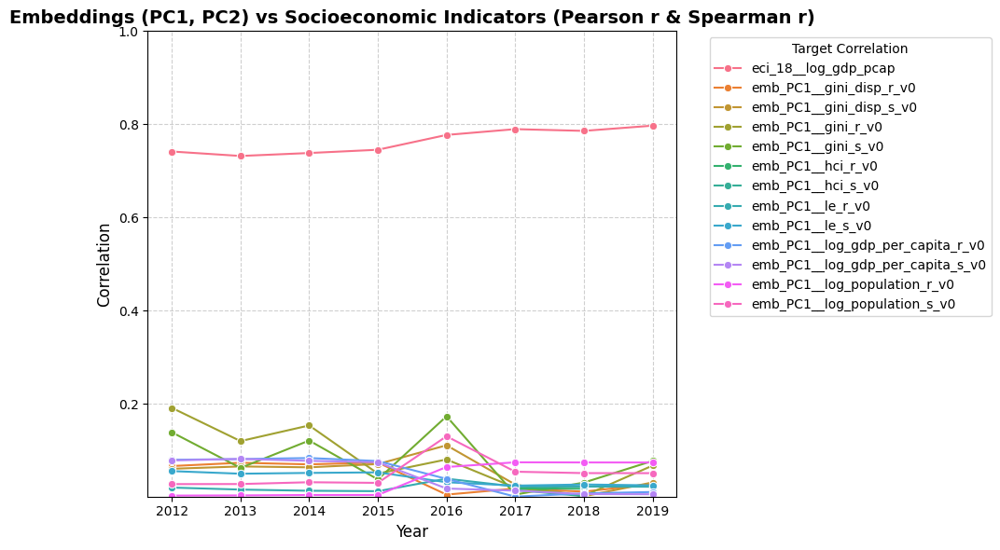

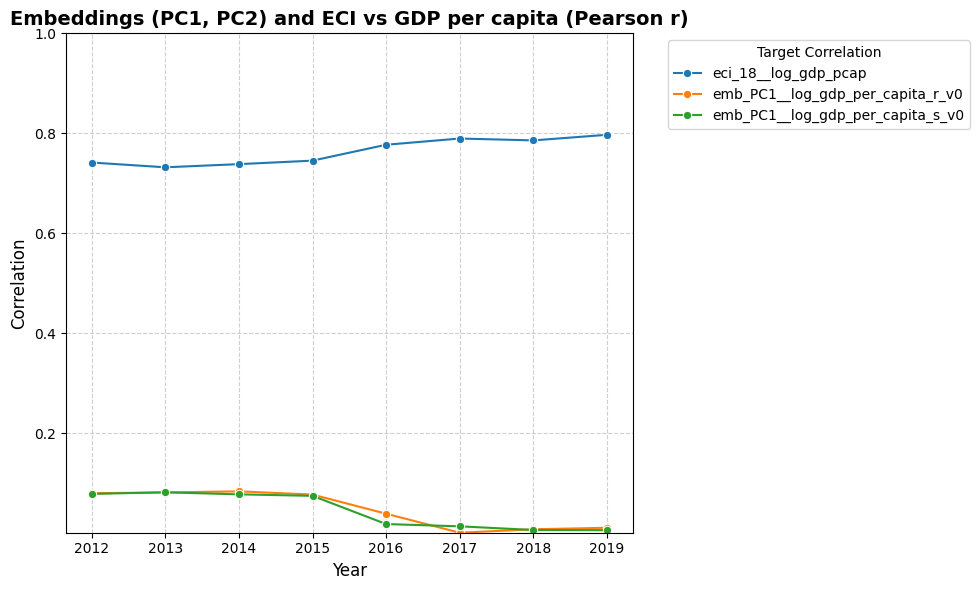

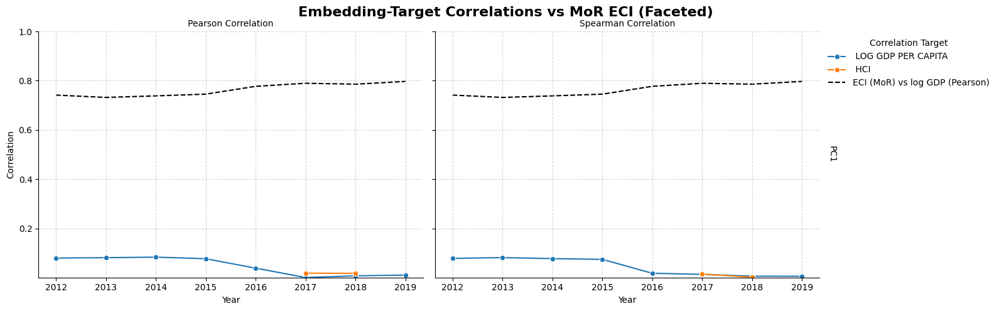

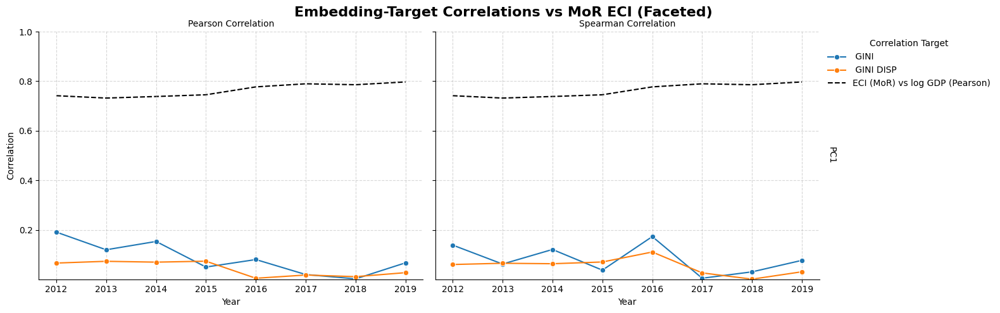

kwargs:  {'cv': 5, 'scoring': 'r2', 'f_debug': False, 'f_with_clustering': True, 'min_cluster_size': 5, 'color_by': 'log_gdp_per_capita', 'updated_loss': True, 'f_deterministic': True, 'f_skip_training': False}
Study name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2012-init
Country embeddings reduced shape: (144, 2)
Explained variance ratio: ['PC1: 0.1087', 'PC2: 0.0853']


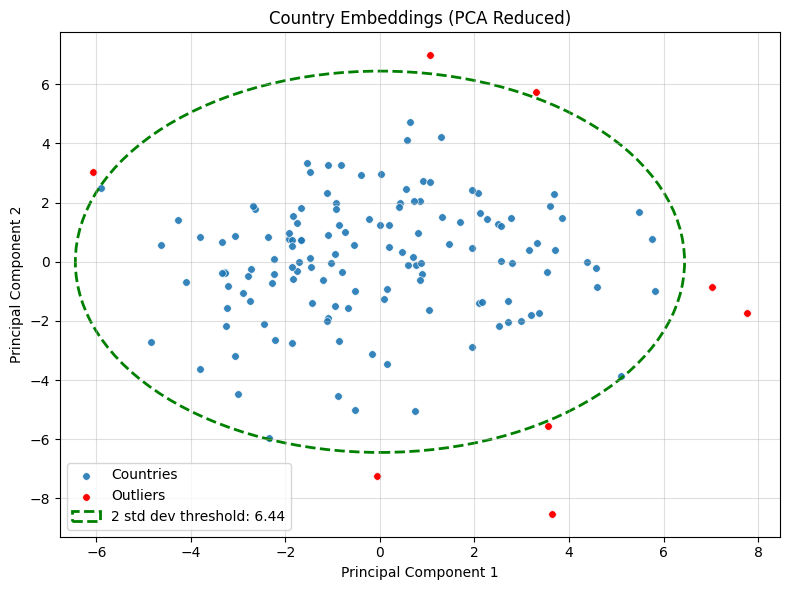

(8, 3)
PCA1 Correlation with GDP:
   Pearson r = -0.0805, p = 0.3374

Outlier countries:
Outlier 62: Distance = 9.26, Country ID = 392: Japan, (JPN)
Outlier 85: Distance = 7.96, Country ID = 504: Morocco, (MAR)
Outlier 99: Distance = 7.25, Country ID = 600: Paraguay, (PRY)
Outlier 48: Distance = 7.07, Country ID = 320: Guatemala, (GTM)
Outlier 17: Distance = 7.06, Country ID = 112: Belarus, (BLR)
Outlier 33: Distance = 6.79, Country ID = 208: Denmark, (DNK)
Outlier 89: Distance = 6.63, Country ID = 524: Nepal, (NPL)
Outlier 19: Distance = 6.60, Country ID = 120: Cameroon, (CMR)
------------------------------------------------------------ 


Study name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2013-init
Country embeddings reduced shape: (144, 2)
Explained variance ratio: ['PC1: 0.1087', 'PC2: 0.0853']


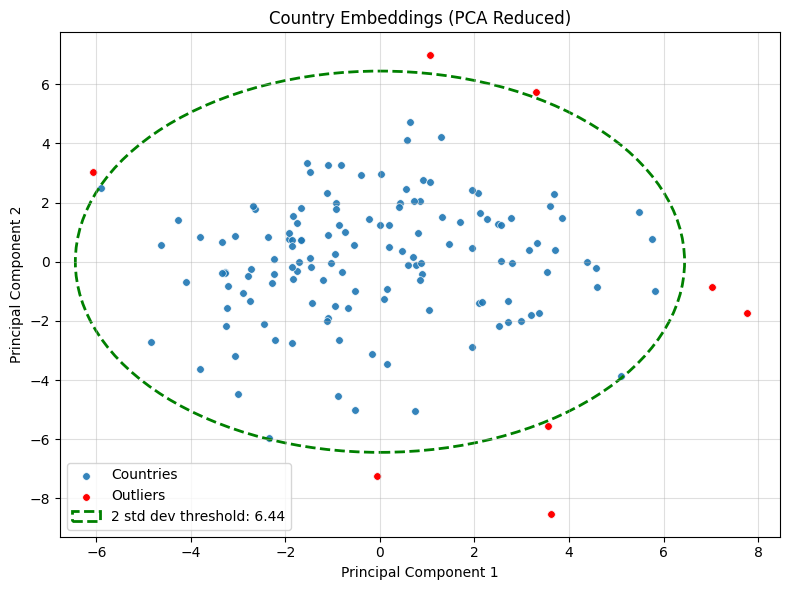

(8, 3)
PCA1 Correlation with GDP:
   Pearson r = -0.0820, p = 0.3283

Outlier countries:
Outlier 62: Distance = 9.26, Country ID = 392: Japan, (JPN)
Outlier 85: Distance = 7.96, Country ID = 504: Morocco, (MAR)
Outlier 99: Distance = 7.25, Country ID = 600: Paraguay, (PRY)
Outlier 48: Distance = 7.07, Country ID = 320: Guatemala, (GTM)
Outlier 17: Distance = 7.06, Country ID = 112: Belarus, (BLR)
Outlier 33: Distance = 6.79, Country ID = 208: Denmark, (DNK)
Outlier 89: Distance = 6.63, Country ID = 524: Nepal, (NPL)
Outlier 19: Distance = 6.60, Country ID = 120: Cameroon, (CMR)
------------------------------------------------------------ 


Study name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2014-init
Country embeddings reduced shape: (144, 2)
Explained variance ratio: ['PC1: 0.1087', 'PC2: 0.0853']


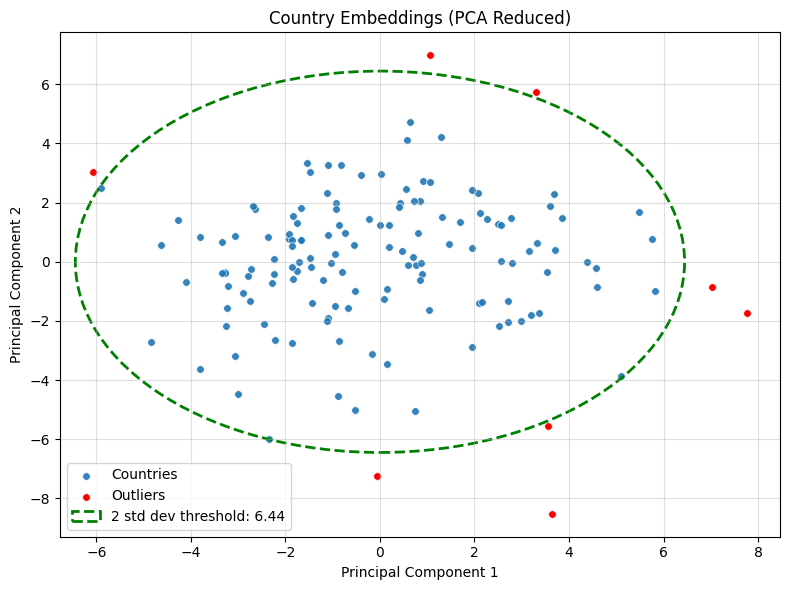

(8, 3)
PCA1 Correlation with GDP:
   Pearson r = -0.0843, p = 0.3152

Outlier countries:
Outlier 62: Distance = 9.26, Country ID = 392: Japan, (JPN)
Outlier 85: Distance = 7.96, Country ID = 504: Morocco, (MAR)
Outlier 99: Distance = 7.25, Country ID = 600: Paraguay, (PRY)
Outlier 48: Distance = 7.07, Country ID = 320: Guatemala, (GTM)
Outlier 17: Distance = 7.06, Country ID = 112: Belarus, (BLR)
Outlier 33: Distance = 6.79, Country ID = 208: Denmark, (DNK)
Outlier 89: Distance = 6.63, Country ID = 524: Nepal, (NPL)
Outlier 19: Distance = 6.60, Country ID = 120: Cameroon, (CMR)
------------------------------------------------------------ 


Study name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2015-init
Country embeddings reduced shape: (144, 2)
Explained variance ratio: ['PC1: 0.1087', 'PC2: 0.0853']


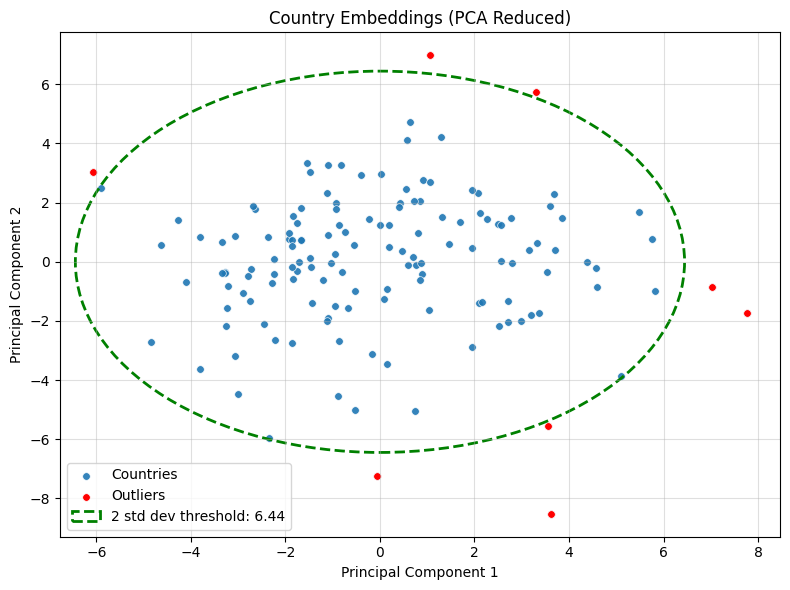

(8, 3)
PCA1 Correlation with GDP:
   Pearson r = -0.0778, p = 0.3540

Outlier countries:
Outlier 62: Distance = 9.26, Country ID = 392: Japan, (JPN)
Outlier 85: Distance = 7.96, Country ID = 504: Morocco, (MAR)
Outlier 99: Distance = 7.25, Country ID = 600: Paraguay, (PRY)
Outlier 48: Distance = 7.07, Country ID = 320: Guatemala, (GTM)
Outlier 17: Distance = 7.06, Country ID = 112: Belarus, (BLR)
Outlier 33: Distance = 6.79, Country ID = 208: Denmark, (DNK)
Outlier 89: Distance = 6.63, Country ID = 524: Nepal, (NPL)
Outlier 19: Distance = 6.60, Country ID = 120: Cameroon, (CMR)
------------------------------------------------------------ 


Study name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2016-init
Country embeddings reduced shape: (144, 2)
Explained variance ratio: ['PC1: 0.5578', 'PC2: 0.0567']


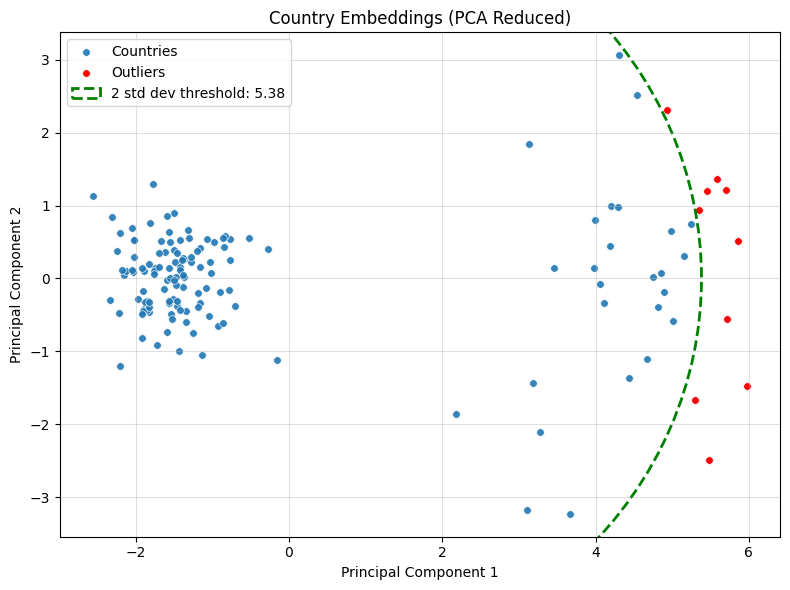

(10, 3)
PCA1 Correlation with GDP:
   Pearson r = -0.0395, p = 0.6380

Outlier countries:
Outlier 142: Distance = 6.16, Country ID = 887: Yemen, (YEM)
Outlier 127: Distance = 6.02, Country ID = 780: Trinidad and Tobago, (TTO)
Outlier 111: Distance = 5.88, Country ID = 694: Sierra Leone, (SLE)
Outlier 123: Distance = 5.83, Country ID = 760: Syria, (SYR)
Outlier 132: Distance = 5.75, Country ID = 800: Uganda, (UGA)
Outlier 124: Distance = 5.74, Country ID = 762: Tajikistan, (TJK)
Outlier 122: Distance = 5.58, Country ID = 756: Switzerland, (CHE)
Outlier 137: Distance = 5.56, Country ID = 834: Tanzania, (TZA)
Outlier 128: Distance = 5.44, Country ID = 784: United Arab Emirates, (ARE)
Outlier 135: Distance = 5.43, Country ID = 818: Egypt, (EGY)
------------------------------------------------------------ 


Study name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2017-init
Country embeddings reduced shape: (144, 2)
Explained variance ratio: ['PC1: 0.2462', 'PC2: 0.2085']


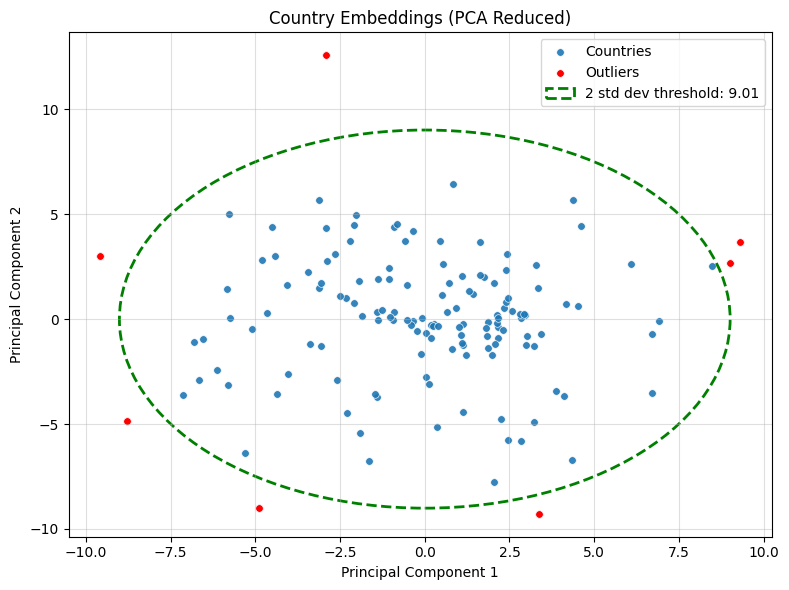

(7, 3)
PCA1 Correlation with GDP:
   Pearson r = -0.0015, p = 0.9854

Outlier countries:
Outlier 34: Distance = 12.91, Country ID = 214: Dominican Republic, (DOM)
Outlier 49: Distance = 10.26, Country ID = 324: Guinea, (GIN)
Outlier 28: Distance = 10.03, Country ID = 188: Costa Rica, (CRI)
Outlier 10: Distance = 10.03, Country ID = 68: Bolivia, (BOL)
Outlier 76: Distance = 10.01, Country ID = 450: Madagascar, (MDG)
Outlier 82: Distance = 9.87, Country ID = 484: Mexico, (MEX)
Outlier 18: Distance = 9.39, Country ID = 116: Cambodia, (KHM)
------------------------------------------------------------ 


Study name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2018-init
Country embeddings reduced shape: (144, 2)
Explained variance ratio: ['PC1: 0.2462', 'PC2: 0.2085']


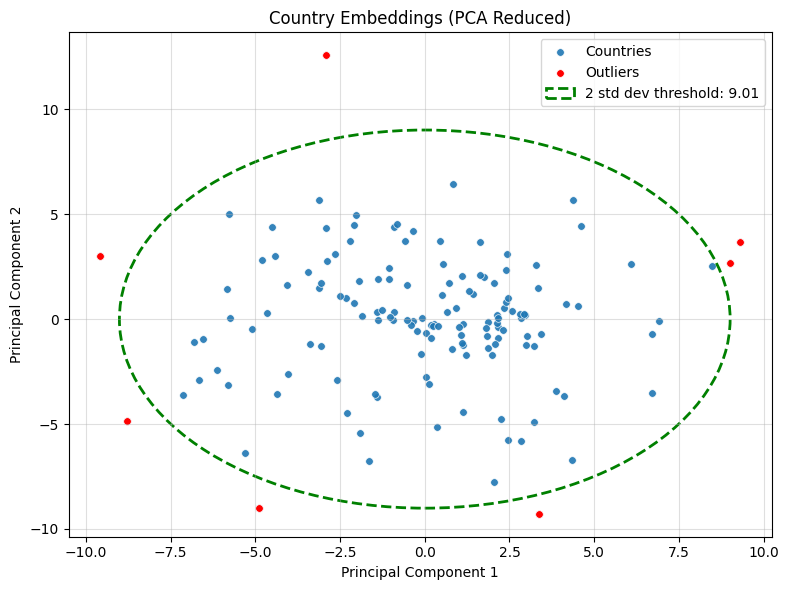

(7, 3)
PCA1 Correlation with GDP:
   Pearson r = -0.0084, p = 0.9202

Outlier countries:
Outlier 34: Distance = 12.91, Country ID = 214: Dominican Republic, (DOM)
Outlier 49: Distance = 10.26, Country ID = 324: Guinea, (GIN)
Outlier 28: Distance = 10.03, Country ID = 188: Costa Rica, (CRI)
Outlier 10: Distance = 10.03, Country ID = 68: Bolivia, (BOL)
Outlier 76: Distance = 10.01, Country ID = 450: Madagascar, (MDG)
Outlier 82: Distance = 9.87, Country ID = 484: Mexico, (MEX)
Outlier 18: Distance = 9.39, Country ID = 116: Cambodia, (KHM)
------------------------------------------------------------ 


Study name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2019-init
Country embeddings reduced shape: (144, 2)
Explained variance ratio: ['PC1: 0.2462', 'PC2: 0.2085']


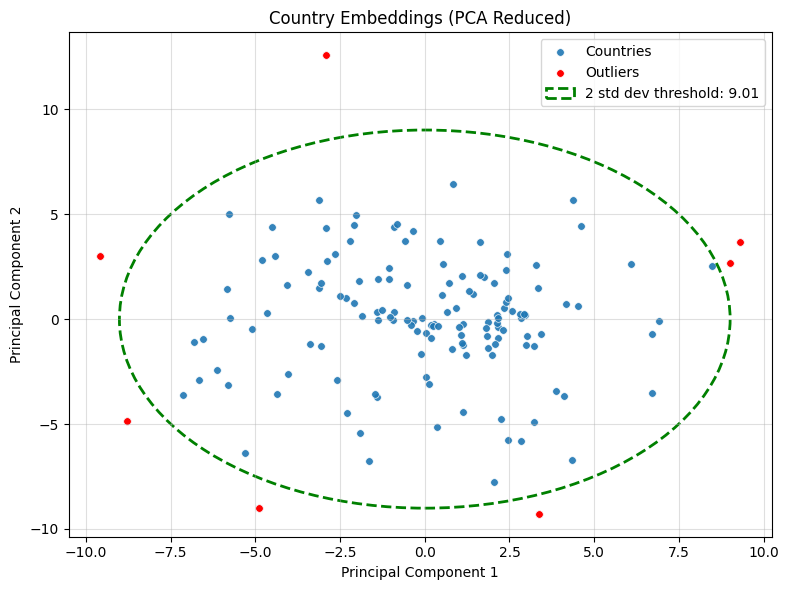

(7, 3)
PCA1 Correlation with GDP:
   Pearson r = -0.0114, p = 0.8917

Outlier countries:
Outlier 34: Distance = 12.91, Country ID = 214: Dominican Republic, (DOM)
Outlier 49: Distance = 10.26, Country ID = 324: Guinea, (GIN)
Outlier 28: Distance = 10.03, Country ID = 188: Costa Rica, (CRI)
Outlier 10: Distance = 10.03, Country ID = 68: Bolivia, (BOL)
Outlier 76: Distance = 10.01, Country ID = 450: Madagascar, (MDG)
Outlier 82: Distance = 9.87, Country ID = 484: Mexico, (MEX)
Outlier 18: Distance = 9.39, Country ID = 116: Cambodia, (KHM)
------------------------------------------------------------ 


Study name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2012-init


c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be re

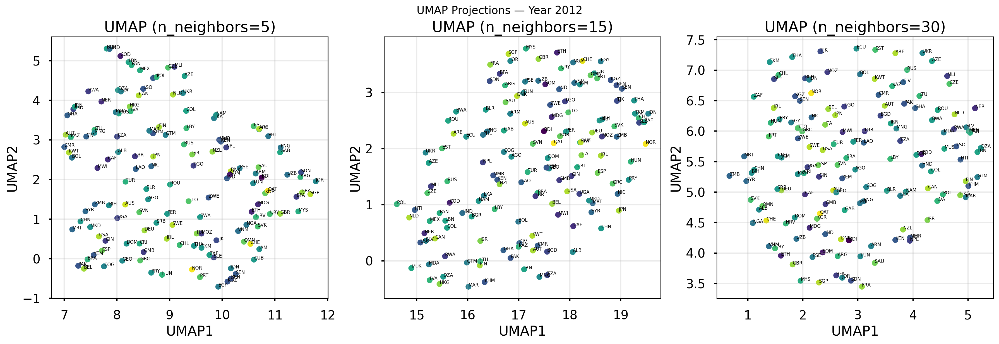

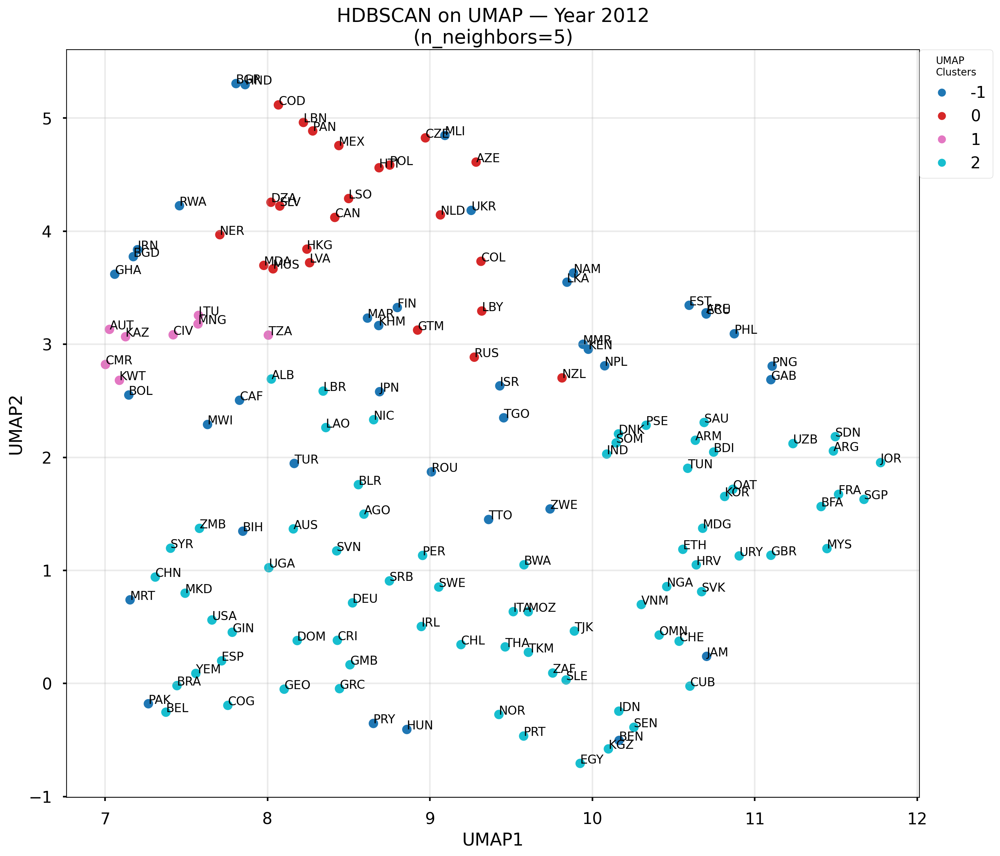

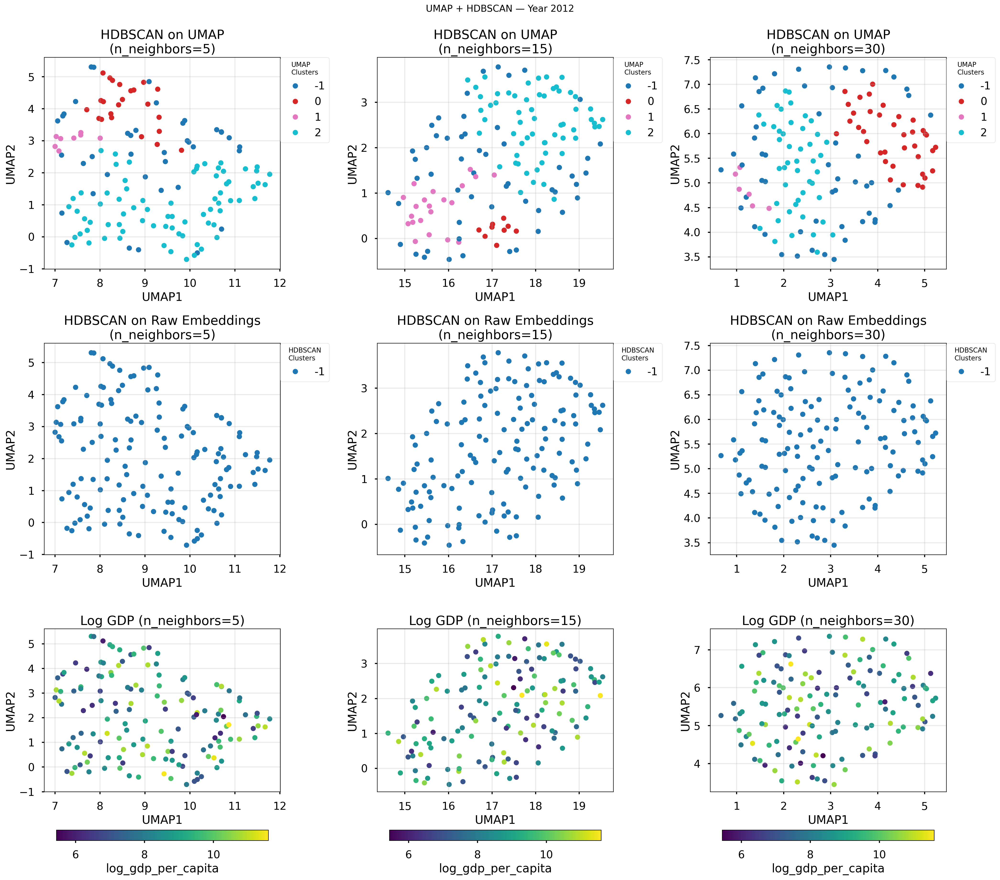

Study name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2013-init


c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be re

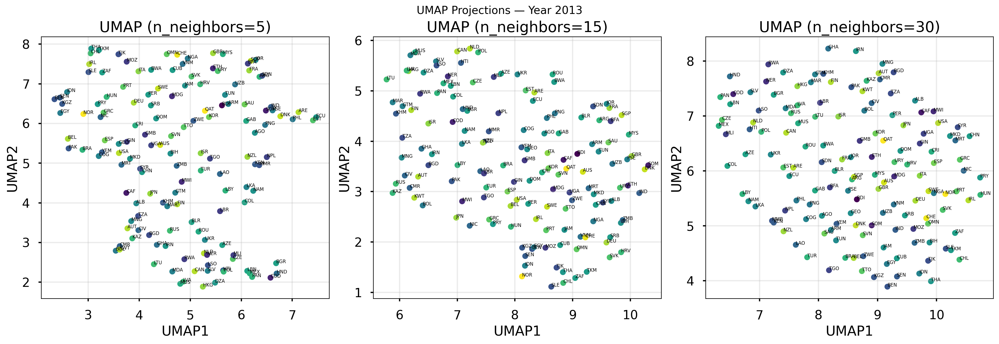

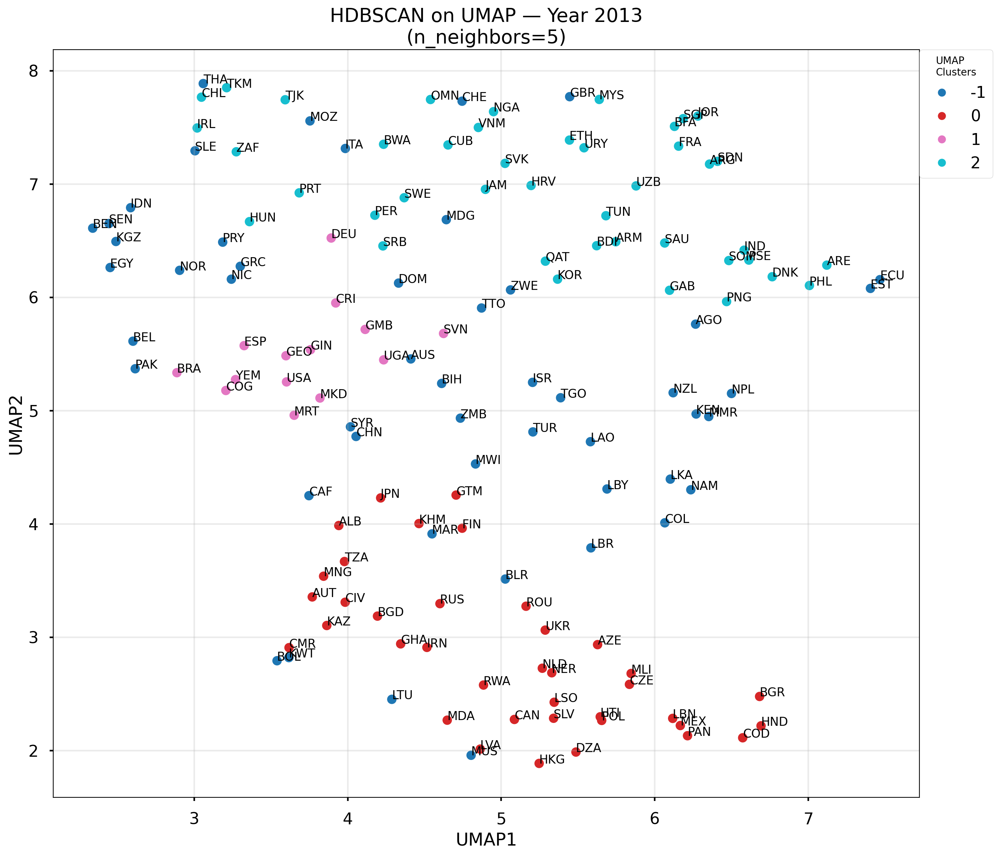

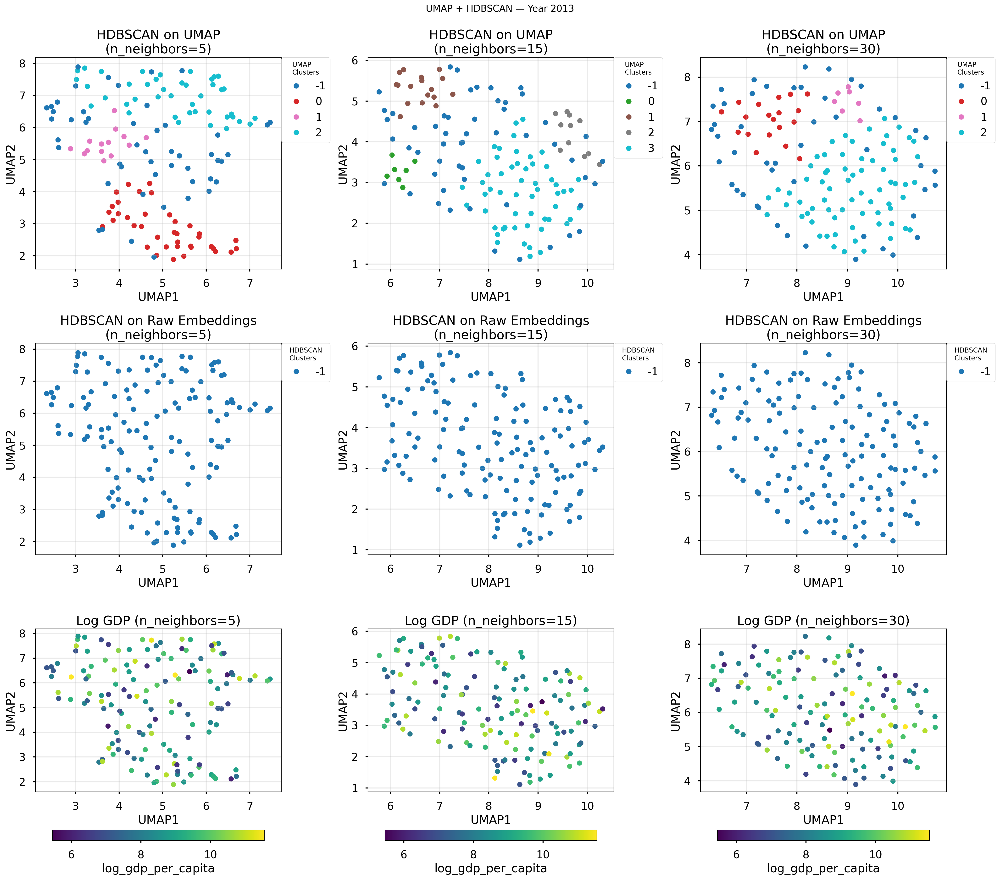

Study name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2014-init


c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be re

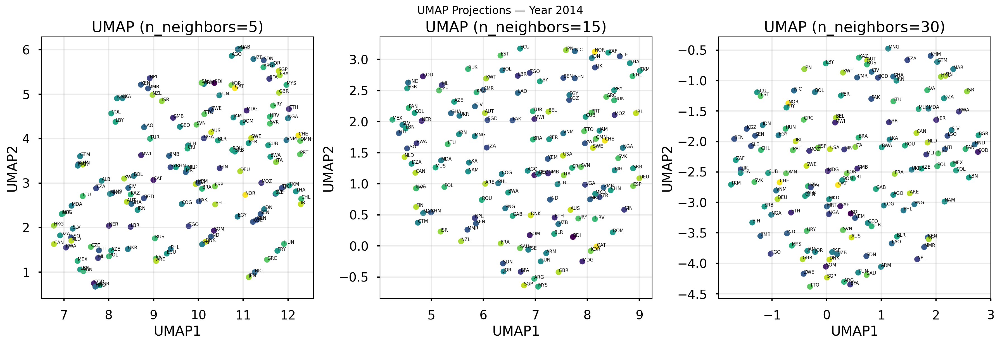

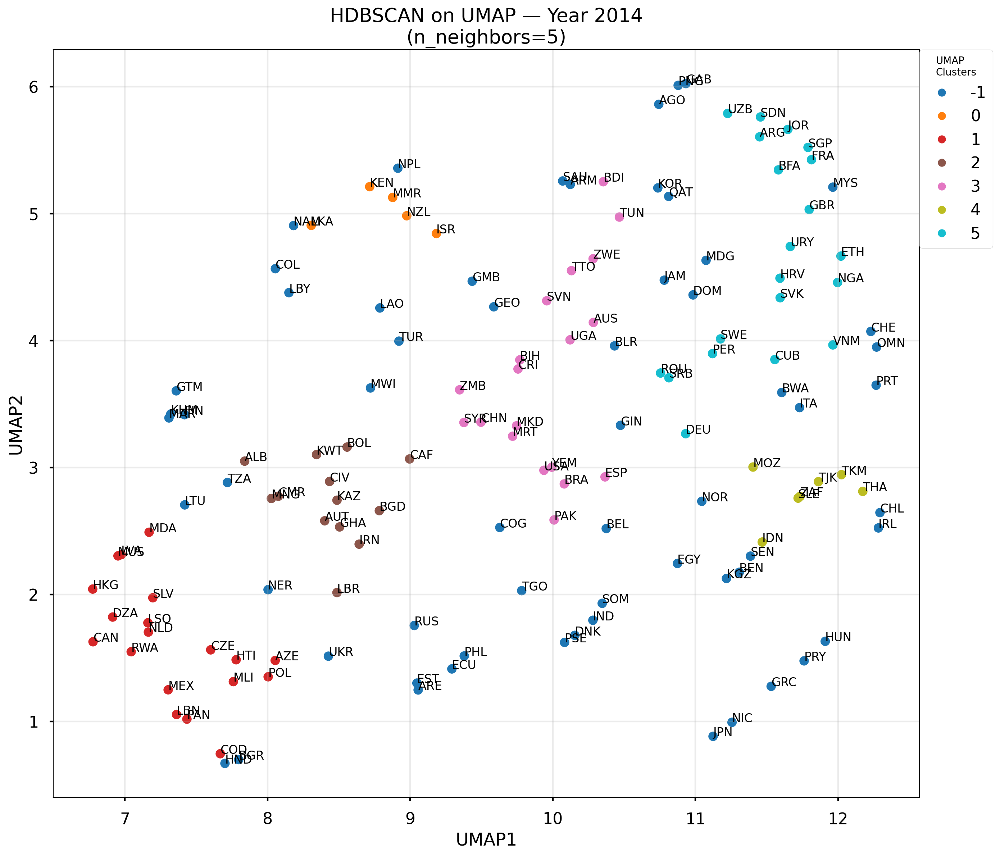

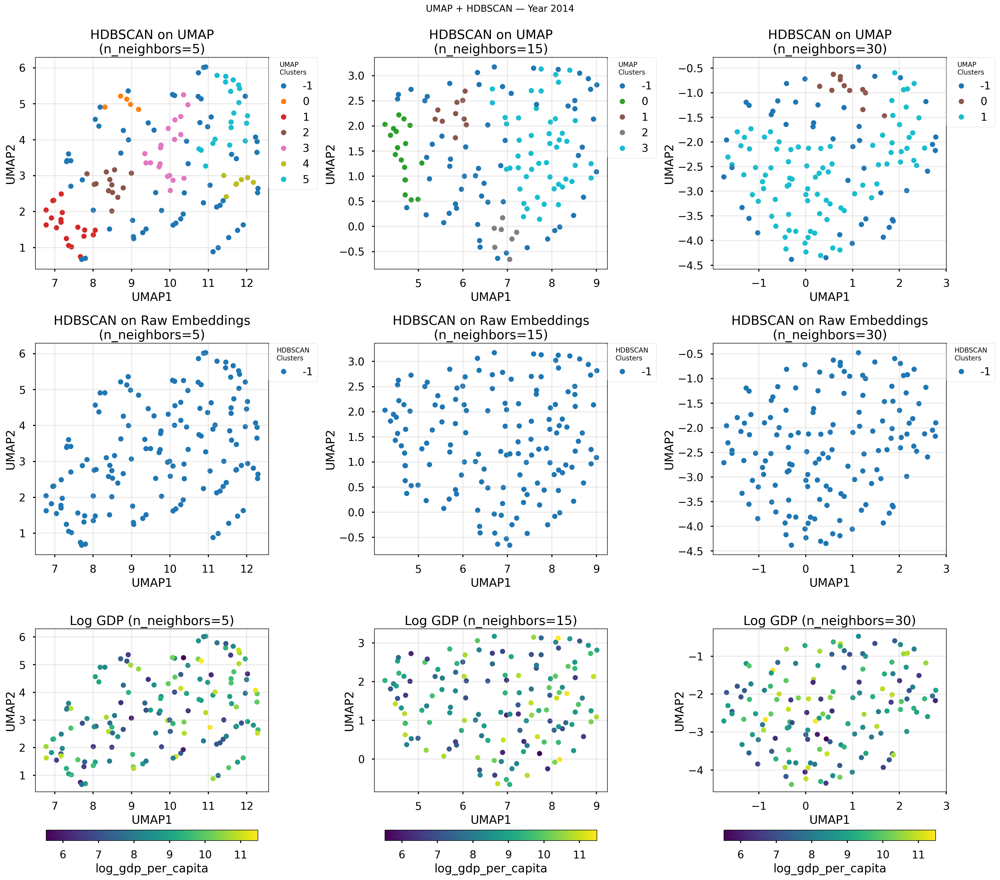

Study name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2015-init


c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be re

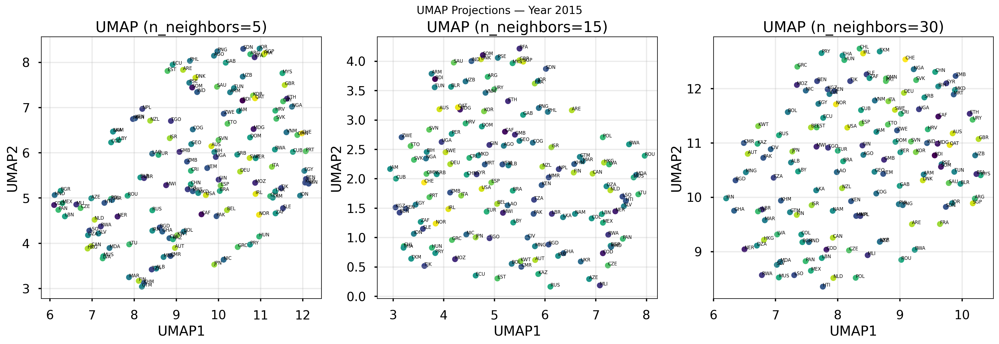

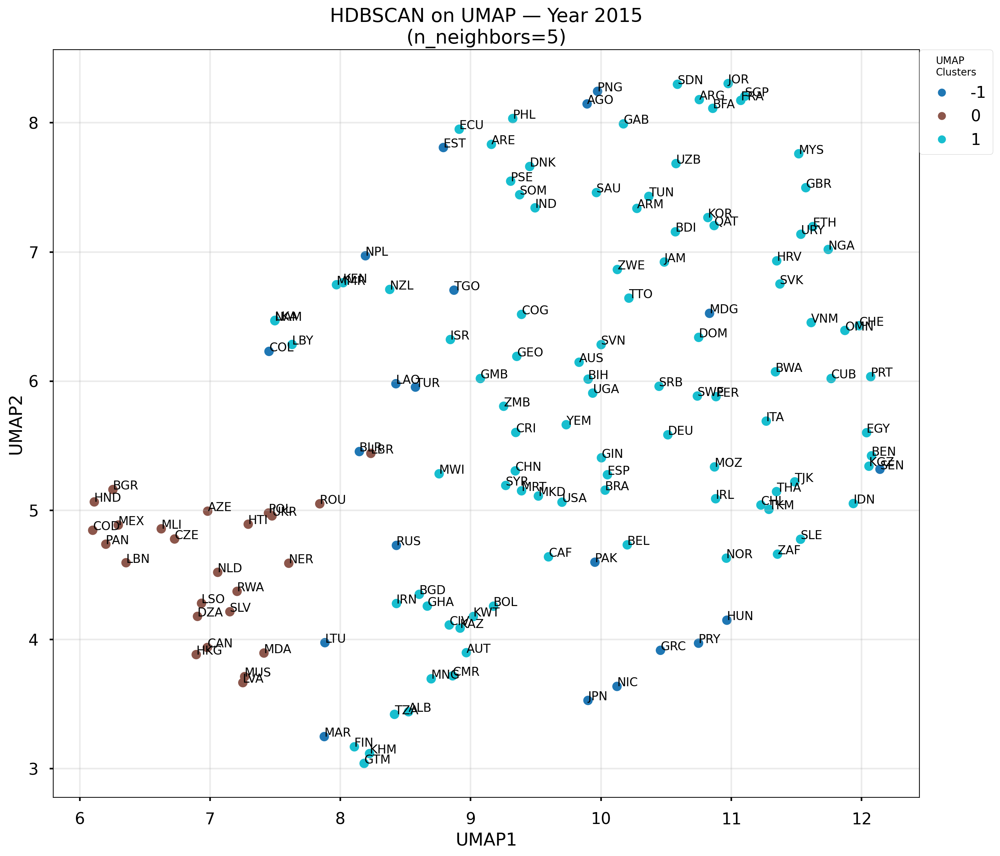

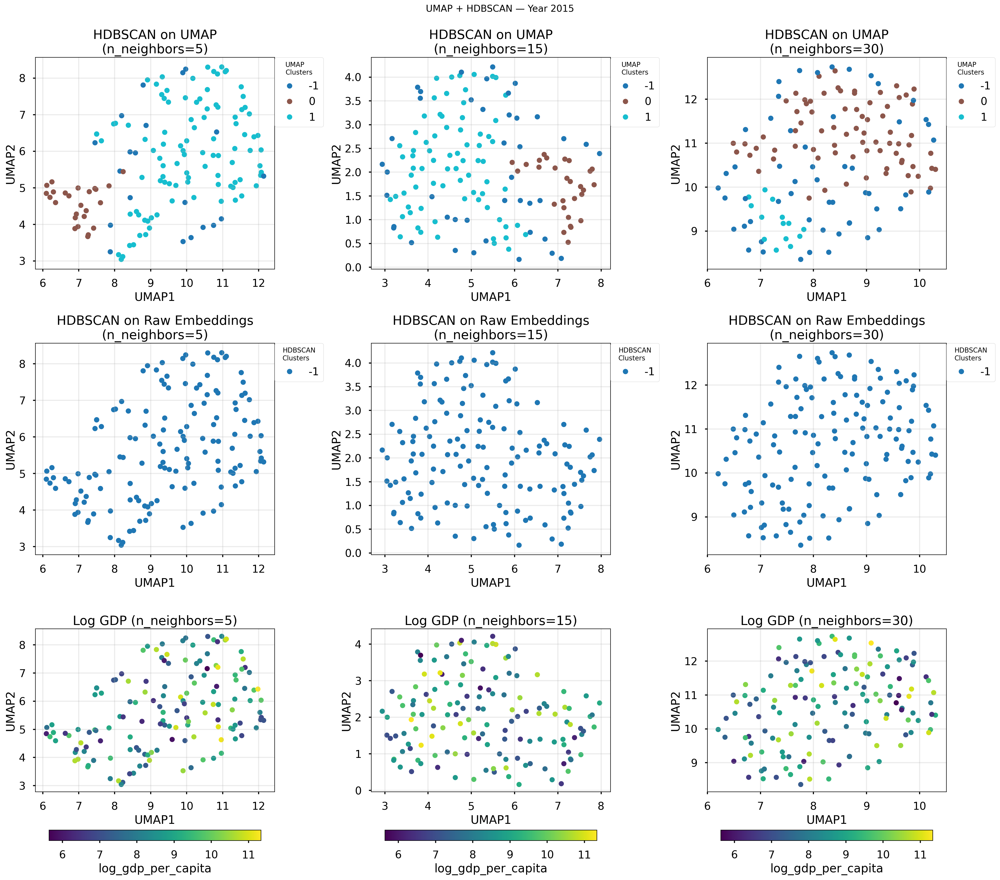

Study name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2016-init


c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be re

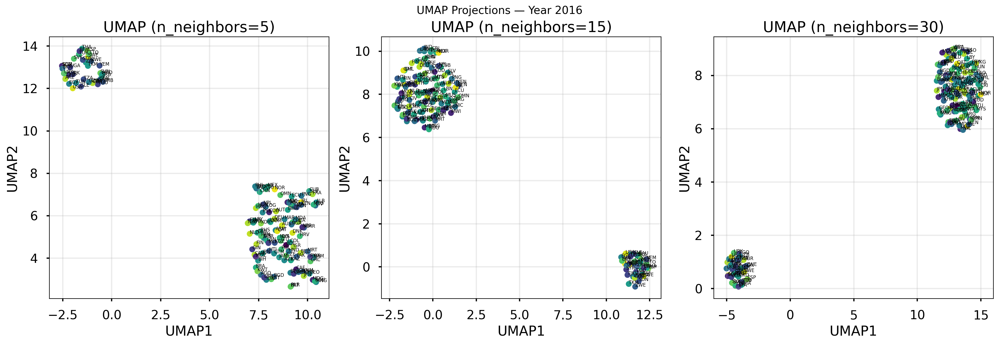

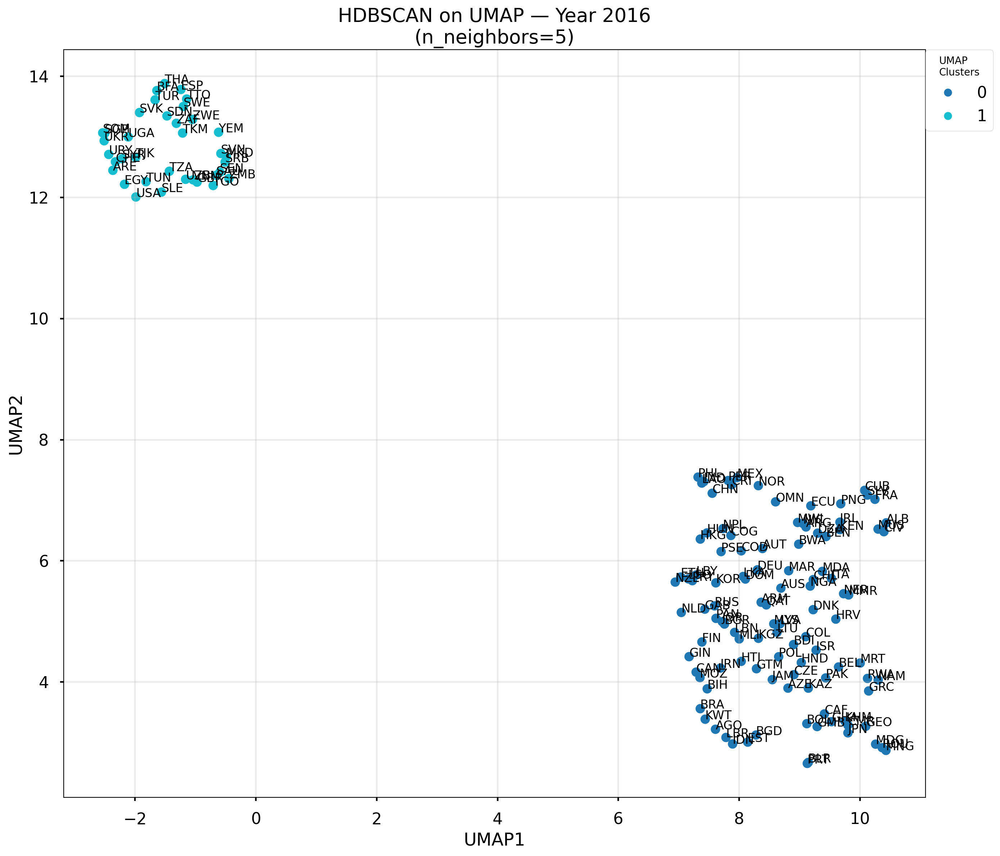

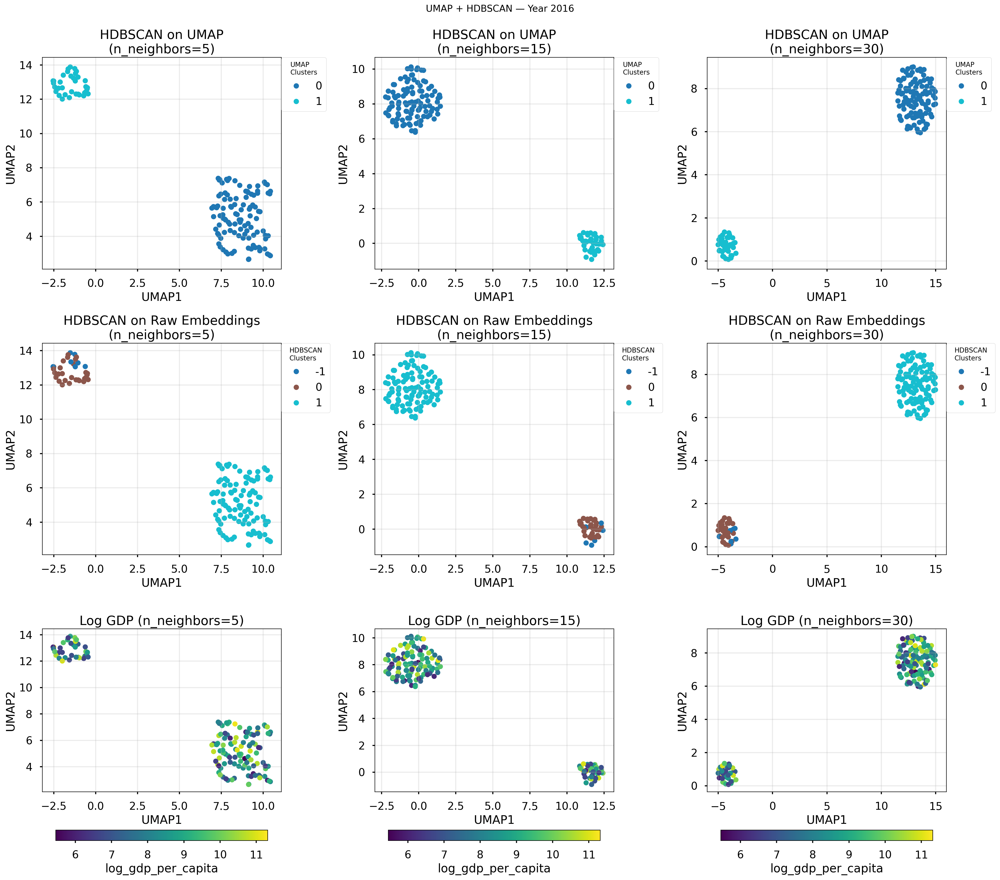

Study name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2017-init


c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be re

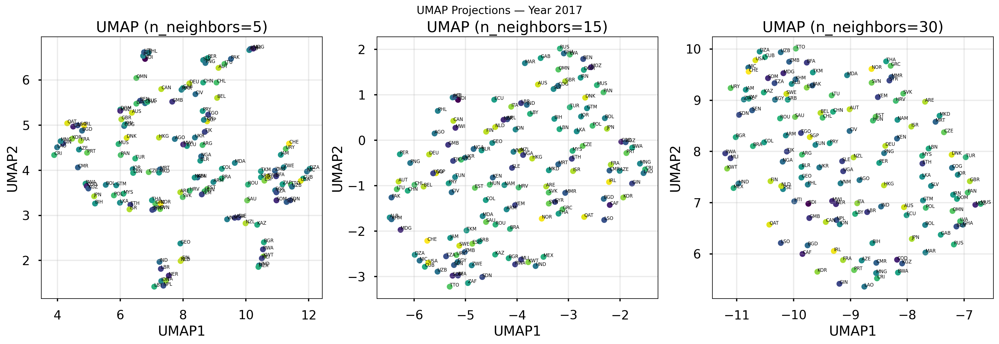

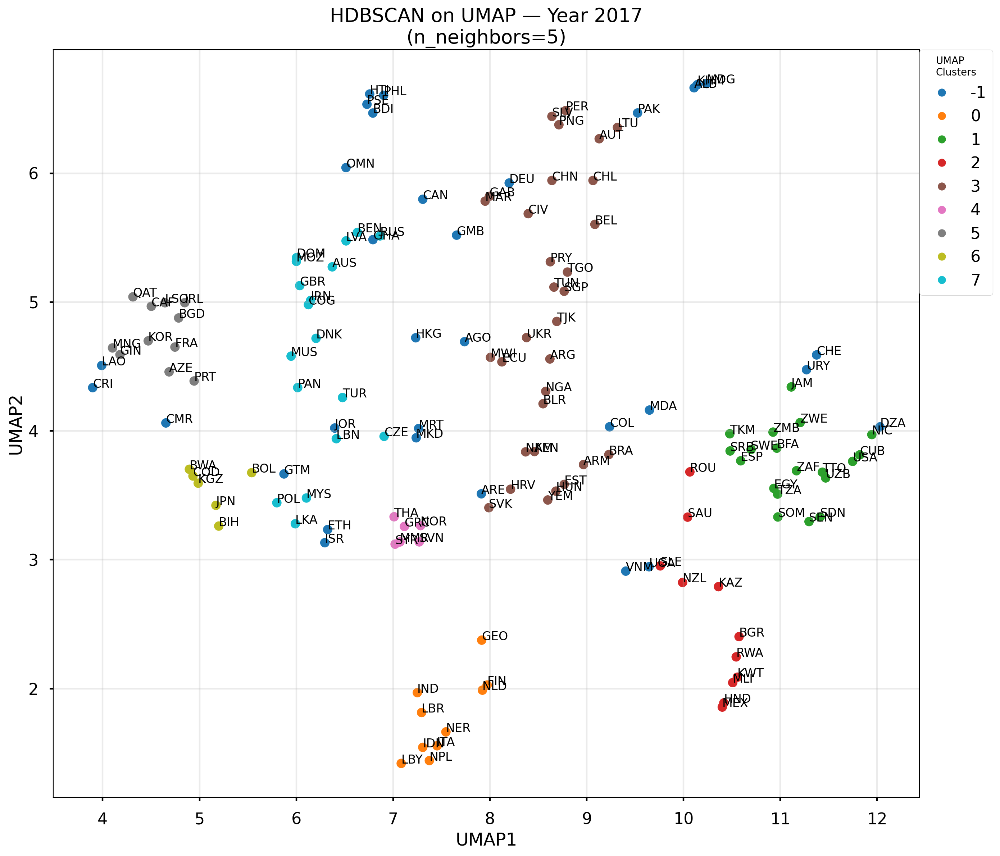

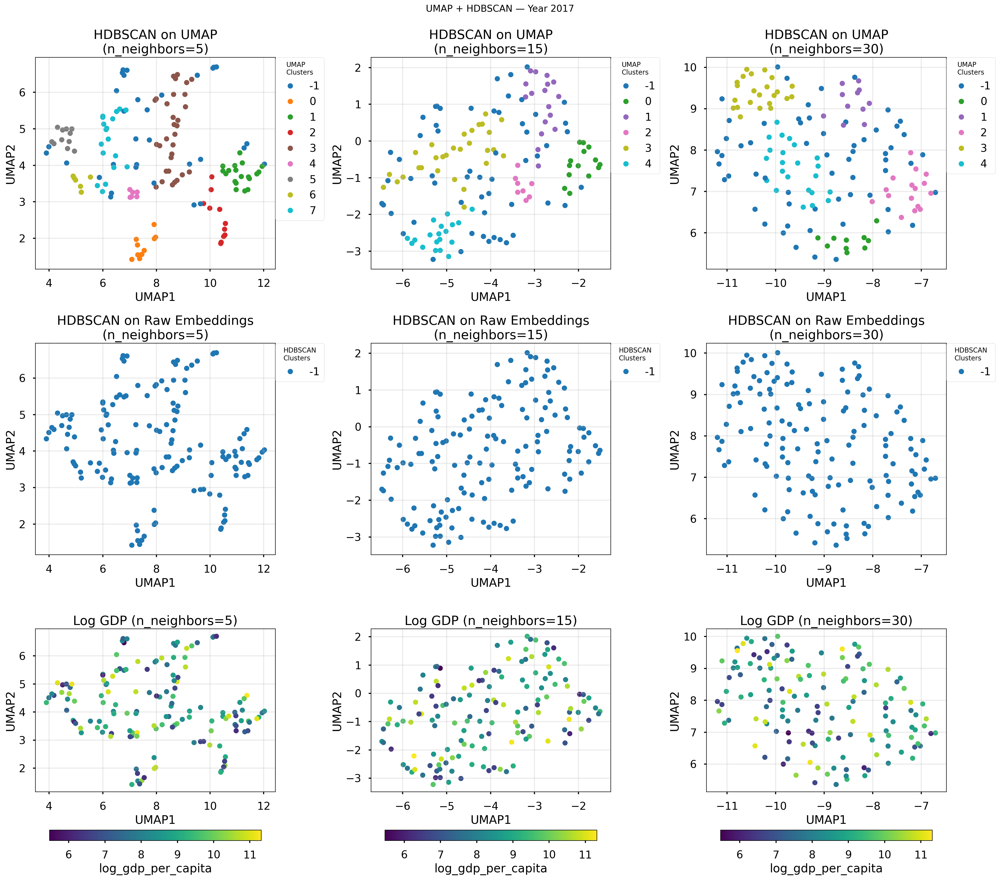

Study name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2018-init


c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be re

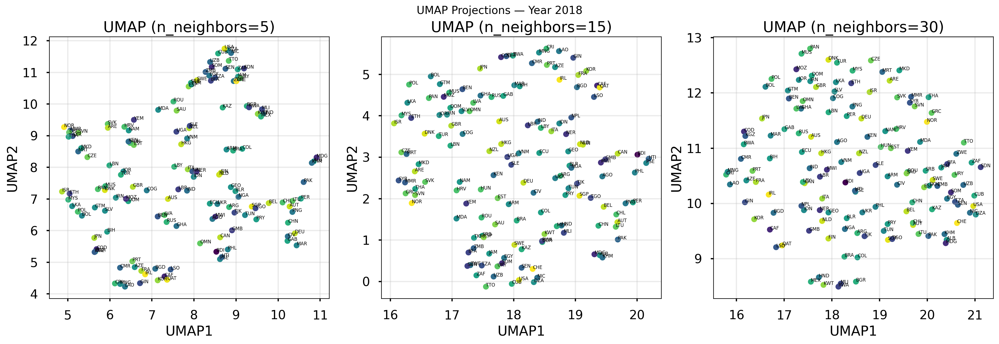

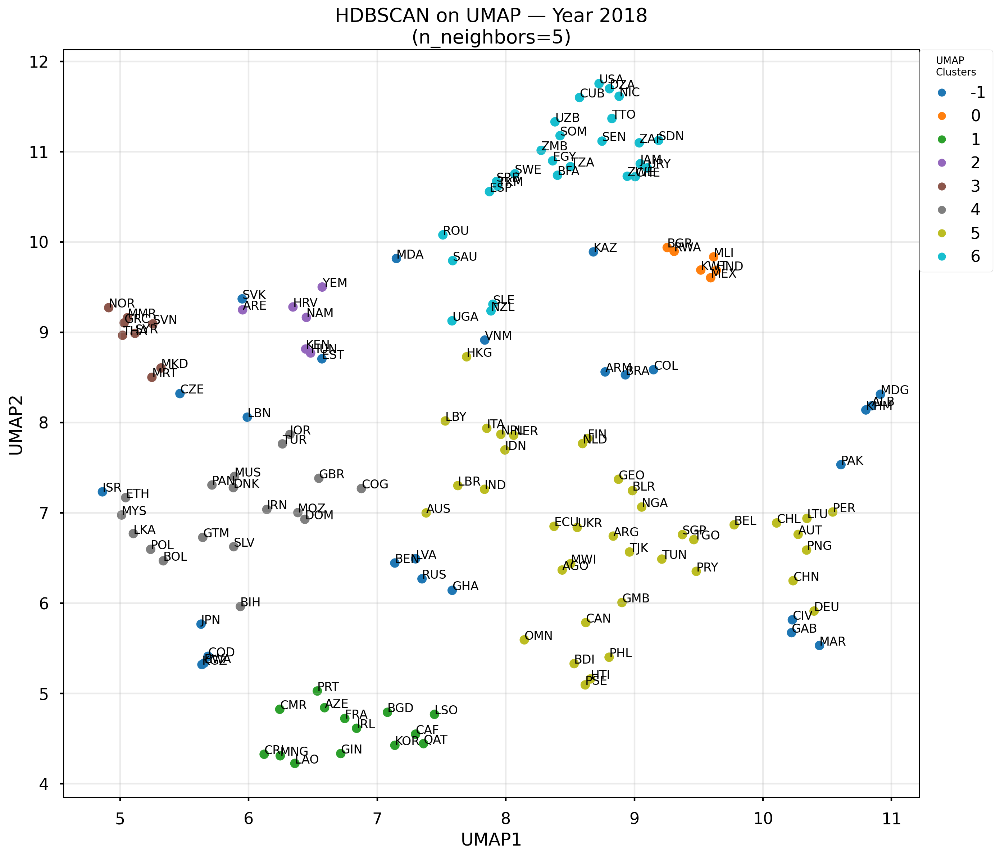

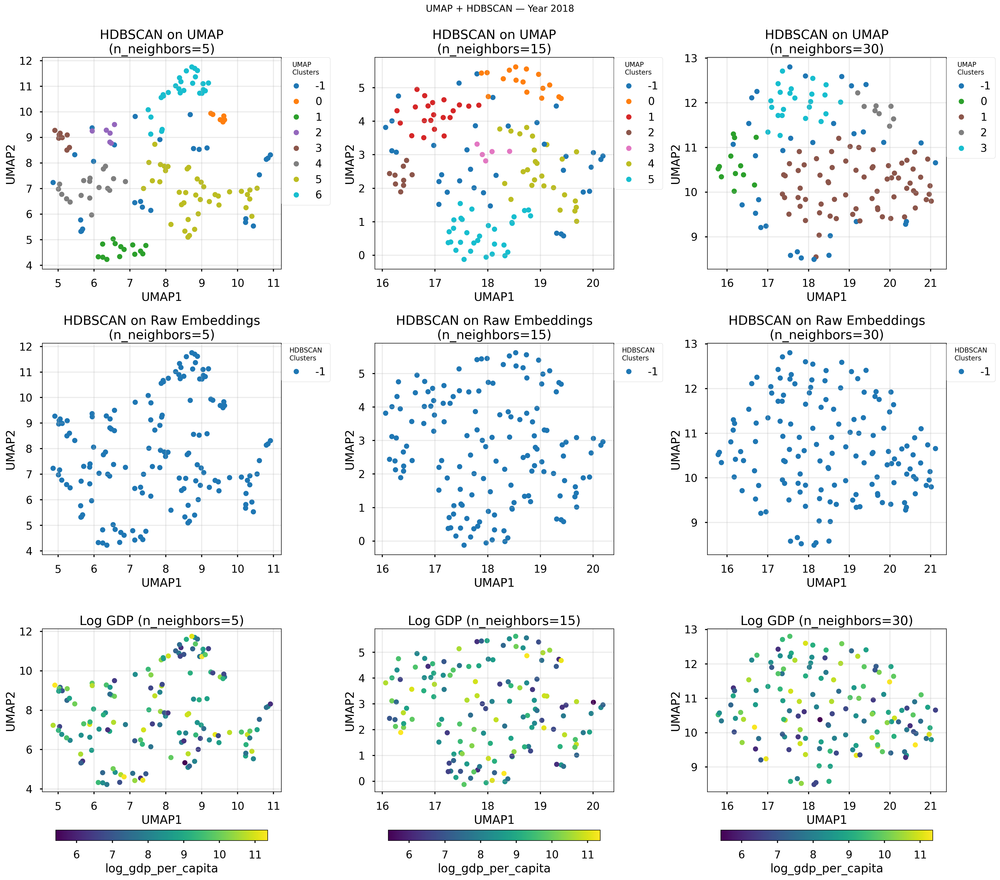

Study name: sage-mor-nd-cd-ht-pr-ph-t_corr_sye_u_loss-2019-init


c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Admin\anaconda3\envs\bdmm2324\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be re

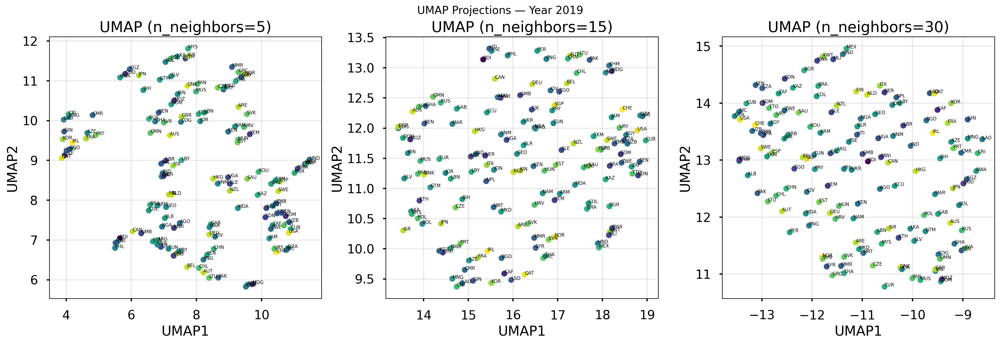

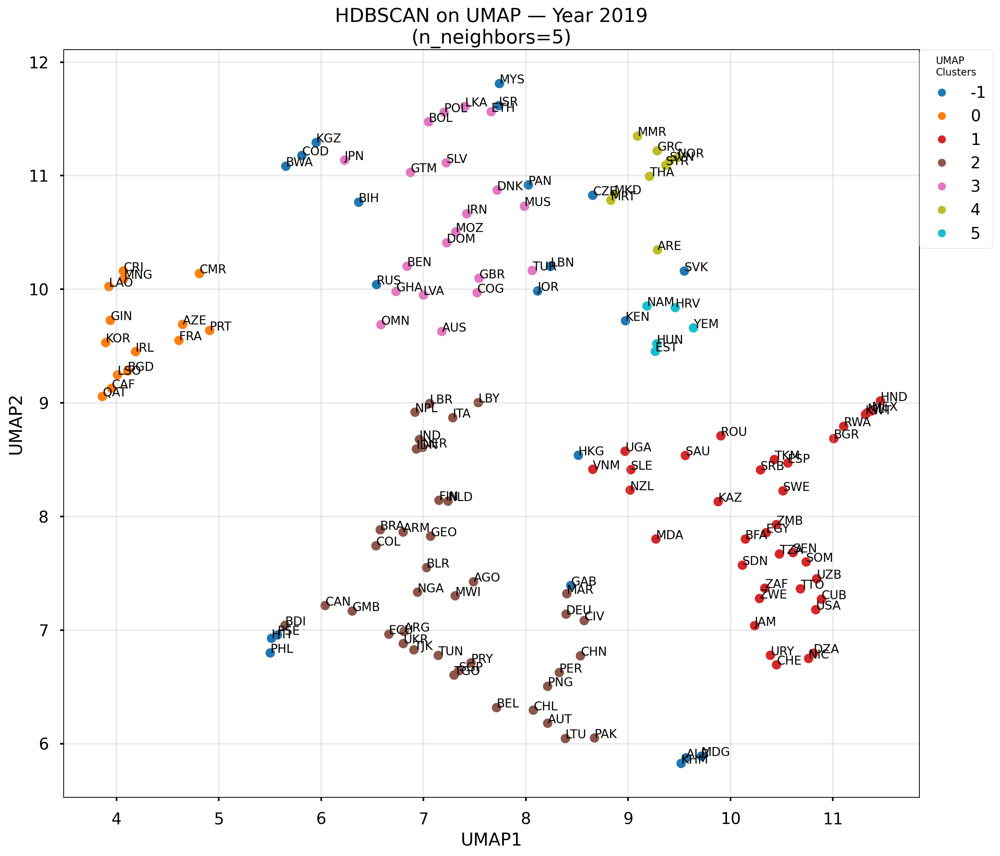

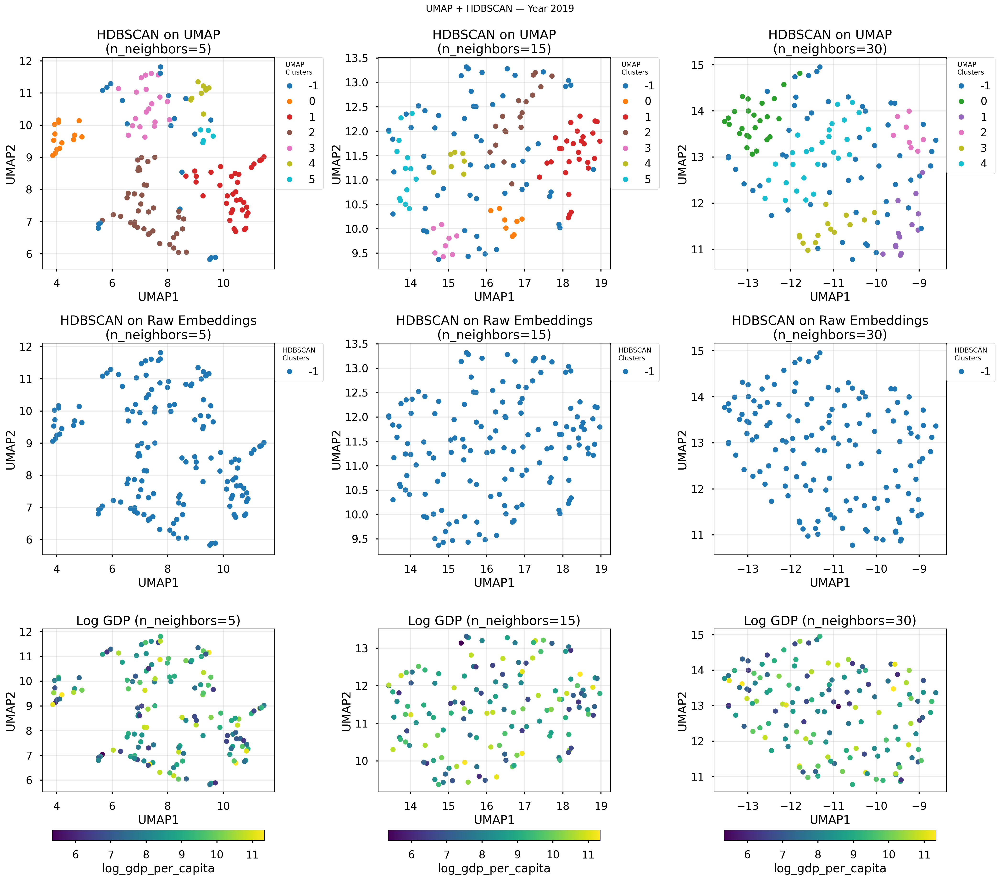

In [41]:
prefix = "sage-mor"
# Define topological features [
#   "nd" - normalized degrees (in-degree, out-degree),
#   "cd" - centrality degree ((in + out degree) / num_nodes),
#   "ht" - HITS scores (hits, hub, authority),
#   "pr" - PageRank scores (pr, pagerank)]
# Define dimensional features [
# # Ideally would be to have a separate dim_features argument for dimensional features
#   "ph" - product hierarchy]
top_features = ["nd", "cd", "ht", "pr", "ph"]
# Define target score
target_score = "corr_sye_u_loss"
# fixed_epochs = 8
f_init = True
version = None
# n_years = 1 if f_init else None
n_years = None
trial_name = "Initial training"
target_columns = [
    "log_gdp_per_capita",
    "gini",  # Gini index
    "gini_disp",  # gini disposable (Standardized World {diposable, post-tax} Income Inequality)
    "hci",  # human capital index
    "log_population",
    "le",  # life expectancy
]
f_debug = False
f_deterministic = True  # To force the random seed for reproducibility 
f_skip_training = False
# specifically for regression models
scoring = "r2"
cv = 5
# For HDBSCAN
f_with_clustering = True
min_cluster_size = 5
color_by = "log_gdp_per_capita"

(
    full_correlations_df,
    outlier_embedding_countries,
    reg_scores_df,
    umap_projections_df,
) = run_training_evaluation_steps(
    rolling_exports_years=rolling_exports_years,
    n_years=n_years,
    x_cp=x_cp,
    gdp_df=sindices_df,
    num_countries=num_countries,
    f_init=f_init,
    os_path=os.path,
    prefix=prefix,
    version=version,
    optuna_study_location=optuna_study_location,
    target_score=target_score,
    top_features=top_features,
    vectordb_location=vectordb_location,
    trial_name=trial_name,
    location_df=location_df,
    target_correlations_df=correlations_df,
    target_columns=target_columns,
    # fixed_epochs=fixed_epochs,
    cv=cv,
    scoring=scoring,
    f_debug=f_debug,
    f_with_clustering=f_with_clustering,
    min_cluster_size=min_cluster_size,
    color_by=color_by,
    updated_loss=True,
    f_deterministic=f_deterministic,
    f_skip_training=f_skip_training,
)

In [42]:
# import matplotlib.pyplot as plt
# print(plt.style.available)
# fig_cluster, axes_cluster = plt.subplots(3, 3, figsize=(18, 18))
# ax0 = axes_cluster[0, 0]
# help(plt.rcParams)


In [43]:
# Display all columns
pd.set_option('display.max_columns', None)

In [44]:
print("reg_scores_df:")
display(reg_scores_df)

reg_scores_df:


,year,Ridge_log_gdp_per_capita_r2,Ridge_log_gdp_per_capita_corr,ElasticNet_log_gdp_per_capita_r2,ElasticNet_log_gdp_per_capita_corr,SVR_log_gdp_per_capita_r2,SVR_log_gdp_per_capita_corr,Ridge_gini_r2,Ridge_gini_corr,ElasticNet_gini_r2,ElasticNet_gini_corr,SVR_gini_r2,SVR_gini_corr,Ridge_gini_disp_r2,Ridge_gini_disp_corr,ElasticNet_gini_disp_r2,ElasticNet_gini_disp_corr,SVR_gini_disp_r2,SVR_gini_disp_corr,Ridge_log_population_r2,Ridge_log_population_corr,ElasticNet_log_population_r2,ElasticNet_log_population_corr,SVR_log_population_r2,SVR_log_population_corr,Ridge_le_r2,Ridge_le_corr,ElasticNet_le_r2,ElasticNet_le_corr,SVR_le_r2,SVR_le_corr,Ridge_hci_r2,Ridge_hci_corr,ElasticNet_hci_r2,ElasticNet_hci_corr,SVR_hci_r2,SVR_hci_corr
0,2012,-0.223798,0.326705,-0.079295,0.284440,-0.128958,0.534395,-0.402414,0.530444,-0.149973,0.517304,-0.093348,0.587151,-0.294110,0.412015,-0.171430,0.404030,-0.143693,0.404902,-0.210032,0.376358,-0.067383,0.262743,-0.117269,0.581629,-0.172895,0.335238,-0.059440,0.327483,-0.057350,0.424582,NaN,NaN,NaN,NaN,NaN,NaN
1,2013,-1.27,0.400429,-0.930363,0.397127,-0.087342,0.579228,-2.36,0.614436,-1.94,0.613336,-0.132998,0.416021,-1.41,0.274270,-1.32,0.273854,-0.044971,0.445526,-0.352930,0.418098,-0.247444,0.414637,-0.091268,0.485867,-1.59,0.312155,-1.51,0.311895,-0.082564,0.490808,NaN,NaN,NaN,NaN,NaN,NaN
2,2014,-0.185091,0.372920,-0.136034,0.336778,-0.161408,0.543168,-0.788157,0.467417,-0.661086,0.446584,-0.119504,0.503718,-0.109613,0.422184,-0.093577,0.393684,-0.027037,0.381733,-0.112951,0.367257,-0.054073,0.339231,-0.140247,0.489919,-0.075952,0.415424,-0.033854,0.397350,-0.048324,0.397031,NaN,NaN,NaN,NaN,NaN,NaN
3,2015,-0.174973,0.396966,-0.112353,0.344195,-0.082264,0.581881,-0.275472,0.578715,-0.212532,0.568030,-0.094915,0.386980,-0.387605,0.370733,-0.326091,0.359283,-0.063836,0.386503,-0.136812,0.417891,-0.130721,0.349323,-0.252792,0.512668,-0.244306,0.346449,-0.175152,0.339544,-0.058875,0.343436,NaN,NaN,NaN,NaN,NaN,NaN
4,2016,-0.252495,0.391211,-0.147554,0.331309,-0.065021,0.581684,-0.594613,0.559011,-0.392929,0.546420,-0.069258,0.519699,-0.568775,0.440652,-0.483438,0.416495,-0.254443,0.417754,-0.352330,0.361330,-0.160705,0.318367,-0.120138,0.568892,-0.114889,0.462752,-0.074648,0.440708,-0.052602,0.443522,NaN,NaN,NaN,NaN,NaN,NaN
5,2017,-0.103452,0.335766,-0.062155,0.313544,-0.078672,0.596425,-0.512820,0.581332,-0.356520,0.572593,-0.081684,0.595389,-0.451616,0.377387,-0.359344,0.371078,-0.084249,0.505375,-0.298081,0.382799,-0.172635,0.343824,-0.160876,0.637492,-0.097009,0.328095,-0.068556,0.325456,-0.083102,0.406819,-0.286632,0.374031,-0.110442,NaN,-0.524541,0.779341
6,2018,-0.248663,0.295344,-0.143256,0.253166,-0.103078,0.482256,-0.659218,0.513512,-0.516235,0.507638,-0.126626,0.490750,-0.195406,0.418859,-0.131134,0.414115,-0.036186,0.385210,-0.171124,0.364391,-0.102767,0.298426,-0.156258,0.506228,-0.231335,0.300174,-0.158326,0.291983,-0.060731,0.354075,-0.283278,0.377186,-0.111948,NaN,-0.182863,0.799432
7,2019,-0.262764,0.344076,-0.109622,0.281990,-0.108575,0.520695,-0.872756,0.532165,-0.749892,0.517950,-0.097219,0.502346,-0.302926,0.407558,-0.265736,0.395835,-0.076011,0.469717,-0.185025,0.383468,-0.088577,0.330363,-0.059838,0.554704,-0.274185,0.292580,-0.191891,0.273432,-0.063417,0.389549,NaN,NaN,NaN,NaN,NaN,NaN


In [45]:
print("full_correlations_df")
display(full_correlations_df)

full_correlations_df


,year,eci_18__log_gdp_pcap,emb_PC1__log_gdp_per_capita_r_v0,emb_PC1__log_gdp_per_capita_s_v0,emb_PC2__log_gdp_per_capita_r_v0,emb_PC2__log_gdp_per_capita_s_v0,emb_PC1__gini_r_v0,emb_PC1__gini_s_v0,emb_PC2__gini_r_v0,emb_PC2__gini_s_v0,emb_PC1__gini_disp_r_v0,emb_PC1__gini_disp_s_v0,emb_PC2__gini_disp_r_v0,emb_PC2__gini_disp_s_v0,emb_PC1__hci_r_v0,emb_PC1__hci_s_v0,emb_PC2__hci_r_v0,emb_PC2__hci_s_v0,emb_PC1__log_population_r_v0,emb_PC1__log_population_s_v0,emb_PC2__log_population_r_v0,emb_PC2__log_population_s_v0,emb_PC1__le_r_v0,emb_PC1__le_s_v0,emb_PC2__le_r_v0,emb_PC2__le_s_v0
0,2012,0.741711,0.080519,0.079146,NaN,NaN,0.191908,0.139529,NaN,NaN,0.067069,0.061222,NaN,NaN,NaN,NaN,NaN,NaN,0.003718,0.028338,NaN,NaN,0.020921,0.056241,NaN,NaN
1,2013,0.732153,0.082039,0.082373,NaN,NaN,0.120593,0.063082,NaN,NaN,0.074127,0.066246,NaN,NaN,NaN,NaN,NaN,NaN,0.004081,0.028503,NaN,NaN,0.016604,0.050631,NaN,NaN
2,2014,0.738466,0.084276,0.078273,NaN,NaN,0.154150,0.121790,NaN,NaN,0.070714,0.064356,NaN,NaN,NaN,NaN,NaN,NaN,0.005009,0.032365,NaN,NaN,0.014096,0.052355,NaN,NaN
3,2015,0.745452,0.077793,0.075267,NaN,NaN,0.050966,0.038473,NaN,NaN,0.074580,0.071364,NaN,NaN,NaN,NaN,NaN,NaN,0.005063,0.030994,NaN,NaN,0.013167,0.053549,NaN,NaN
4,2016,0.777236,0.039542,0.018861,NaN,NaN,0.081200,0.173774,NaN,NaN,0.005801,0.111598,NaN,NaN,NaN,NaN,NaN,NaN,0.065032,0.130934,NaN,NaN,0.039991,0.032361,NaN,NaN
5,2017,0.789686,0.001539,0.014312,NaN,NaN,0.020730,0.005883,NaN,NaN,0.018824,0.027437,NaN,NaN,0.019249,0.015701,NaN,NaN,0.075088,0.054975,NaN,NaN,0.023131,0.025084,NaN,NaN
6,2018,0.785940,0.008424,0.006997,NaN,NaN,0.003380,0.031645,NaN,NaN,0.012269,0.002160,NaN,NaN,0.018389,0.002610,NaN,NaN,0.074813,0.051933,NaN,NaN,0.023079,0.027546,NaN,NaN
7,2019,0.797133,0.011440,0.006631,NaN,NaN,0.068073,0.078072,NaN,NaN,0.028378,0.031971,NaN,NaN,NaN,NaN,NaN,NaN,0.074686,0.051821,NaN,NaN,0.022770,0.025695,NaN,NaN


In [46]:
print("umap_projections_df")
display(umap_projections_df)

umap_projections_df


,country_id,country_code,country_name,year_x,log_gdp_per_capita,ECI_18,log_population,gini,gini_disp,hci,hdi,le,eys,mys,gnipc,UMAP1,UMAP2,year_y,umap_n_neighbors,umap_cluster,hdb_cluster
0,8,ALB,Albania,2012,8.35,-0.294829,14.88,29.00,37.90,NaN,0.789000,78.06,15.77,10.03,"11,146.25",8.02,2.69,2012,5,2,-1
1,12,DZA,Algeria,2012,8.71,-1.10,17.44,NaN,NaN,NaN,0.726000,74.20,14.56,7.25,"11,103.43",8.02,4.26,2012,5,0,-1
2,24,AGO,Angola,2012,8.53,-1.27,17.04,NaN,49.30,NaN,0.545000,58.62,10.49,3.91,"7,256.37",8.59,1.50,2012,5,2,-1
3,31,AZE,Azerbaijan,2012,8.92,-1.02,16.05,NaN,NaN,NaN,0.739000,70.36,12.83,10.47,"13,272.62",9.28,4.61,2012,5,0,-1
4,32,ARG,Argentina,2012,9.47,0.296829,17.56,41.40,39.00,NaN,0.844000,76.47,17.24,10.79,"23,555.62",11.48,2.06,2012,5,2,-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3451,854,BFA,Burkina Faso,2019,6.64,-1.54,16.86,NaN,41.50,NaN,0.446000,60.04,8.91,2.10,"1,993.48",-12.97,13.44,2019,30,0,-1
3452,858,URY,Uruguay,2019,9.82,0.282504,15.04,39.70,36.70,NaN,0.818000,77.51,16.46,8.98,"22,393.37",-12.71,13.79,2019,30,0,-1
3453,860,UZB,Uzbekistan,2019,7.62,-0.630568,17.31,NaN,32.20,NaN,0.725000,71.34,12.35,11.90,"7,487.42",-13.19,13.51,2019,30,0,-1
3454,887,YEM,Yemen,2019,6.44,-1.37,17.37,NaN,NaN,NaN,0.430000,65.09,7.92,2.69,"1,165.09",-11.69,12.55,2019,30,4,-1


In [47]:
pd.reset_option('display.max_columns')

In [48]:
dumped_data["reg_scores_df"] = reg_scores_df
dumped_data["full_correlations_df"] = full_correlations_df
dumped_data["umap_projections_df"] = umap_projections_df
dump_file_name = f"{prefix}-{'-'.join(top_features)}-t_{target_score}-staged_kwargs.pickle"
staging_cache(
    f_quiet=True,
    output_file_location=output_file_location,
    output_file_name=dump_file_name,
    **dumped_data,
)

data staged:['x_cp', 'sindices_df', 'target_correlations_df', 'location_df', 'num_countries', 'rolling_exports_years', 'clean_countries_ids', 'init_studies_by_year', 'reg_scores_df', 'full_correlations_df', 'umap_projections_df']


In [49]:
assert False, "End of code"

AssertionError: End of code

In [ ]:
# Resolve the path to the 'src' folder with helper functions
import config_notebooks
from importlib import reload

# Import the module and reload it
import n15_import_reload

reload(n15_import_reload)

# Re-import the functions from the reloaded module
from n15_import_reload import *

## Outliers removal is not justified

Removing outliers from datasets, staging new datasets, and running next tuning-training-evaluation loop.<br><br>outlier_embedding_countries is a numpy array with country index, country id and euclidean distance of its' embeddings. Array is sorted by euclidean distance in descending order.
<br><br>outlier_embedding_countries is generated by running "get_outlier_embeddings()".

In [ ]:
country_emb_outliers_ids = outlier_embedding_countries[:, 1].astype(int)
country_emb_outliers_ids

In [ ]:
country_emb_outliers_ids = [*set(country_emb_outliers_ids)]
country_emb_outliers_ids.sort()

In [ ]:
len(country_emb_outliers_ids)

In [ ]:
x_cp_emb_clean = x_cp[~x_cp["country_id"].isin(country_emb_outliers_ids)].copy()
sindices_df_emb_clean = sindices_df[
    ~sindices_df["country_id"].isin(country_emb_outliers_ids)
].copy()

print("x_cp clean shape:\n", x_cp_emb_clean.shape)
print("x_cp initial shape:\n", x_cp.shape)

print("sindices_df clean shape:\n", sindices_df_emb_clean.shape)
print("sindices_df initial shape:\n", sindices_df.shape)

In [ ]:
dumped_data["x_cp_emb_clean"] = x_cp_emb_clean
dumped_data["sindices_df_emb_clean"] = sindices_df_emb_clean
dumped_data["emb_clean_country_ids"] = sindices_df_emb_clean["country_id"].unique()
dumped_data["emb_clean_num_countries"] = len(dumped_data["emb_clean_country_ids"])
print(
    dumped_data["emb_clean_num_countries"], type(dumped_data["emb_clean_country_ids"])
)

dump_file_name = (
    f"{prefix}-{'-'.join(top_features)}-t_{target_score}-staged_kwargs.pickle"
)
staging_cache(
    f_quiet=True,
    output_file_location=output_file_location,
    output_file_name=dump_file_name,
    **dumped_data,
)

In [ ]:
assert False, "End of code"

In [ ]:
# Resolve the path to the 'src' folder with helper functions
import config_notebooks
from importlib import reload

# Import the module and reload it
import n15_import_reload

reload(n15_import_reload)

# Re-import the functions from the reloaded module
from n15_import_reload import *

## Running second tuning-training-evaluation loop

In [ ]:
# Restoring locations data
initial_input_location = input_file_location

input_file_location = os.path.join("..", "data", "02_ingested")
input_file_name = "locations.parquet"
location_df = read_hs92_parquet_data(
    input_file_location, input_file_name, f_convert_dtype=False
)

input_file_location = initial_input_location

In [ ]:
# Define topological features
top_features = ["nd", "cd"]
# Define target score
target_score = "corr"
dump_file_name = (
    f"sage-mor-{'-'.join(top_features)}-t_{target_score}-staged_kwargs.pickle"
)
dumped_data = restore_cache(
    input_file_location=output_file_location,
    input_file_name=dump_file_name,
)
# x_cp = dumped_data["x_cp"]
# gdp_df = dumped_data["gdp_df"]
# num_countries = dumped_data["num_countries"]
# clean_countries_ids = dumped_data["clean_countries_ids"]

x_cp_emb_clean = dumped_data["x_cp_emb_clean"]
gdp_df_emb_clean = dumped_data["gdp_df_emb_clean"]
emb_clean_num_countries = dumped_data["emb_clean_num_countries"]
emb_clean_country_ids = dumped_data["emb_clean_country_ids"]

rolling_exports_years = dumped_data["rolling_exports_years"]
rolling_exports_years = [*rolling_exports_years]
rolling_exports_years.sort()

init_studies_by_year = dumped_data["init_studies_by_year"]

At this step we are going to tune the hyperparameters of the graph across all years of the dataset. This time we don't expect outlier embeddings.

Fetching the hyperparameters from the initial study

In [ ]:
init_study = init_studies_by_year[2012]
init_study_hyperparameters = init_study.best_params

Tuning the hyperparameters for updated graph (outliers removed)

In [ ]:
prefix = "sage-mor"
top_features = ["nd", "cd"]
target_score = "corr"
# f_init = False
f_init = True
version = 1
for year in rolling_exports_years:
    study_name = get_optuna_study_name(
        prefix=prefix,
        top_features=top_features,
        target_score=target_score,
        year=year,
        f_init=f_init,
        version=version,
    )
    print(study_name)

In [ ]:
prefix = "sage-mor"
# Define topological features
top_features = ["nd", "cd"]
# Define target score
target_score = "corr"
year = rolling_exports_years[0]  # For current step we use only one year
f_init = False
version = 1
study_name = f"sage-mor-{'-'.join(top_features)}-t_{target_score}-{year}{'-init' if f_init else '-train'}-v{version}"
print("Study name:", study_name)

random_seed = 42
n_warmup_steps = 4
direction = "maximize"
n_trials = 10
n_years = 1 if f_init else -1
n_years = 1
study_expected_best_value = 0.0
f_enqueue_hyperparams = True
f_debug = False
study_hyperparameters = init_study_hyperparameters
f_use_initial_hyperparams = True
f_iter_top_features = False
trial_name = "Training"

training_studies_by_year = run_tuning_steps(
    random_seed=random_seed,
    n_warmup_steps=n_warmup_steps,
    direction=direction,
    n_trials=n_trials,
    study_expected_best_value=study_expected_best_value,
    f_enqueue_hyperparams=f_enqueue_hyperparams,
    f_debug=f_debug,
    study_hyperparameters=study_hyperparameters,
    f_use_initial_hyperparams=f_use_initial_hyperparams,
    study_name=study_name,
    os_path=os.path,
    optuna_study_location=optuna_study_location,
    rolling_exports_years=rolling_exports_years,
    n_years=n_years,
    x_cp=x_cp_emb_clean,
    gdp_df=gdp_df_emb_clean,
    num_countries=emb_clean_num_countries,
    target_score=target_score,
    f_iter_top_features=f_iter_top_features,
    top_features=top_features,
    trial_name=trial_name,
)

In [ ]:
for year, study in training_studies_by_year.items():
    print(f"Year: {year} Study: {study.study_name}")
    print(f"Best trial params:\n{study.best_params}")
    print(
        f"\tBest trial Number: {study.best_trial.number}. Value: {study.best_value:.5f}. Duration: {study.best_trial.duration} seconds\n"
    )

In [ ]:
training_studies_by_year[2012].best_params

In [ ]:
get_study_trials_df(training_studies_by_year[2012], f_verbose=True)

In [ ]:
study = training_studies_by_year[2012]

In [ ]:
# Define topological features
top_features = ["nd", "cd"]
# Define target score
target_score = "corr"
f_init = False
n_years = 1 if f_init else -1
n_years = 1
trial_name = "Training"

run_training_evaluation_steps(
    rolling_exports_years=rolling_exports_years,
    n_years=n_years,
    x_cp=x_cp_emb_clean,
    gdp_df=gdp_df_emb_clean,
    num_countries=emb_clean_num_countries,
    f_init=f_init,
    target_score=target_score,
    top_features=top_features,
    vectordb_location=vectordb_location,
    study=study,
    location_df=location_df,
    trial_name=trial_name,
)

In [ ]:
assert False, "End of code"

# Analyzing embeddings stored in a vector database

In [ ]:
vectordb_location

In [ ]:
# Define topological features
top_features = "nd-cd"
# Define target score
target_score = "t_corr"
year = rolling_exports_years[0]
f_init = True
db_name = f"sage-mor-{top_features}-{target_score}-{year}{"-init" if f_init else ""}"
# db_name = "sage_dynamic_2012"
sage_dynamic_store = ChromaEmbeddingStore(
    db_name=db_name, 
    db_path=vectordb_location
)

In [ ]:
sage_dynamic_store.client.list_collections()

In [ ]:
# db_name = "sage_dynamic_2012_2018"
# sage_dynamic_store = ChromaEmbeddingStore(db_name=db_name, db_path=vectordb_location)

In [ ]:
# # removing the collection
# sage_dynamic_store.client.delete_collection(name=db_name)

In [ ]:
# sage_dynamic_store.clear()

In [ ]:
# embedding_store = sage_dynamic_store
# return_embeddings = True
# embeddings = None
# model_evaluation(return_embeddings, embedding_store, embeddings, num_countries, y)

In [ ]:
# assert False, "End of code"